In [ ]:
# Importing models
import pandas as pd
import numpy as np

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn import metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix, classification_report, f1_score

import itertools
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm

from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
import xgboost as xg
from sklearn.neural_network import MLPRegressor
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingRegressor
from sklearn.neural_network import MLPClassifier

from sklearn.model_selection import GridSearchCV

In [ ]:
pip install pandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
df = pd.read_csv("drive/MyDrive/For_modeling.csv")
df

,Unnamed: 0,Duration,Distance,PLong,PLatd,DLong,DLatd,Haversine,Pmonth,Pday,...,Dmin,DDweek,Temp,Precip,Wind,Humid,Solar,Snow,GroundTemp,Dust
0,0,3,50,37.544666,126.888359,37.544666,126.888359,0.000000,1,1,...,4,0,-3.2,0.0,0.5,40.0,0.0,0.0,-2.2,25.0
1,1,24,7670,37.506199,127.003944,37.551250,127.035103,5.713529,1,1,...,25,0,-3.2,0.0,0.5,40.0,0.0,0.0,-2.2,25.0
2,2,8,1390,37.544590,127.057083,37.537014,127.061096,0.913702,1,1,...,9,0,-3.2,0.0,0.5,40.0,0.0,0.0,-2.2,25.0
3,3,8,1820,37.571102,127.023560,37.561447,127.034920,1.468027,1,1,...,10,0,-3.2,0.0,0.5,40.0,0.0,0.0,-2.2,25.0
4,4,4,850,37.573242,127.015907,37.565849,127.016403,0.823227,1,1,...,6,0,-3.2,0.0,0.5,40.0,0.0,0.0,-2.2,25.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9601134,9830306,67,6930,37.562607,127.051308,37.562607,127.051308,0.000000,12,31,...,51,1,-5.2,0.0,1.6,47.0,0.0,0.0,-5.1,53.0
9601135,9830307,58,8320,37.511982,127.085052,37.476028,127.105942,4.402263,12,31,...,53,1,-5.2,0.0,1.6,47.0,0.0,0.0,-5.1,53.0
9601136,9830308,118,2730,37.506199,127.003944,37.514870,127.015282,1.389156,12,31,...,58,1,-5.4,0.0,1.3,46.0,0.0,0.0,-5.0,49.0
9601137,9830309,90,17170,37.489750,126.927467,37.565903,126.901184,8.779307,12,31,...,26,1,-5.2,0.0,1.6,47.0,0.0,0.0,-5.1,53.0


In [ ]:
df  = df.drop('Unnamed: 0', axis=1)

In [ ]:
df.columns

Index(['Duration', 'Distance', 'PLong', 'PLatd', 'DLong', 'DLatd', 'Haversine',
       'Pmonth', 'Pday', 'Phour', 'Pmin', 'PDweek', 'Dmonth', 'Dday', 'Dhour',
       'Dmin', 'DDweek', 'Temp', 'Precip', 'Wind', 'Humid', 'Solar', 'Snow',
       'GroundTemp', 'Dust'],
      dtype='object')

In [ ]:
# Check for null values. There is no null values.
df.isnull().any()

Duration      False
Distance      False
PLong         False
PLatd         False
DLong         False
DLatd         False
Haversine     False
Pmonth        False
Pday          False
Phour         False
Pmin          False
PDweek        False
Dmonth        False
Dday          False
Dhour         False
Dmin          False
DDweek        False
Temp          False
Precip        False
Wind          False
Humid         False
Solar         False
Snow          False
GroundTemp    False
Dust          False
dtype: bool

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9601139 entries, 0 to 9601138
Data columns (total 25 columns):
 #   Column      Dtype  
---  ------      -----  
 0   Duration    int64  
 1   Distance    int64  
 2   PLong       float64
 3   PLatd       float64
 4   DLong       float64
 5   DLatd       float64
 6   Haversine   float64
 7   Pmonth      int64  
 8   Pday        int64  
 9   Phour       int64  
 10  Pmin        int64  
 11  PDweek      int64  
 12  Dmonth      int64  
 13  Dday        int64  
 14  Dhour       int64  
 15  Dmin        int64  
 16  DDweek      int64  
 17  Temp        float64
 18  Precip      float64
 19  Wind        float64
 20  Humid       float64
 21  Solar       float64
 22  Snow        float64
 23  GroundTemp  float64
 24  Dust        float64
dtypes: float64(13), int64(12)
memory usage: 1.8 GB


In [ ]:
df.describe()

,Duration,Distance,PLong,PLatd,DLong,DLatd,Haversine,Pmonth,Pday,Phour,...,Dmin,DDweek,Temp,Precip,Wind,Humid,Solar,Snow,GroundTemp,Dust
count,9.601139e+06,9.601139e+06,9.601139e+06,9.601139e+06,9.601139e+06,9.601139e+06,9.601139e+06,9.601139e+06,9.601139e+06,9.601139e+06,...,9.601139e+06,9.601139e+06,9.601139e+06,9.601139e+06,9.601139e+06,9.601139e+06,9.601139e+06,9.601139e+06,9.601139e+06,9.601139e+06
mean,2.580294e+01,3.713519e+03,3.754761e+01,1.269908e+02,3.754770e+01,1.269907e+02,1.870315e+00,7.578754e+00,1.576714e+01,1.437801e+01,...,2.999278e+01,2.945771e+00,1.856201e+01,1.784856e-02,1.819274e+00,5.397565e+01,7.300679e-01,9.948924e-03,2.072376e+01,3.245798e+01
std,2.504333e+01,3.956611e+03,4.441376e-02,8.257065e-02,4.445305e-02,8.323726e-02,1.995361e+00,2.696797e+00,8.748012e+00,6.249244e+00,...,1.730960e+01,1.977624e+00,9.498075e+00,3.736282e-01,9.710258e-01,1.742159e+01,9.175004e-01,1.628091e-01,1.265221e+01,2.407264e+01
min,1.000000e+00,1.000000e+00,3.743727e+01,1.267986e+02,3.743727e+01,1.267986e+02,0.000000e+00,1.000000e+00,1.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,-1.780000e+01,0.000000e+00,0.000000e+00,1.000000e+01,0.000000e+00,0.000000e+00,-1.360000e+01,0.000000e+00
25%,8.000000e+00,1.230000e+03,3.751424e+01,1.269200e+02,3.751424e+01,1.269194e+02,6.758669e-01,6.000000e+00,8.000000e+00,1.000000e+01,...,1.500000e+01,1.000000e+00,1.220000e+01,0.000000e+00,1.100000e+00,4.100000e+01,0.000000e+00,0.000000e+00,1.160000e+01,1.600000e+01
50%,1.600000e+01,2.280000e+03,3.754693e+01,1.269943e+02,3.754655e+01,1.269947e+02,1.257498e+00,8.000000e+00,1.600000e+01,1.600000e+01,...,3.000000e+01,3.000000e+00,2.010000e+01,0.000000e+00,1.700000e+00,5.300000e+01,2.700000e-01,0.000000e+00,2.110000e+01,2.700000e+01
75%,3.600000e+01,4.620000e+03,3.757324e+01,1.270618e+02,3.757324e+01,1.270624e+02,2.363812e+00,1.000000e+01,2.300000e+01,1.900000e+01,...,4.500000e+01,5.000000e+00,2.550000e+01,0.000000e+00,2.400000e+00,6.700000e+01,1.260000e+00,0.000000e+00,2.850000e+01,4.200000e+01
max,1.190000e+02,3.329000e+04,3.768972e+01,1.271803e+02,3.768972e+01,1.271803e+02,2.863448e+01,1.200000e+01,3.100000e+01,2.300000e+01,...,5.900000e+01,6.000000e+00,3.940000e+01,3.500000e+01,7.400000e+00,9.800000e+01,3.520000e+00,8.800000e+00,6.220000e+01,3.040000e+02


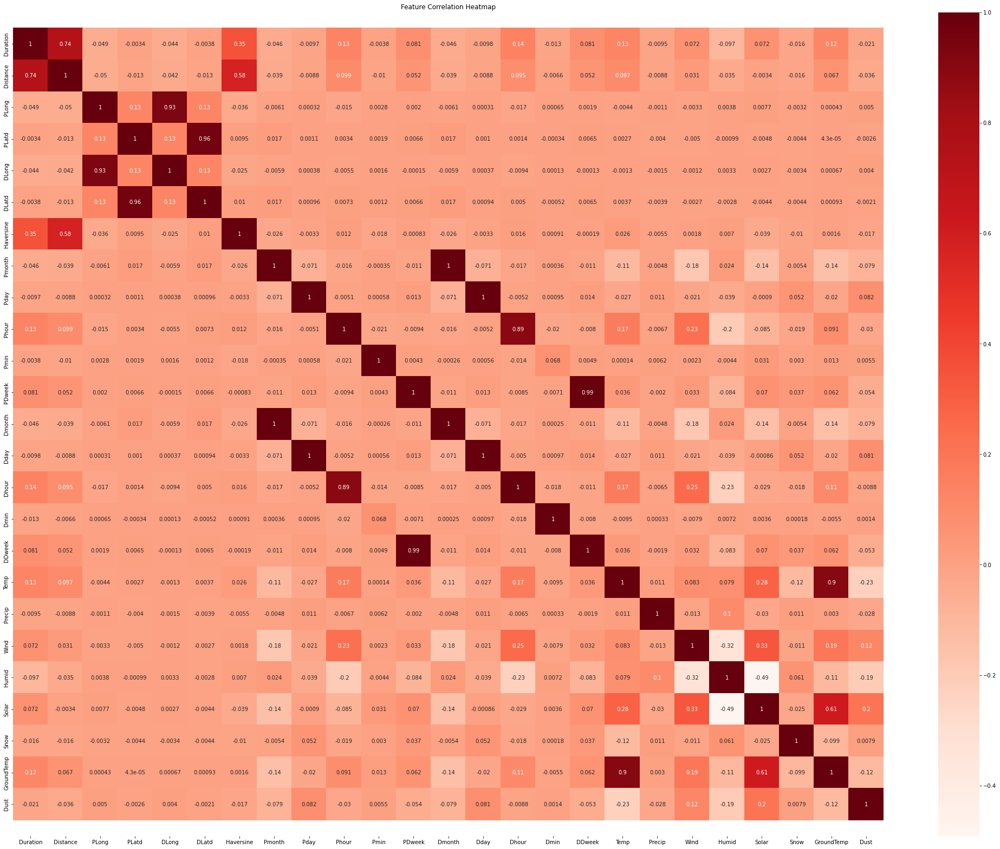

In [ ]:
corr = df_drop.corr()

plt.figure(figsize=(36,28))
sns.heatmap(corr, annot=True, cmap='Reds')
b, t = plt.ylim()
plt.ylim(b+0.5, t-0.5)
plt.title("Feature Correlation Heatmap")
plt.show()

## Random Sampling

In [ ]:
sample_dataset = df.sample(frac=0.01, replace=True, random_state=1)

In [ ]:
sample_dataset

,Duration,Distance,PLong,PLatd,DLong,DLatd,Haversine,Pmonth,Pday,Phour,...,Dmin,DDweek,Temp,Precip,Wind,Humid,Solar,Snow,GroundTemp,Dust
4686059,4,870,37.526989,126.932098,37.528816,126.924530,0.697612,8,8,8,...,34,2,28.6,0.0,1.6,80.0,0.49,0.0,29.0,27.0
6762380,42,5910,37.535999,127.147697,37.514240,127.123070,3.251248,9,29,19,...,31,5,22.5,0.0,0.4,43.0,0.00,0.0,19.4,24.0
491263,31,2740,37.550007,126.914825,37.534718,126.900002,2.144340,3,14,21,...,53,2,16.8,0.0,2.0,67.0,0.00,0.0,12.4,21.0
6662859,41,7750,37.612774,127.006531,37.638805,127.028358,3.474671,9,28,2,...,16,4,16.0,0.0,1.5,56.0,0.00,0.0,14.2,5.0
9554767,8,1280,37.519314,126.933167,37.526066,126.925537,1.008200,12,27,7,...,41,3,-11.2,0.0,2.9,22.0,0.00,0.0,-7.5,22.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1766079,4,1070,37.548496,127.074760,37.556862,127.079140,1.007207,5,13,23,...,33,6,13.0,0.0,1.3,89.0,0.00,0.0,11.7,41.0
7985987,8,1120,37.537010,127.082245,37.545231,127.084732,0.940066,10,25,18,...,2,3,17.3,0.0,1.3,39.0,0.03,0.0,14.1,40.0
4789579,17,2710,37.518970,126.869965,37.534389,126.869598,1.714822,8,11,12,...,35,5,33.2,0.0,2.3,50.0,2.84,0.0,54.0,6.0
6914336,28,3410,37.577202,126.902351,37.547691,126.919983,3.630902,10,2,18,...,4,1,19.2,0.0,2.2,48.0,0.28,0.0,18.9,27.0


## Split Train and Test datasets

In [ ]:
X = sample_dataset.drop(['Distance', 'Haversine'], axis=1)
y = sample_dataset["Distance"]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=2)

In [ ]:
sc = StandardScaler()

X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

## Linear Regression Model with 0.01 fraction random sampling

In [ ]:
# Linear Regression
lr = LinearRegression()
# Lasso Regression
lasso = Lasso()
# Ridge Regression
ridge = Ridge()

# Fitting models on Training data 
lr.fit(X_train, y_train)
lasso.fit(X_train, y_train)
ridge.fit(X_train, y_train)

# Making predictions on Test data
y_pred_lr = lr.predict(X_test)
y_pred_lasso = lasso.predict(X_test)
y_pred_ridge = ridge.predict(X_test)

In [ ]:
lr_rmse = np.sqrt(mean_squared_error(y_test, y_pred_lr))
lr_r2 = r2_score(y_test, y_pred_lr)
lasso_rmse = np.sqrt(mean_squared_error(y_test, y_pred_lasso))
lasso_r2 = r2_score(y_test, y_pred_lasso)
ridge_rmse = np.sqrt(mean_squared_error(y_test, y_pred_ridge))
ridge_r2 = r2_score(y_test, y_pred_ridge)

In [ ]:
print("Model\t\t\t RMSE \t\t\t MSE \t\t MAE \t\t\t R2")
print("""LinearRegression \t {:.2f} \t\t {:.2f} \t{:.2f} \t\t{:.2f}""".format(
            np.sqrt(mean_squared_error(y_test, y_pred_lr)),mean_squared_error(y_test, y_pred_lr),
            mean_absolute_error(y_test, y_pred_lr), r2_score(y_test, y_pred_lr)))
print("""LassoRegression \t {:.2f} \t\t {:.2f} \t{:.2f} \t\t{:.2f}""".format(
            np.sqrt(mean_squared_error(y_test, y_pred_lasso)),mean_squared_error(y_test, y_pred_lasso),
            mean_absolute_error(y_test, y_pred_lasso), r2_score(y_test, y_pred_lasso)))
print("""RidgeRegression \t {:.2f} \t\t {:.2f} \t{:.2f} \t\t{:.2f}""".format(
            np.sqrt(mean_squared_error(y_test, y_pred_ridge)),mean_squared_error(y_test, y_pred_ridge),
            mean_absolute_error(y_test, y_pred_ridge), r2_score(y_test, y_pred_ridge)))

Model			 RMSE 			 MSE 		 MAE 			 R2
LinearRegression 	 2692.36 		 7248792.42 	1452.57 		0.56
LassoRegression 	 2692.38 		 7248903.76 	1452.33 		0.56
RidgeRegression 	 2692.35 		 7248756.55 	1452.58 		0.56


## MLP Regressor Model With Dataset's %1 to Predict Distance

In [ ]:
regr = MLPRegressor(random_state=1, max_iter=50).fit(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


In [ ]:
y_pred_regr = regr.predict(X_test)

In [ ]:
#Evaluation metrics for Decision Tree on test data
MSE = mean_squared_error((y_test),(y_pred_regr))
print("MSE :",MSE)

RMSE = np.sqrt(MSE)
print('RMSE :',RMSE)

mlp_r2 = r2_score(y_test,y_pred_regr)
print('R2:',mlp_r2)
print("Adjusted R2 :",1-(1-r2_score(y_test, y_pred_regr))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

MSE : 7124513.092320637
RMSE : 2669.1783552847564
R2: 0.5689749898448311
Adjusted R2 : 0.5684580924448849


In [ ]:
## cok uzun surdugu icin random sampling yapilacak.
## bununla birlikte bagging ve boosting gosterilebilir

## DecisionTree Regressor with Dataset's %1 to Predict Distance

In [ ]:
dt = DecisionTreeRegressor()

dt_model = dt.fit(X_train, y_train)

y_pred_dt = dt.predict(X_test)

In [ ]:
#Evaluation metrics for Decision Tree on test data
MSE = mean_squared_error((y_test),(y_pred_dt))
print("MSE :",MSE)

RMSE = np.sqrt(MSE)
print('RMSE :',RMSE)

dt_r2 = r2_score(y_test,y_pred_dt)
print('R2:',dt_r2)
print("Adjusted R2 :",1-(1-r2_score(y_test, y_pred_dt))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

MSE : 13314728.432744883
RMSE : 3648.935246444486
R2: 0.5689749898448311
Adjusted R2 : 0.19350793071902694


Text(0.5, 0, 'Variable Severity Levels')

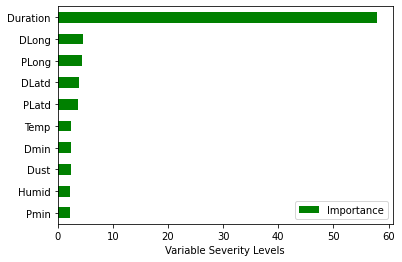

In [ ]:
Importance = pd.DataFrame({"Importance":dt_model.feature_importances_*100}, index=X.columns)
Importance.sort_values(by='Importance', axis=0, ascending=True).iloc[-10:,:].plot(kind='barh', color='green')
plt.xlabel("Variable Severity Levels")

## XGBOOSTER with Dataset's %1 to Predict Distance

In [ ]:
xgb = xg.XGBRegressor(learning_rate=0.2, max_depth=3, n_estimators=200, n_jobs=1, objective='reg:linear')
xgb_model = xgb.fit(X_train, y_train)
y_pred_xgb = xgb_model.predict(X_test)

[13:25:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


In [ ]:
#Evaluation metrics for XGBooster on test data
MSE = mean_squared_error((y_test),(y_pred_xgb))
print("MSE :",MSE)

RMSE = np.sqrt(MSE)
print('RMSE :',RMSE)

xgb_r2 = r2_score(y_test,y_pred_xgb)
print('R2:',xgb_r2)
print("Adjusted R2 :",1-(1-r2_score(y_test, y_pred_xgb))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

MSE : 5200124.045924945
RMSE : 2280.3780489043797
R2: 0.5689749898448311
Adjusted R2 : 0.6850210784621182


## SVM Regressor 

In [ ]:
## due to takes too much time to execute  with random sampling fraction 0.01, used here random samplig with 0,003 fraction

In [ ]:
svm_dataset = df.sample(frac=0.003, replace=True, random_state=1)

In [ ]:
X = svm_dataset.drop(['Distance', 'Haversine'], axis=1)
y = svm_dataset["Distance"]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=2)

In [ ]:
svr_model = SVR(kernel="linear").fit(X_train, y_train)

In [ ]:
y_pred_svr = svr_model.predict(X_test)

In [ ]:
#Evaluation metrics for SVM Regressor on test data
MSE = mean_squared_error((y_test),(y_pred_svr))
print("MSE :",MSE)

RMSE = np.sqrt(MSE)
print('RMSE :',RMSE)

svm_r2 = r2_score(y_test,y_pred_svr)
print('R2:',svm_r2)
print("Adjusted R2 :",1-(1-r2_score(y_test, y_pred_svr))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

MSE : 7573214.179399862
RMSE : 2751.9473431371944
R2: 0.5689749898448311
Adjusted R2 : 0.5411471696016404


## Models Comparasion

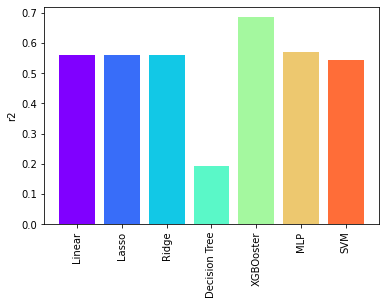

In [ ]:
colors = cm.rainbow(np.linspace(0,1,8))

height = [lr_r2, lasso_r2, ridge_r2, dt_r2, xgb_r2, mlp_r2, svm_r2,]
bars = ('Linear', 'Lasso', 'Ridge', 'Decision Tree', 'XGBOoster','MLP', 'SVM')

plt.bar(bars, height, color=colors)
plt.xticks(range(len(bars)), bars, rotation='vertical')
plt.ylabel('r2')
plt.show()

## Random samling with 0.003 fraction

In [ ]:
sample_dataset_0003 = df.sample(frac=0.003, replace=True, random_state=1)
sample_dataset_0003.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 28803 entries, 4686059 to 8575858
Data columns (total 25 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Duration    28803 non-null  int64  
 1   Distance    28803 non-null  int64  
 2   PLong       28803 non-null  float64
 3   PLatd       28803 non-null  float64
 4   DLong       28803 non-null  float64
 5   DLatd       28803 non-null  float64
 6   Haversine   28803 non-null  float64
 7   Pmonth      28803 non-null  int64  
 8   Pday        28803 non-null  int64  
 9   Phour       28803 non-null  int64  
 10  Pmin        28803 non-null  int64  
 11  PDweek      28803 non-null  int64  
 12  Dmonth      28803 non-null  int64  
 13  Dday        28803 non-null  int64  
 14  Dhour       28803 non-null  int64  
 15  Dmin        28803 non-null  int64  
 16  DDweek      28803 non-null  int64  
 17  Temp        28803 non-null  float64
 18  Precip      28803 non-null  float64
 19  Wind        28803

In [ ]:
X = sample_dataset_0003.drop(['Distance'], axis=1)
y = sample_dataset_0003["Distance"]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=2)

In [ ]:
sc = StandardScaler()

X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

## KMeans Clustering

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
kmeans = KMeans(n_clusters=4)
kmeans.fit(X)
y_kmeans = kmeans.predict(X)

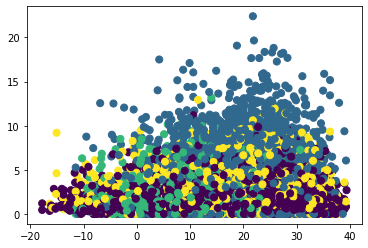

In [ ]:
plt.scatter(X["Temp"], X["Haversine"], c=y_kmeans, s=50, cmap='viridis')

#centers = kmeans.cluster_centers_
#plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5);

## DBScan Clustering

In [ ]:
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=3, min_samples=2).fit(X)

In [ ]:
labels = dbscan.labels_

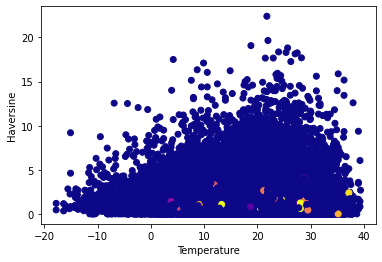

In [ ]:
plt.scatter(X["Temp"], X["Haversine"], c = labels, cmap= "plasma") # plotting the clusters
plt.xlabel("Temperature") # X-axis label
plt.ylabel("Haversine") # Y-axis label
plt.show()

## Hierarchical Clustering

In [ ]:
from sklearn.cluster import AgglomerativeClustering

hierarchical_cluster = AgglomerativeClustering(n_clusters=4, affinity='euclidean', linkage='ward')
labels = hierarchical_cluster.fit_predict(X)

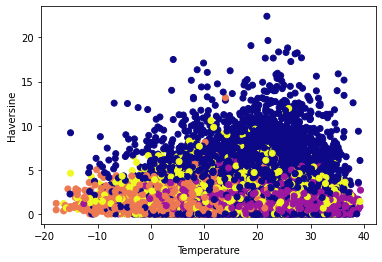

In [ ]:
plt.scatter(X["Temp"], X["Haversine"], c = labels, cmap= "plasma") # plotting the clusters
plt.xlabel("Temperature") # X-axis label
plt.ylabel("Haversine") # Y-axis label
plt.show()

## Gaussian Mixture

In [ ]:
from sklearn.mixture import GaussianMixture

gm = GaussianMixture(n_components=3, random_state=0).fit_predict(X)

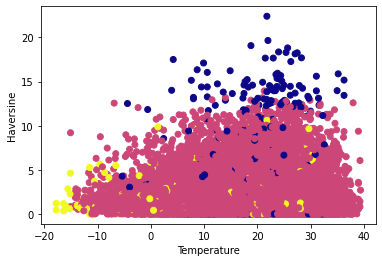

In [ ]:
plt.scatter(X["Temp"], X["Haversine"], c = gm, cmap= "plasma") # plotting the clusters
plt.xlabel("Temperature") # X-axis label
plt.ylabel("Haversine") # Y-axis label
plt.show()

#### gaussian mixture with n_components = 2

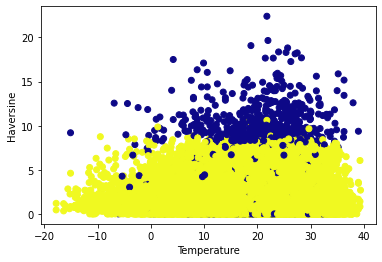

In [ ]:
gm = GaussianMixture(n_components=2, random_state=0).fit_predict(X)
plt.scatter(X["Temp"], X["Haversine"], c = gm, cmap= "plasma") # plotting the clusters
plt.xlabel("Temperature") # X-axis label
plt.ylabel("Haversine") # Y-axis label
plt.show()

Duration Duration


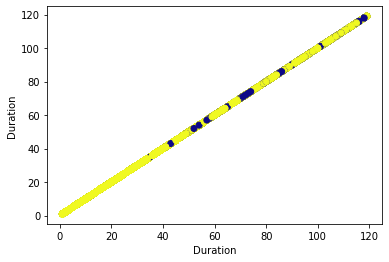

Duration PLong


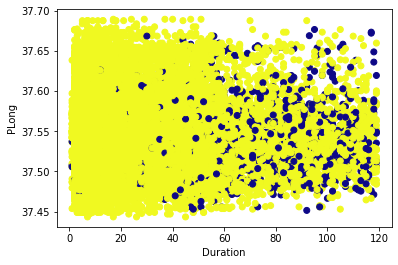

Duration PLatd


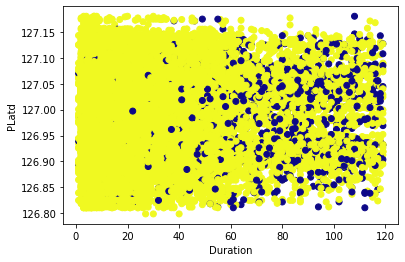

Duration DLong


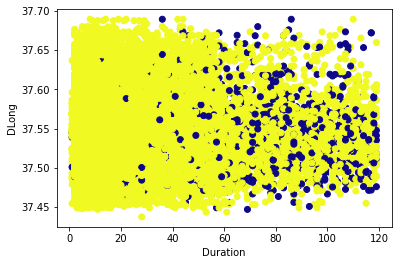

Duration DLatd


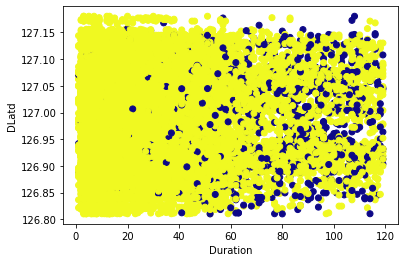

Duration Haversine


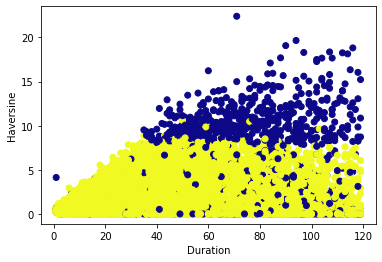

Duration Pmonth


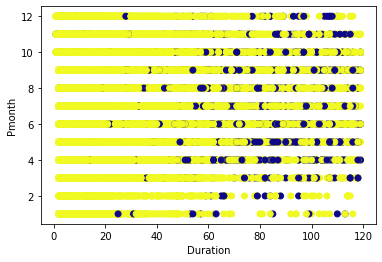

Duration Pday


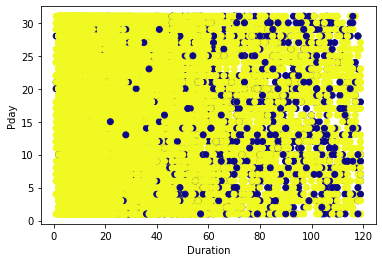

Duration Phour


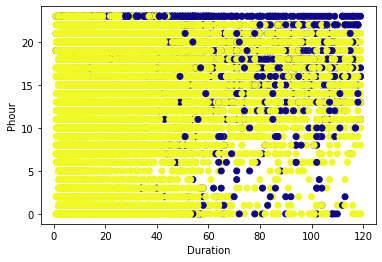

Duration Pmin


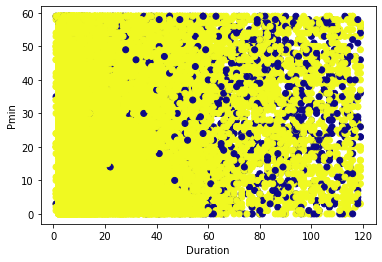

Duration PDweek


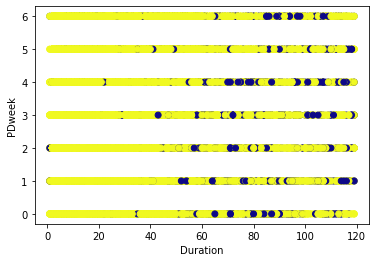

Duration Dmonth


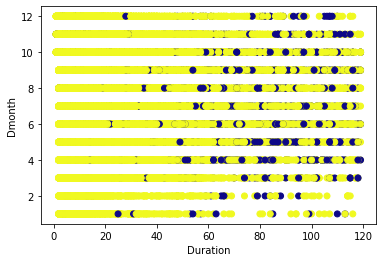

Duration Dday


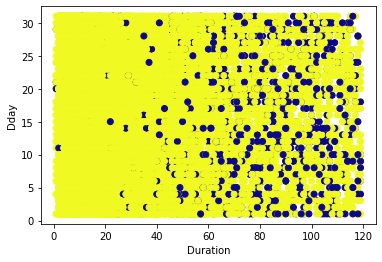

Duration Dhour


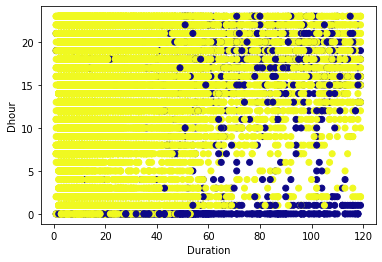

Duration Dmin


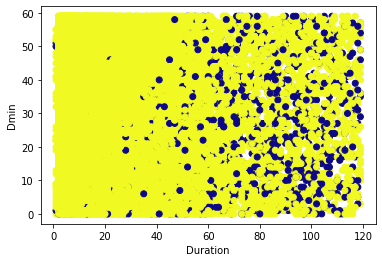

Duration DDweek


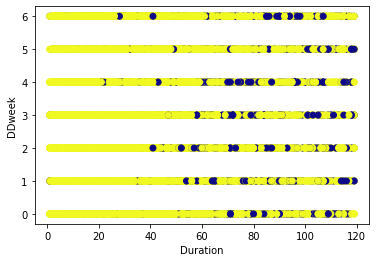

Duration Temp


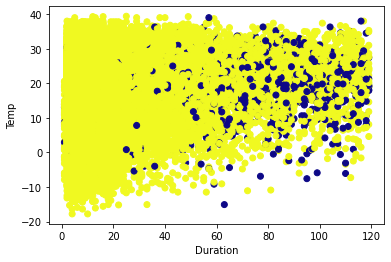

Duration Precip


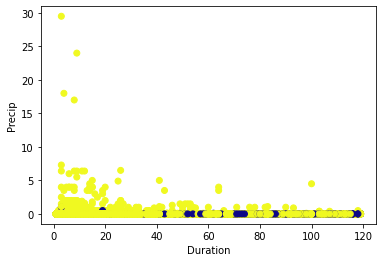

Duration Wind


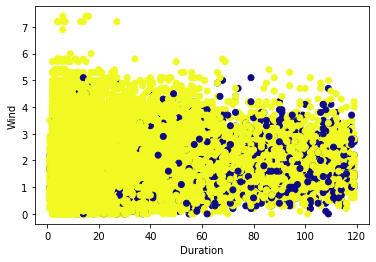

Duration Humid


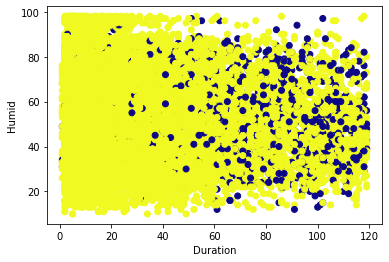

Duration Solar


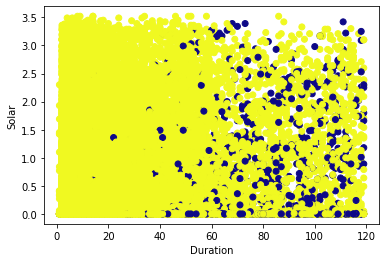

Duration Snow


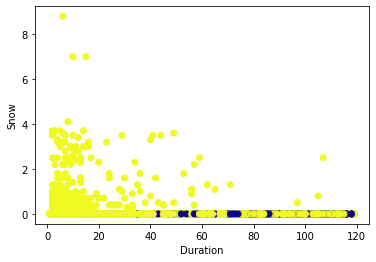

Duration GroundTemp


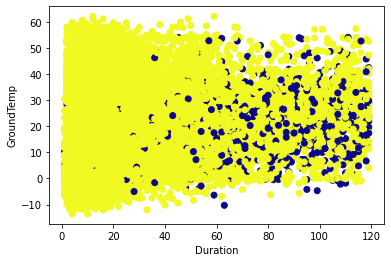

Duration Dust


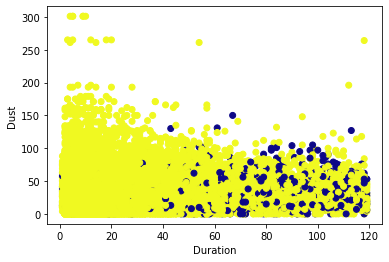

PLong Duration


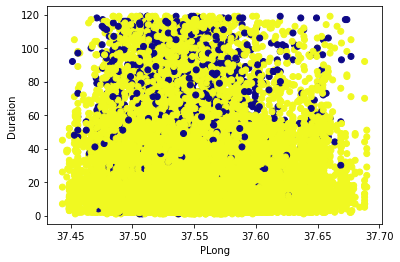

PLong PLong


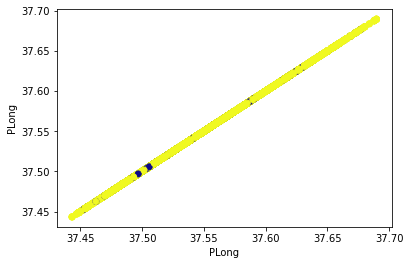

PLong PLatd


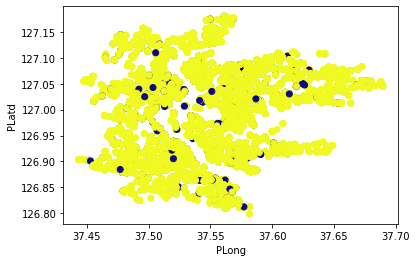

PLong DLong


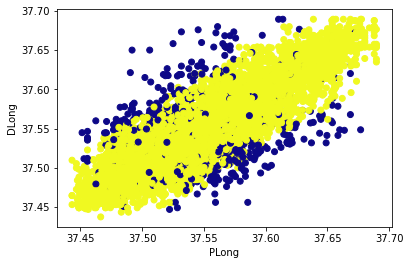

PLong DLatd


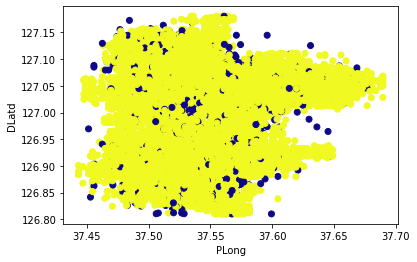

PLong Haversine


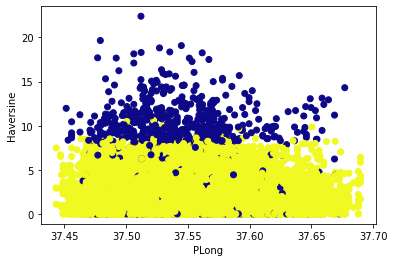

PLong Pmonth


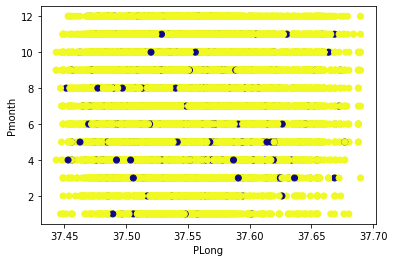

PLong Pday


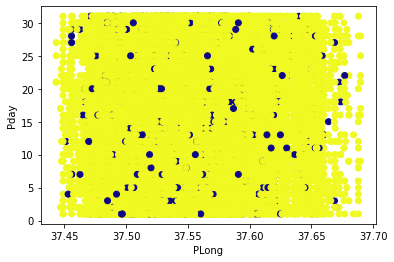

PLong Phour


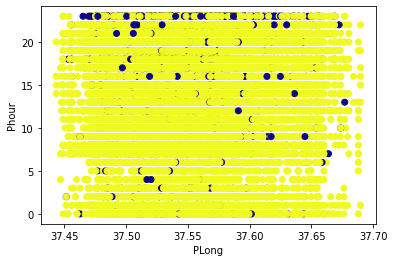

PLong Pmin


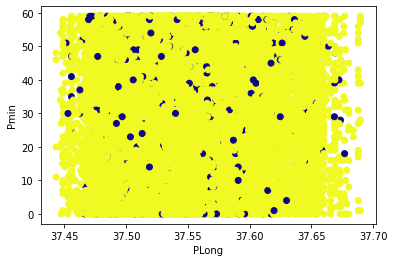

PLong PDweek


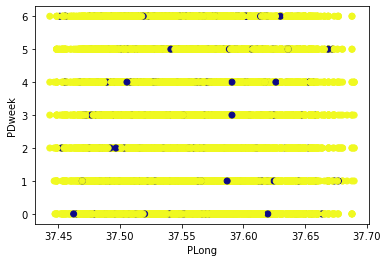

PLong Dmonth


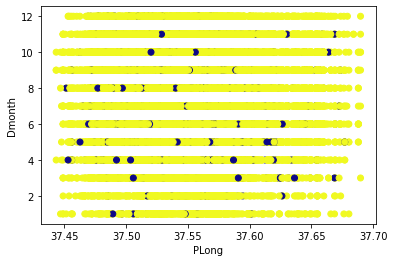

PLong Dday


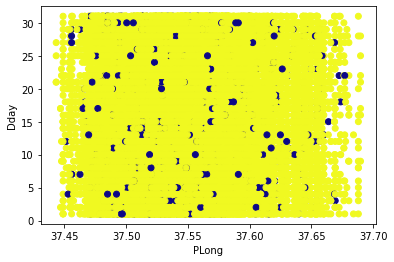

PLong Dhour


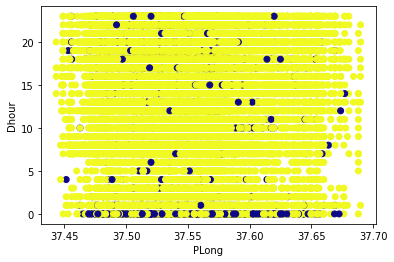

PLong Dmin


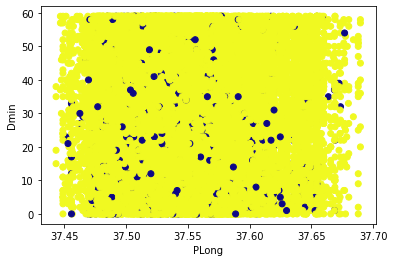

PLong DDweek


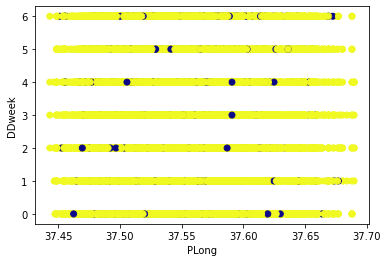

PLong Temp


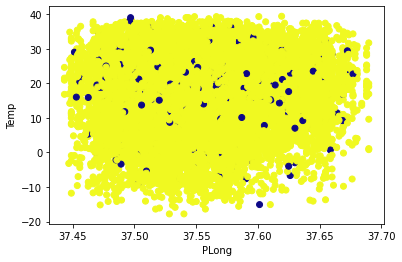

PLong Precip


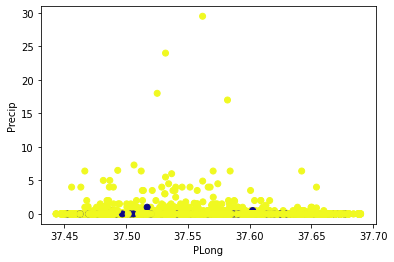

PLong Wind


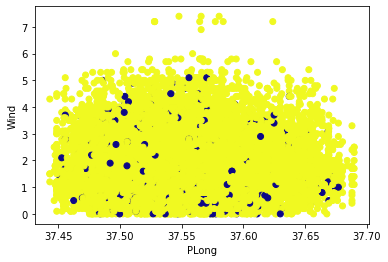

PLong Humid


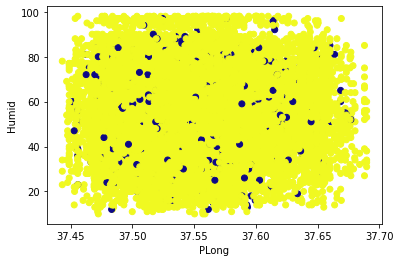

PLong Solar


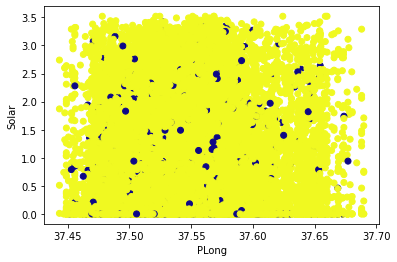

PLong Snow


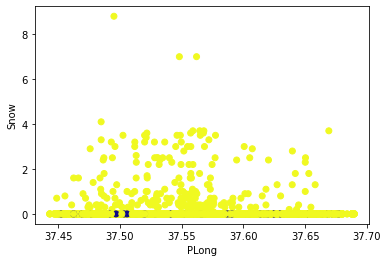

PLong GroundTemp


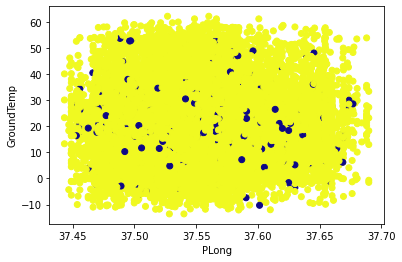

PLong Dust


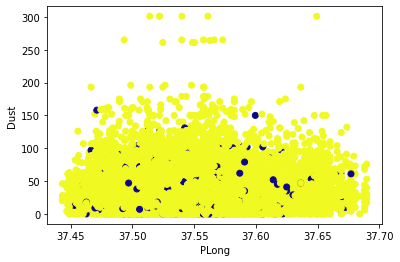

PLatd Duration


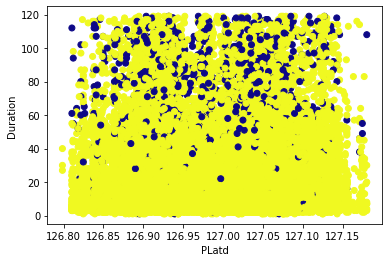

PLatd PLong


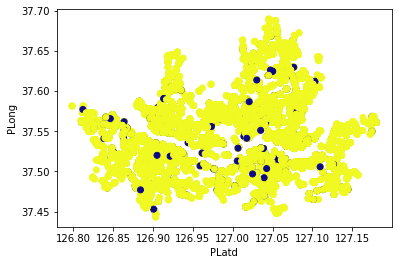

PLatd PLatd


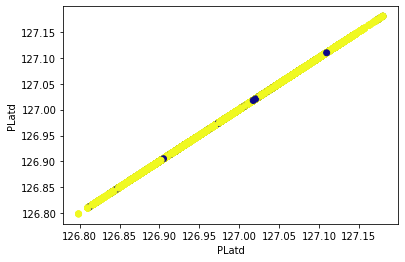

PLatd DLong


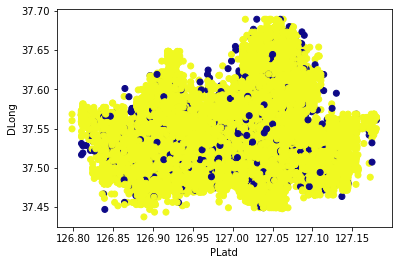

PLatd DLatd


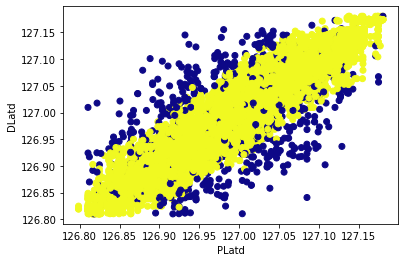

PLatd Haversine


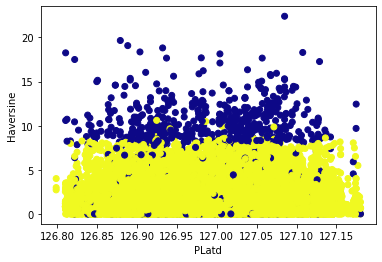

PLatd Pmonth


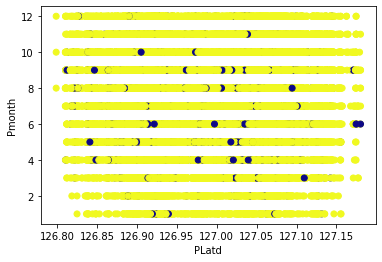

PLatd Pday


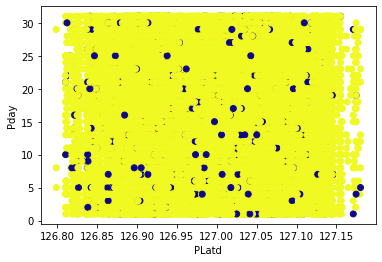

PLatd Phour


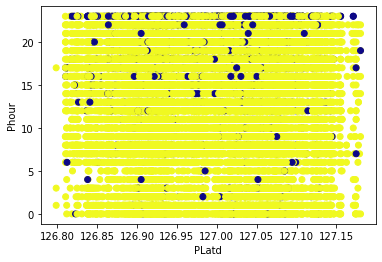

PLatd Pmin


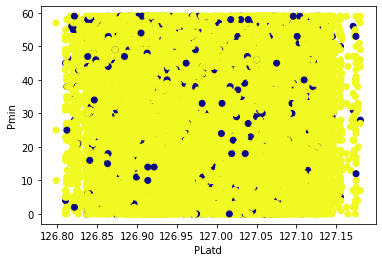

PLatd PDweek


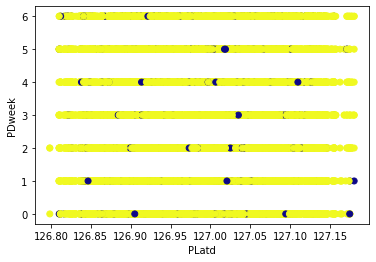

PLatd Dmonth


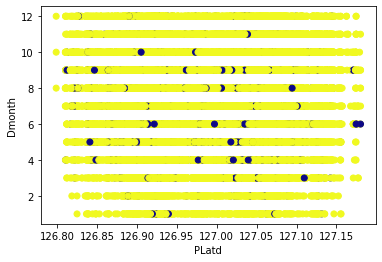

PLatd Dday


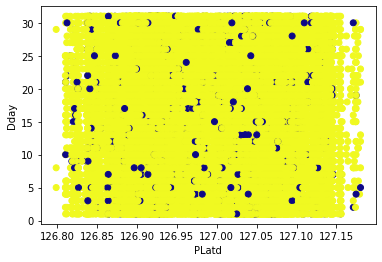

PLatd Dhour


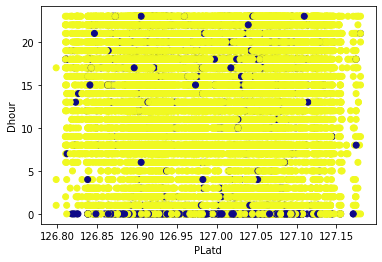

PLatd Dmin


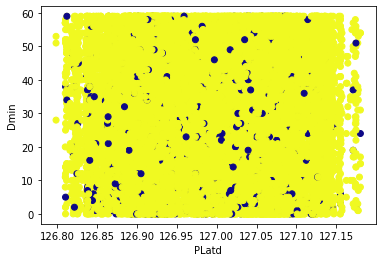

PLatd DDweek


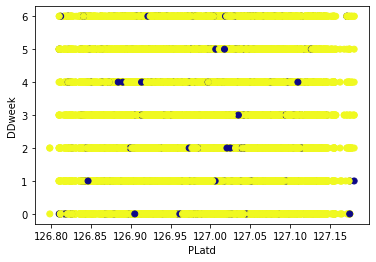

PLatd Temp


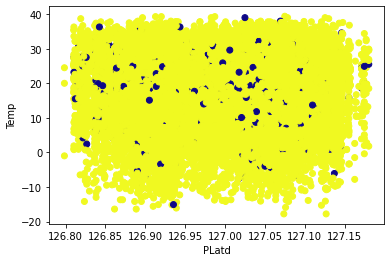

PLatd Precip


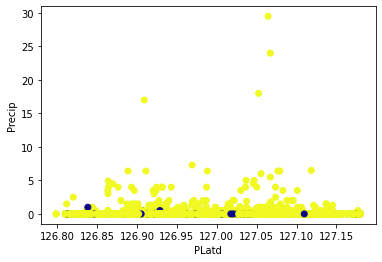

PLatd Wind


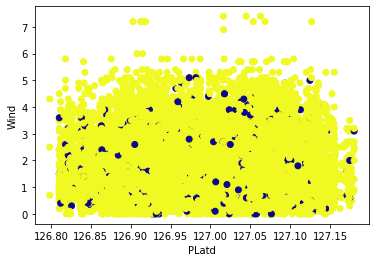

PLatd Humid


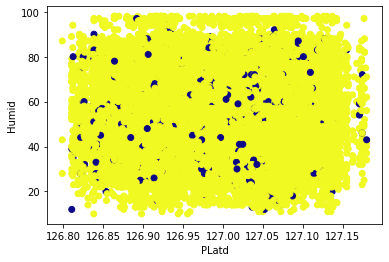

PLatd Solar


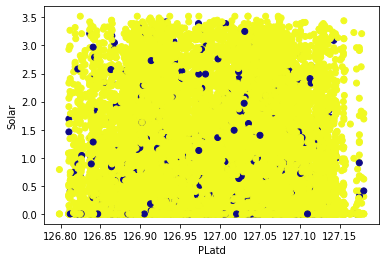

PLatd Snow


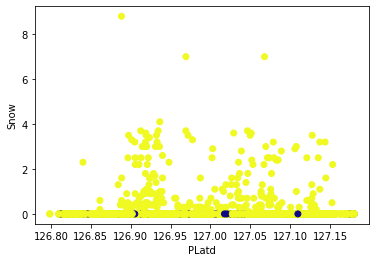

PLatd GroundTemp


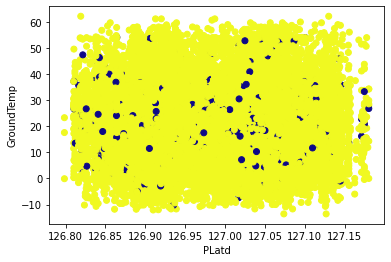

PLatd Dust


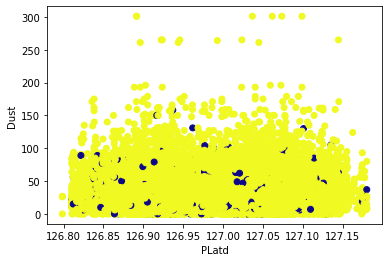

DLong Duration


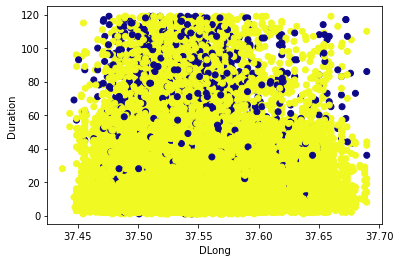

DLong PLong


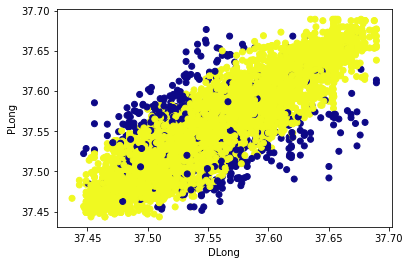

DLong PLatd


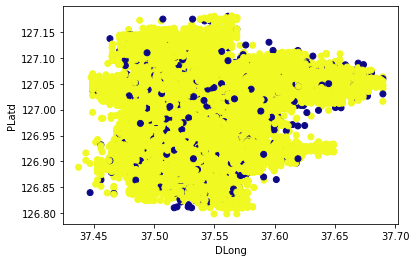

DLong DLong


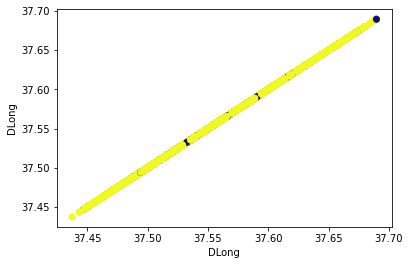

DLong DLatd


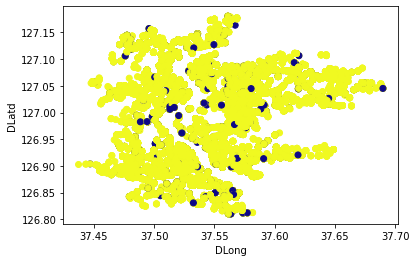

DLong Haversine


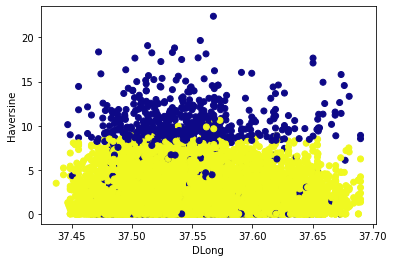

DLong Pmonth


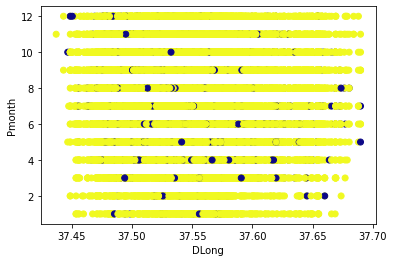

DLong Pday


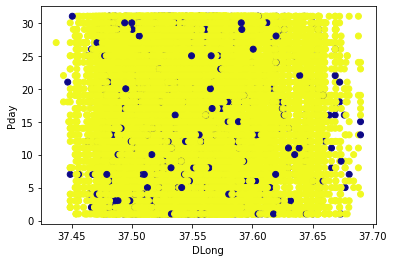

DLong Phour


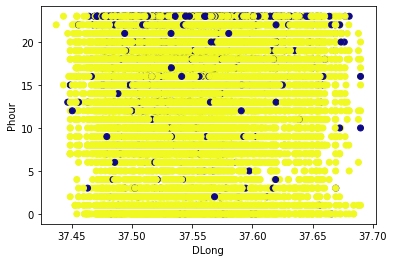

DLong Pmin


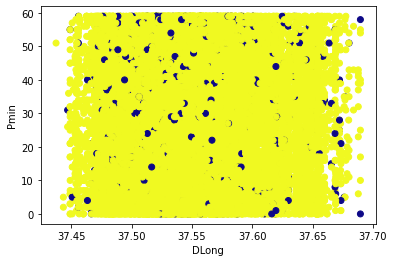

DLong PDweek


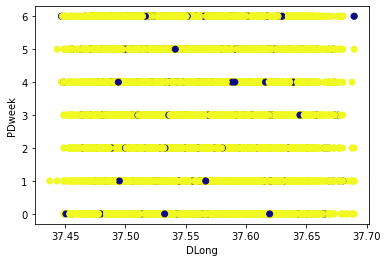

DLong Dmonth


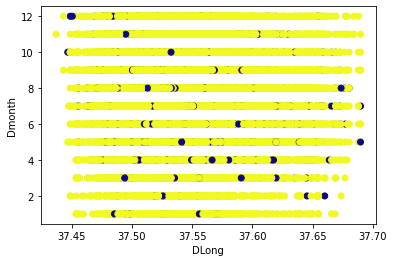

DLong Dday


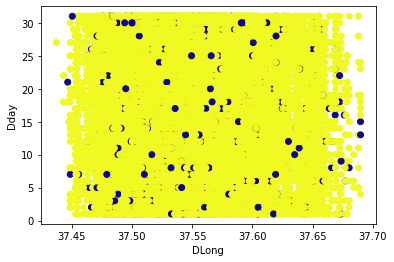

DLong Dhour


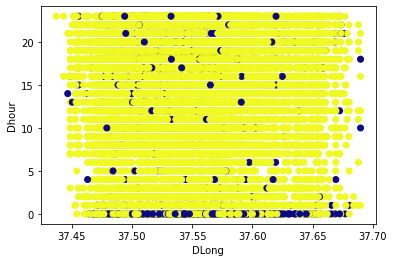

DLong Dmin


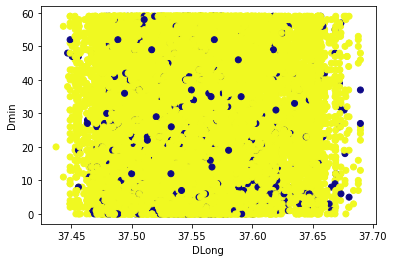

DLong DDweek


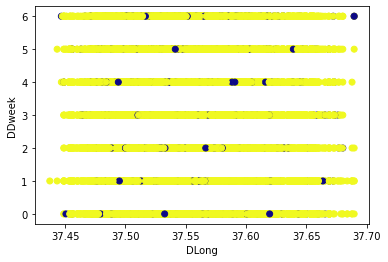

DLong Temp


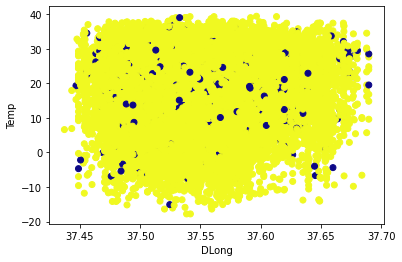

DLong Precip


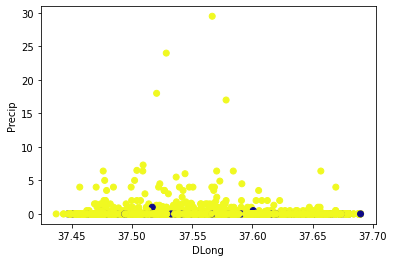

DLong Wind


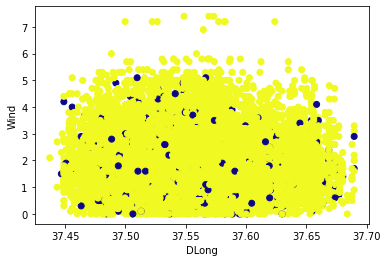

DLong Humid


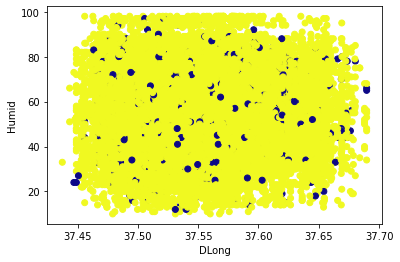

DLong Solar


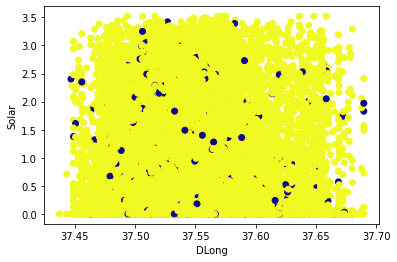

DLong Snow


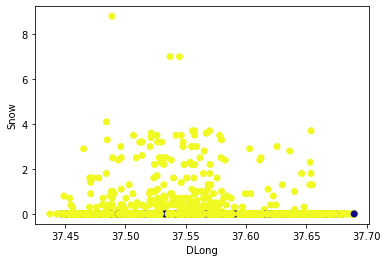

DLong GroundTemp


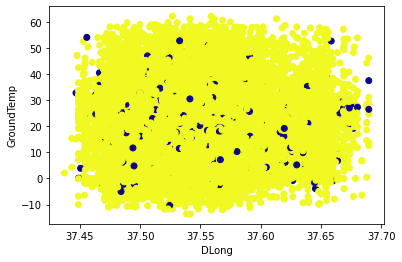

DLong Dust


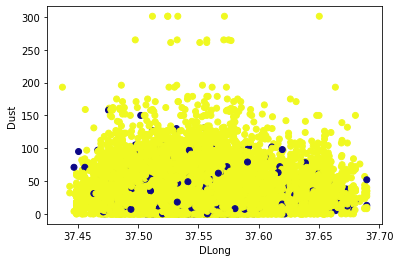

DLatd Duration


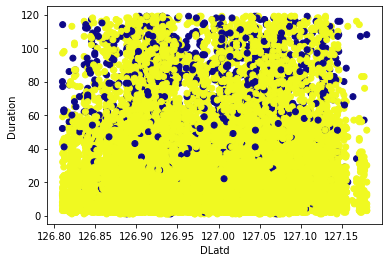

DLatd PLong


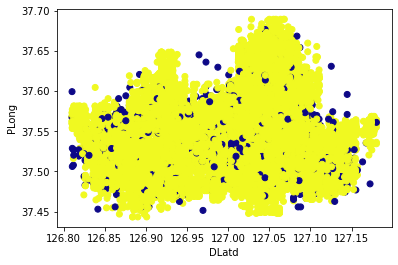

DLatd PLatd


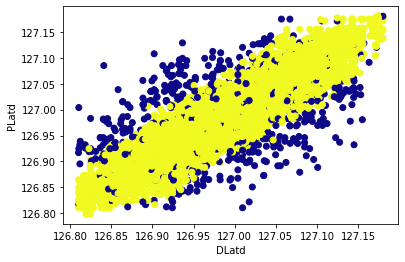

DLatd DLong


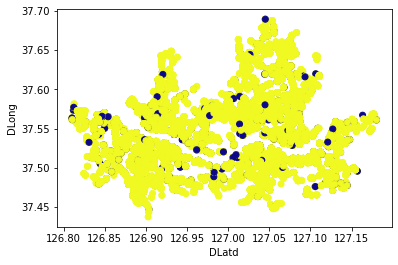

DLatd DLatd


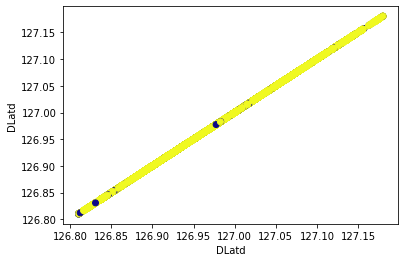

DLatd Haversine


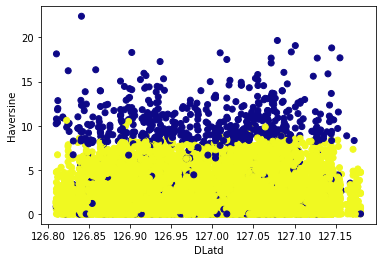

DLatd Pmonth


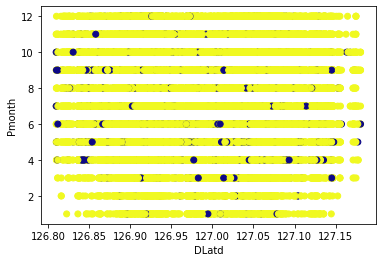

DLatd Pday


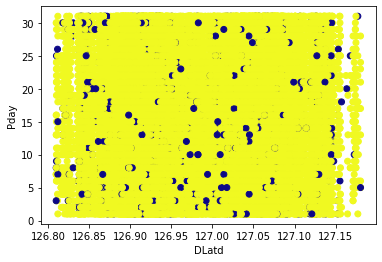

DLatd Phour


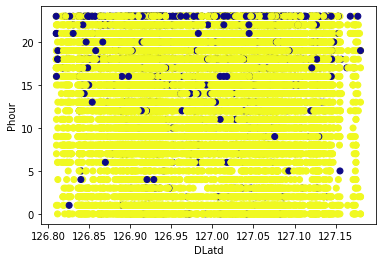

DLatd Pmin


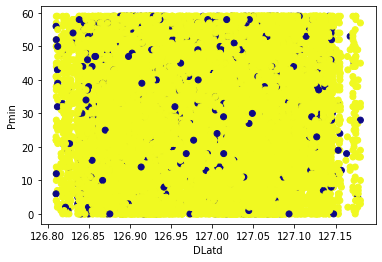

DLatd PDweek


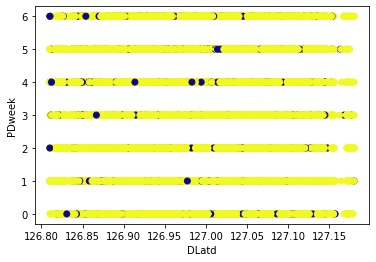

DLatd Dmonth


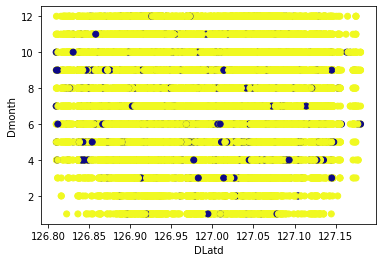

DLatd Dday


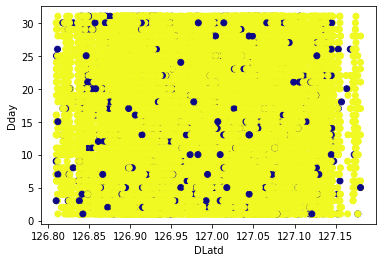

DLatd Dhour


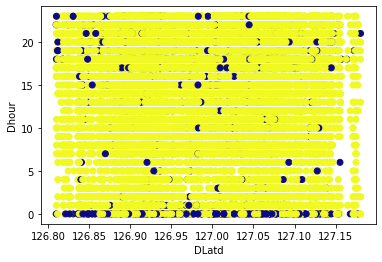

DLatd Dmin


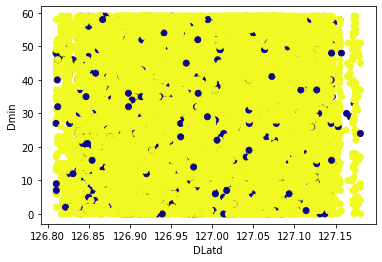

DLatd DDweek


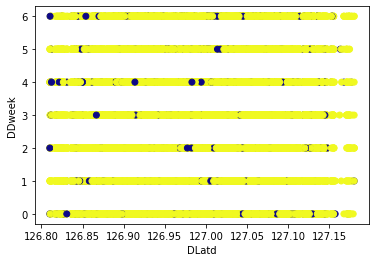

DLatd Temp


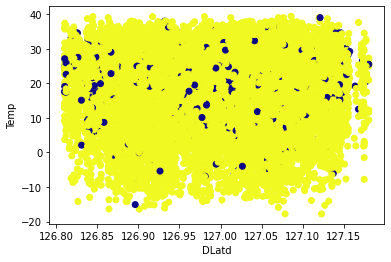

DLatd Precip


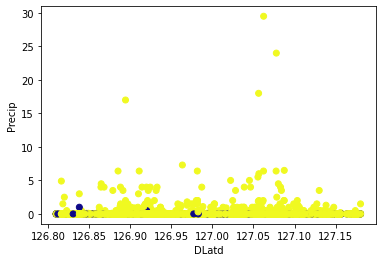

DLatd Wind


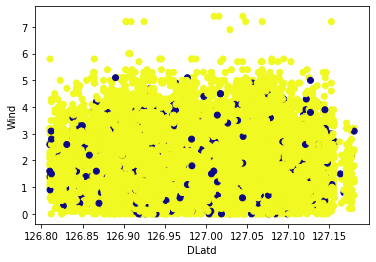

DLatd Humid


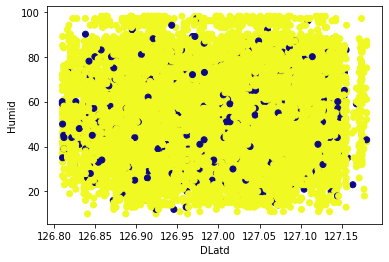

DLatd Solar


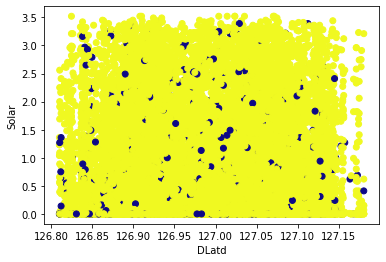

DLatd Snow


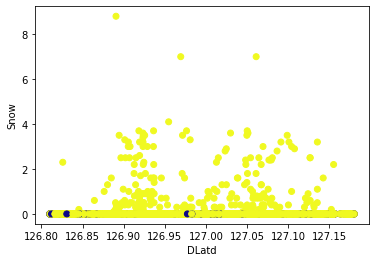

DLatd GroundTemp


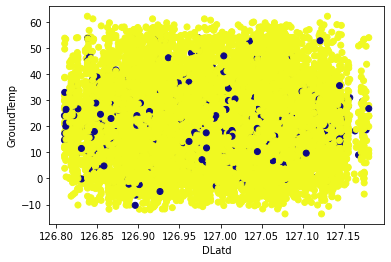

DLatd Dust


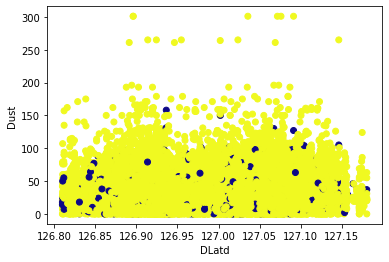

Haversine Duration


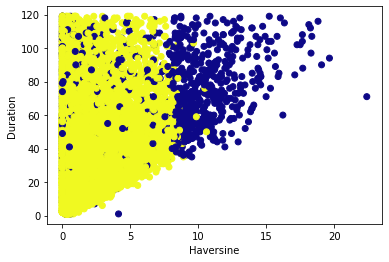

Haversine PLong


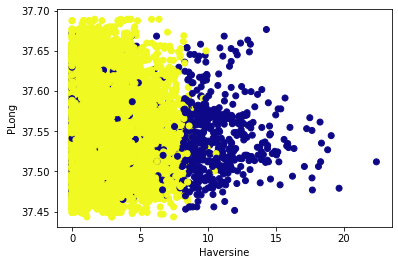

Haversine PLatd


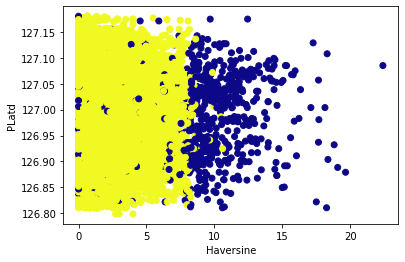

Haversine DLong


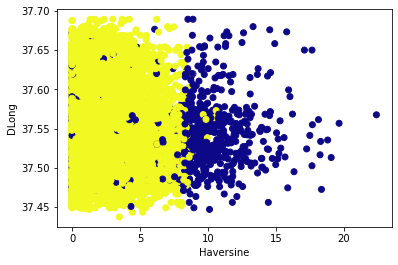

Haversine DLatd


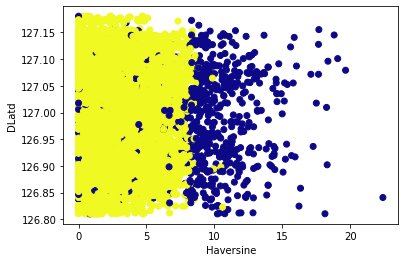

Haversine Haversine


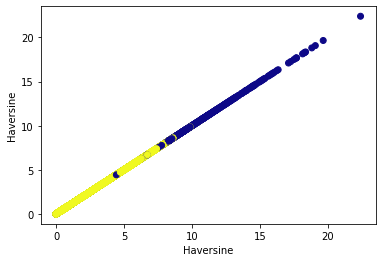

Haversine Pmonth


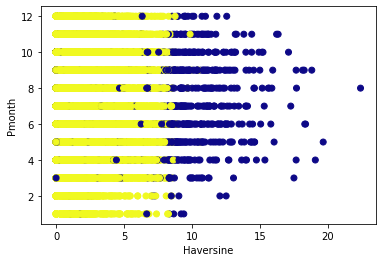

Haversine Pday


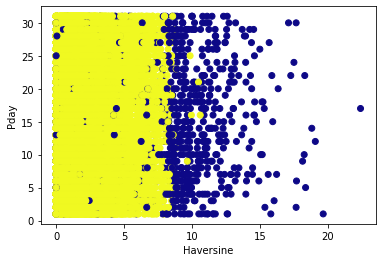

Haversine Phour


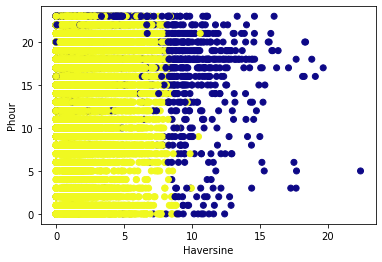

Haversine Pmin


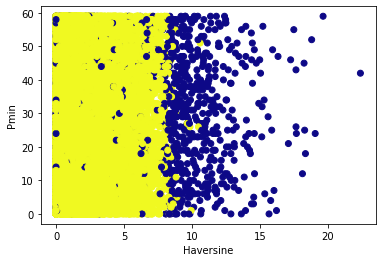

Haversine PDweek


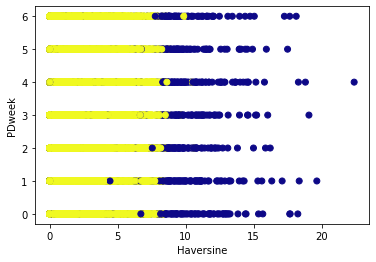

Haversine Dmonth


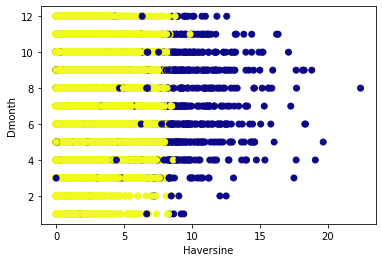

Haversine Dday


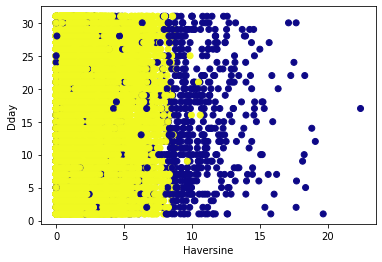

Haversine Dhour


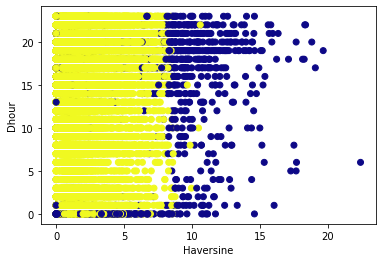

Haversine Dmin


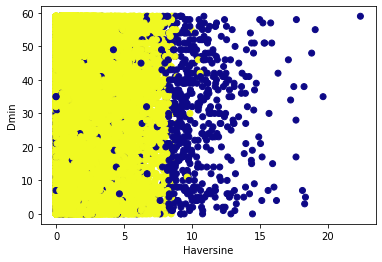

Haversine DDweek


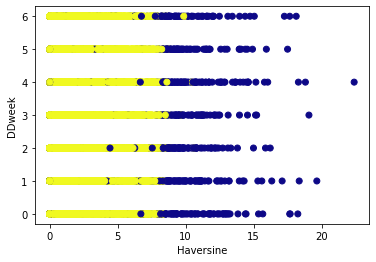

Haversine Temp


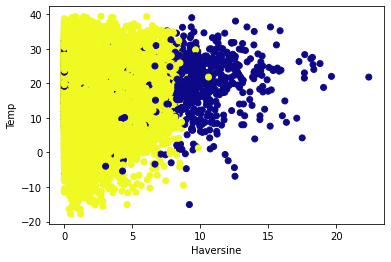

Haversine Precip


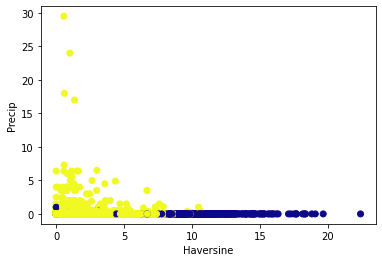

Haversine Wind


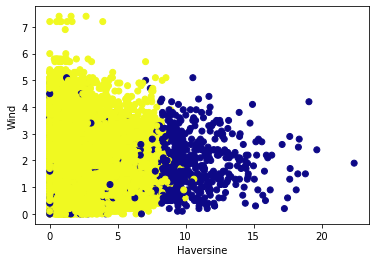

Haversine Humid


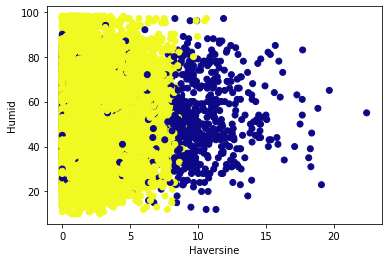

Haversine Solar


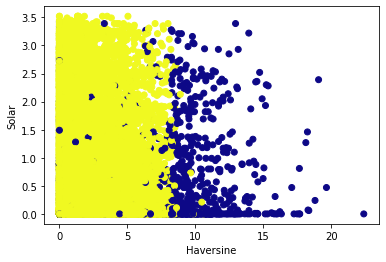

Haversine Snow


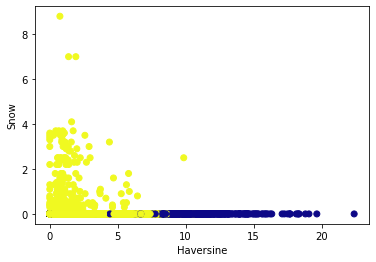

Haversine GroundTemp


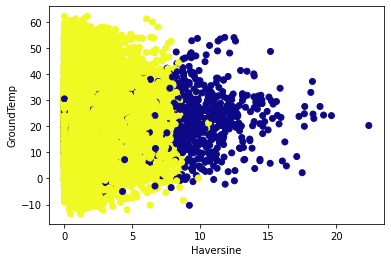

Haversine Dust


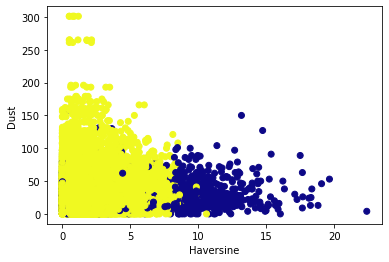

Pmonth Duration


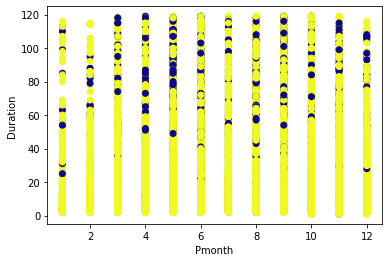

Pmonth PLong


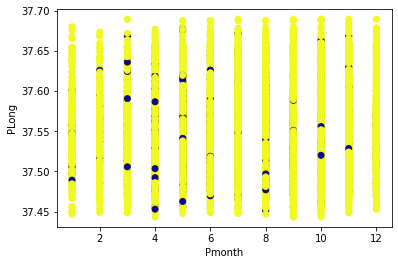

Pmonth PLatd


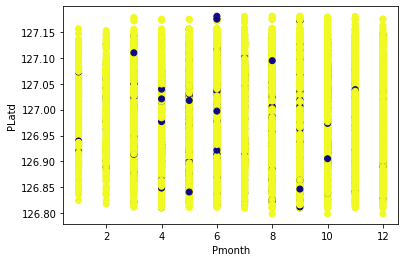

Pmonth DLong


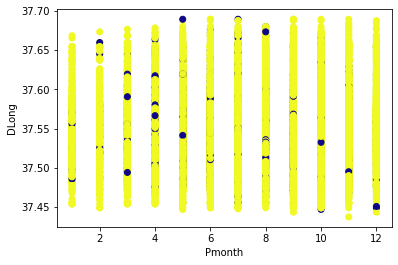

Pmonth DLatd


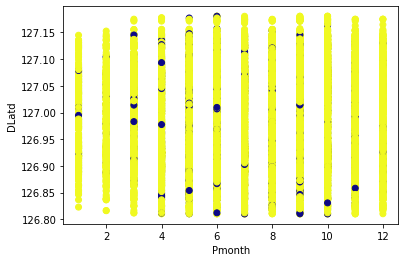

Pmonth Haversine


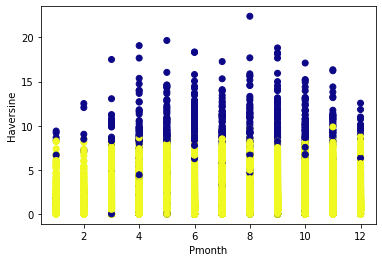

Pmonth Pmonth


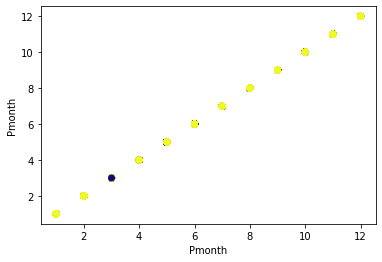

Pmonth Pday


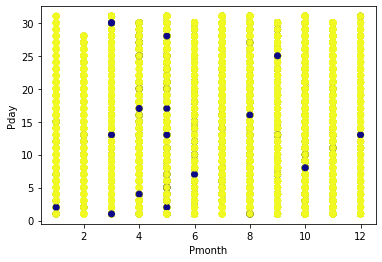

Pmonth Phour


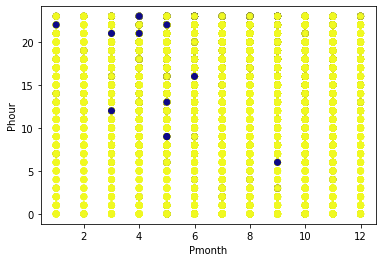

Pmonth Pmin


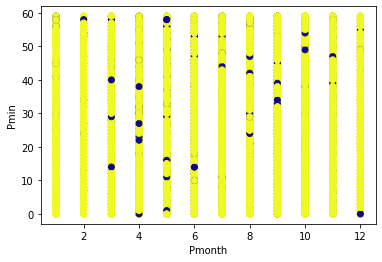

Pmonth PDweek


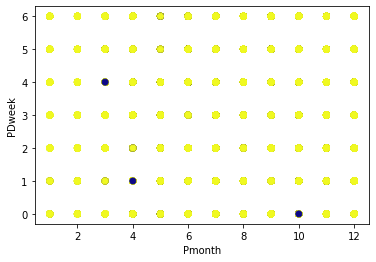

Pmonth Dmonth


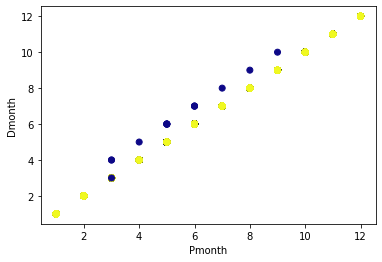

Pmonth Dday


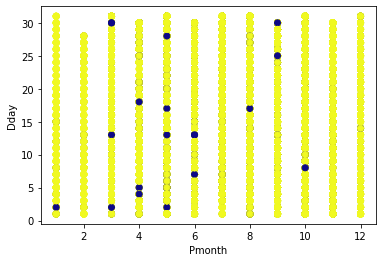

Pmonth Dhour


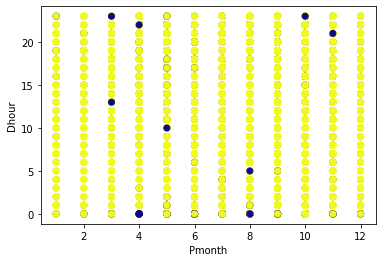

Pmonth Dmin


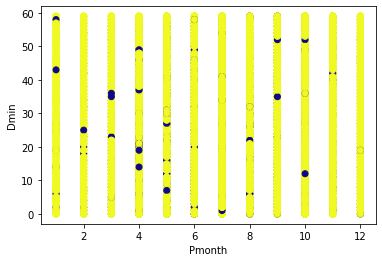

Pmonth DDweek


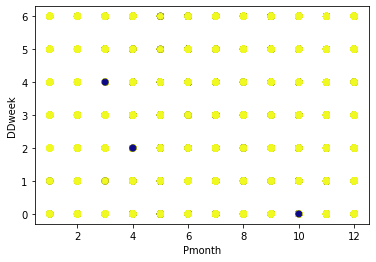

Pmonth Temp


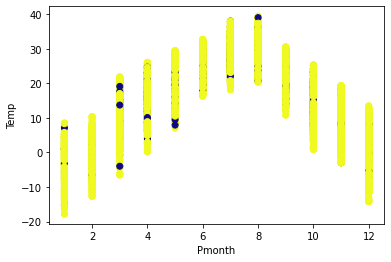

Pmonth Precip


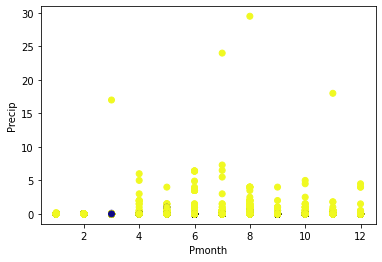

Pmonth Wind


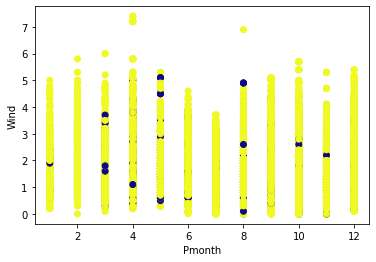

Pmonth Humid


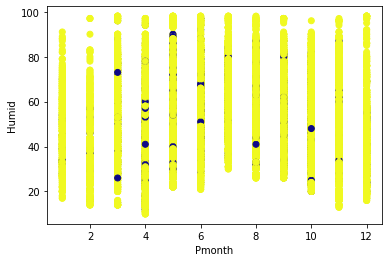

Pmonth Solar


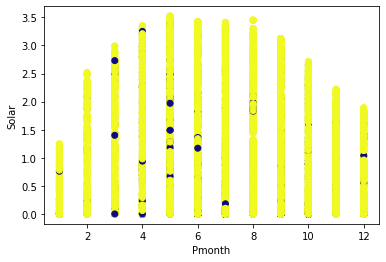

Pmonth Snow


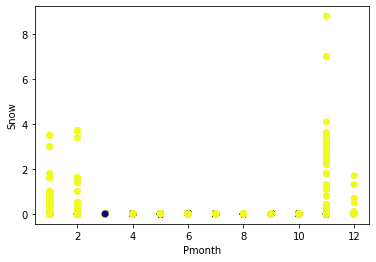

Pmonth GroundTemp


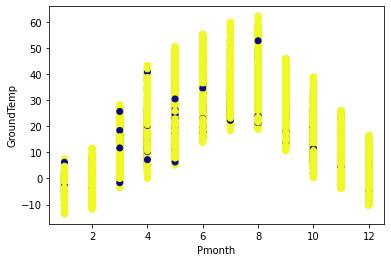

Pmonth Dust


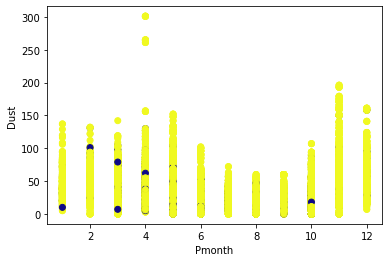

Pday Duration


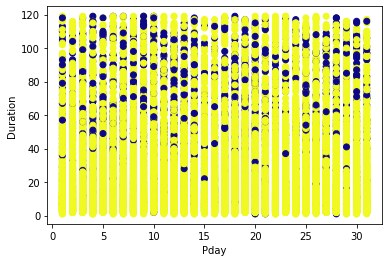

Pday PLong


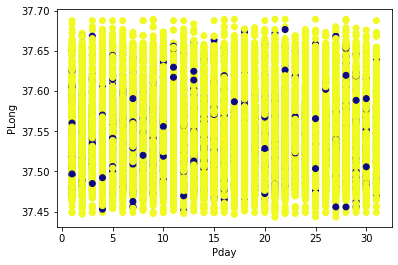

Pday PLatd


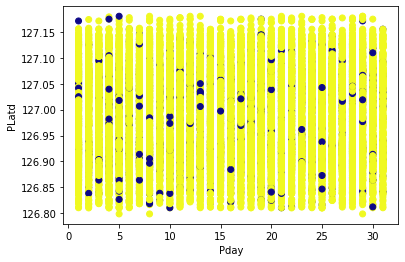

Pday DLong


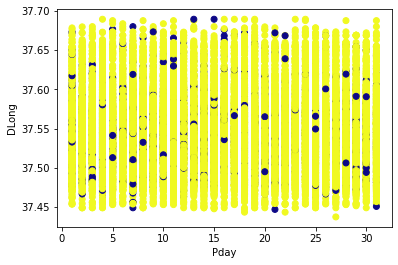

Pday DLatd


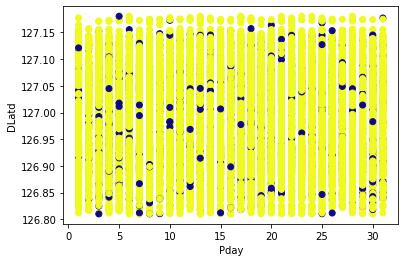

Pday Haversine


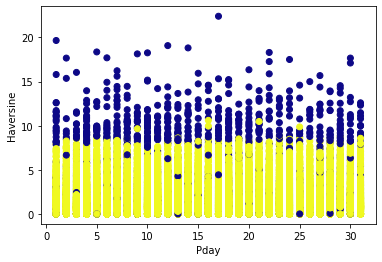

Pday Pmonth


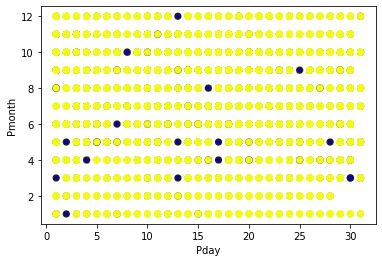

Pday Pday


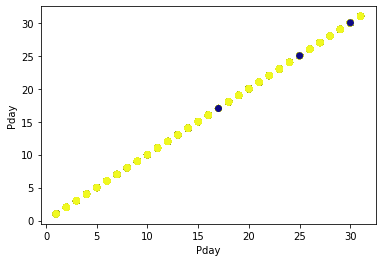

Pday Phour


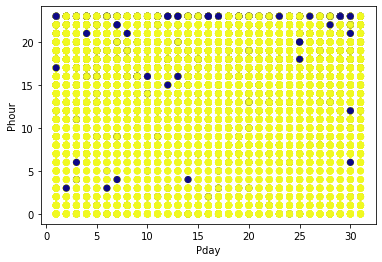

Pday Pmin


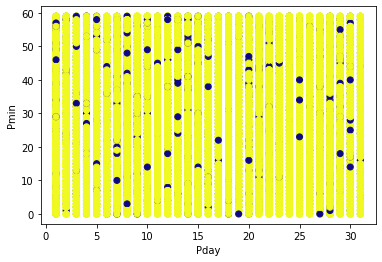

Pday PDweek


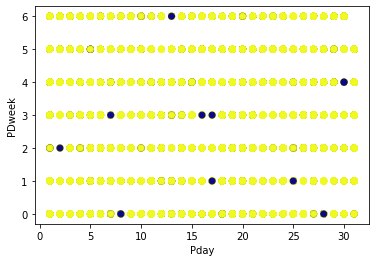

Pday Dmonth


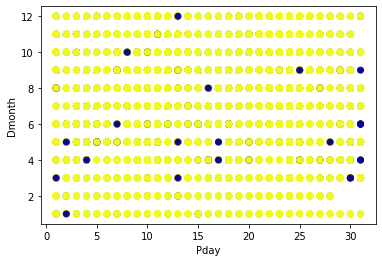

Pday Dday


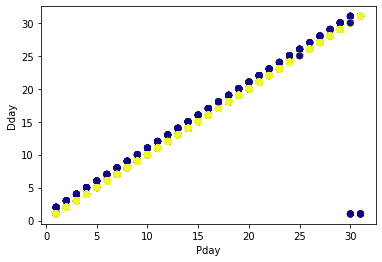

Pday Dhour


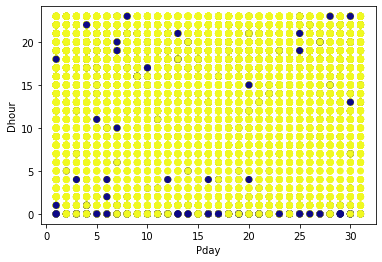

Pday Dmin


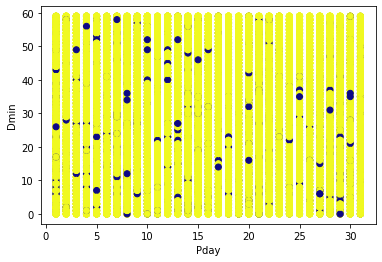

Pday DDweek


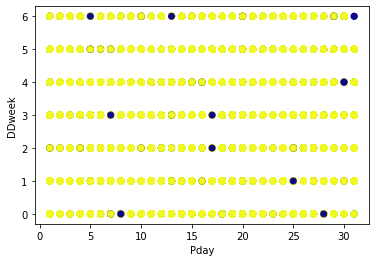

Pday Temp


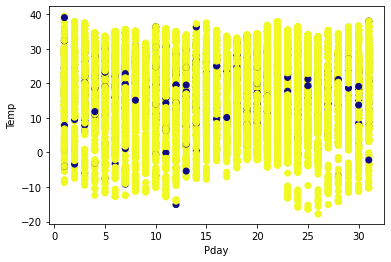

Pday Precip


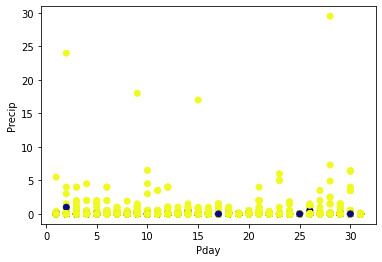

Pday Wind


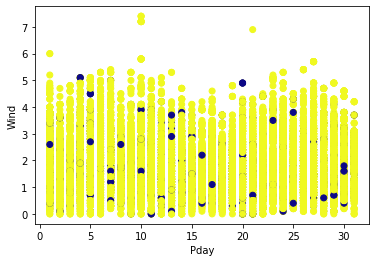

Pday Humid


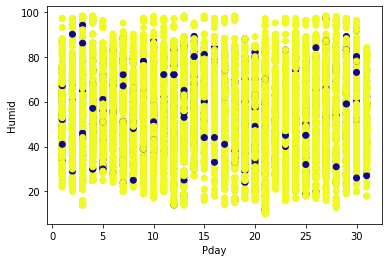

Pday Solar


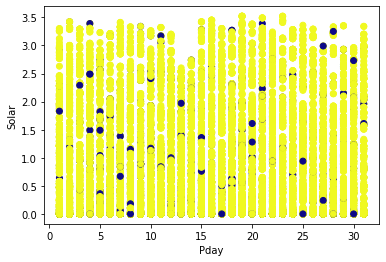

Pday Snow


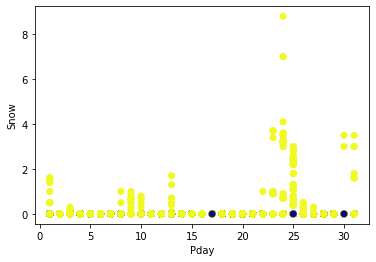

Pday GroundTemp


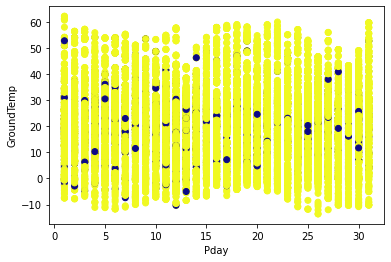

Pday Dust


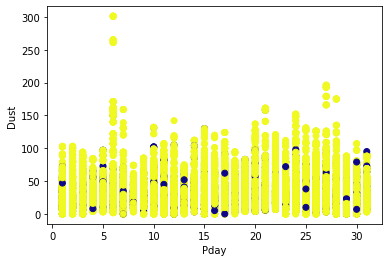

Phour Duration


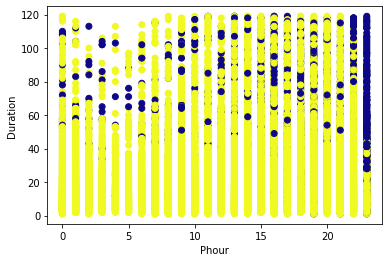

Phour PLong


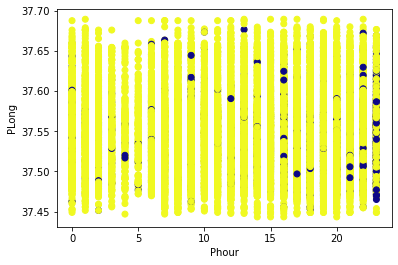

Phour PLatd


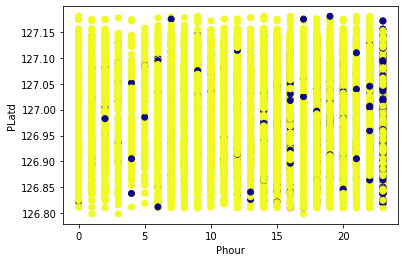

Phour DLong


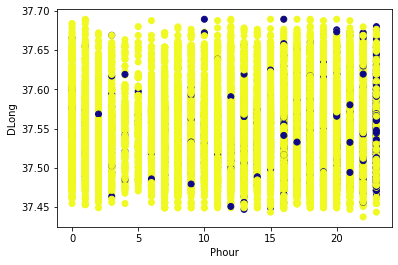

Phour DLatd


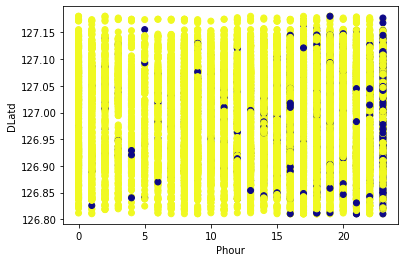

Phour Haversine


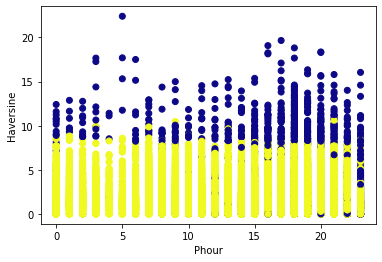

Phour Pmonth


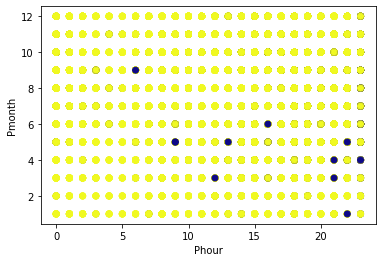

Phour Pday


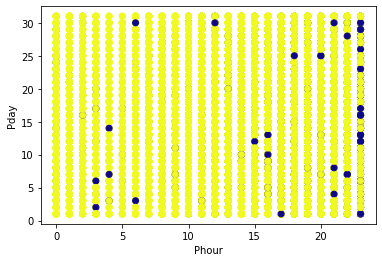

Phour Phour


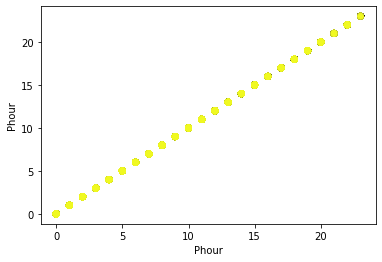

Phour Pmin


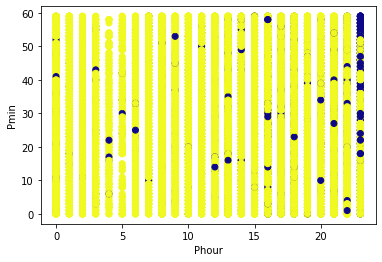

Phour PDweek


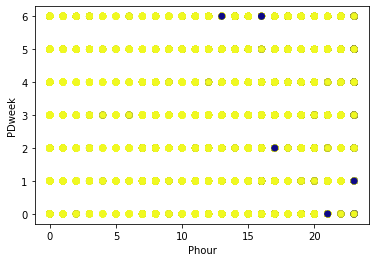

Phour Dmonth


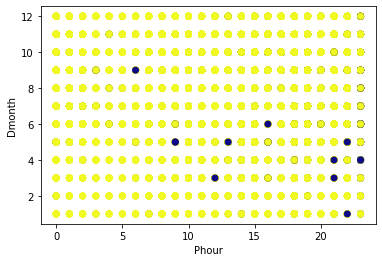

Phour Dday


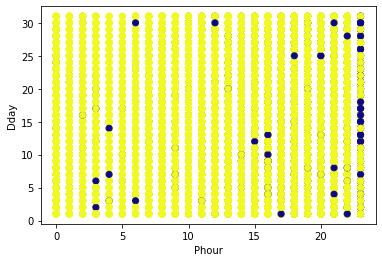

Phour Dhour


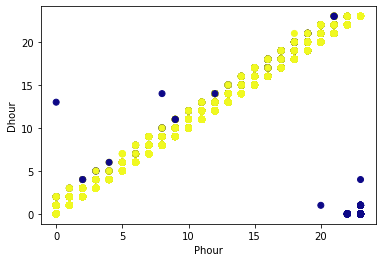

Phour Dmin


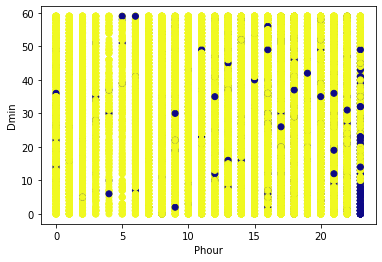

Phour DDweek


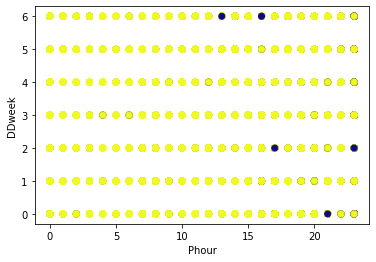

Phour Temp


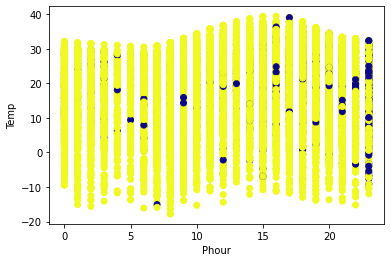

Phour Precip


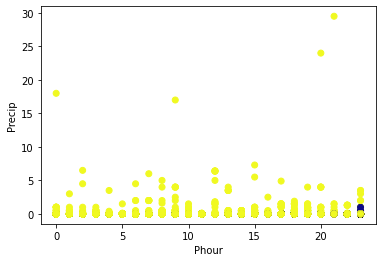

Phour Wind


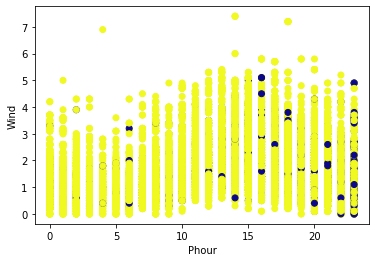

Phour Humid


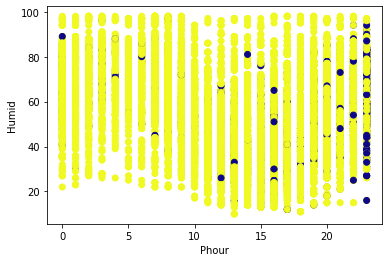

Phour Solar


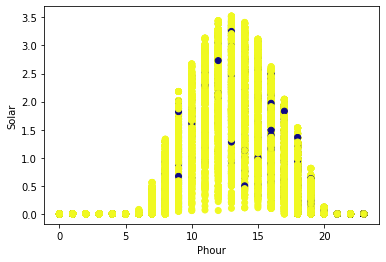

Phour Snow


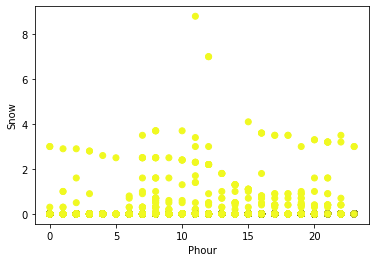

Phour GroundTemp


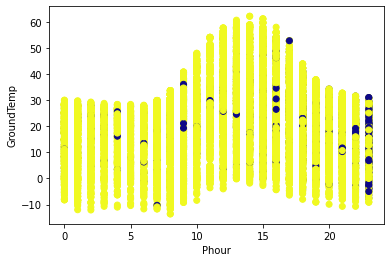

Phour Dust


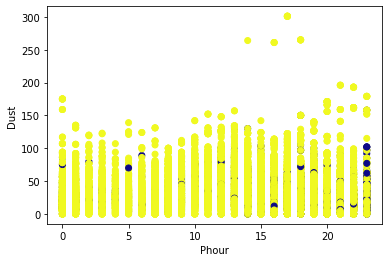

Pmin Duration


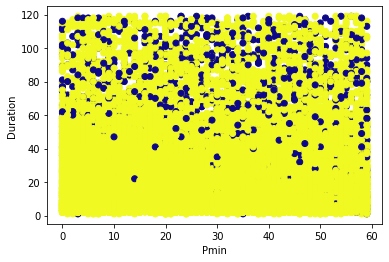

Pmin PLong


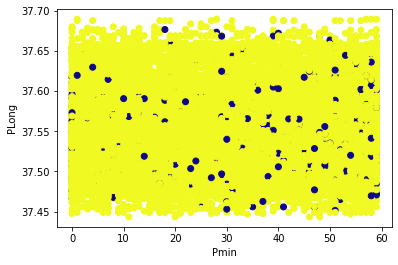

Pmin PLatd


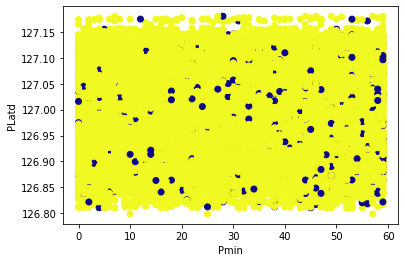

Pmin DLong


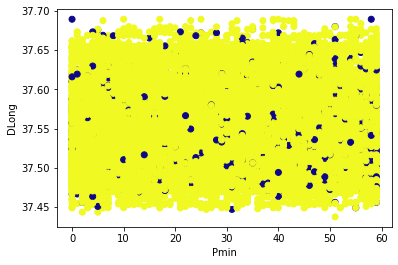

Pmin DLatd


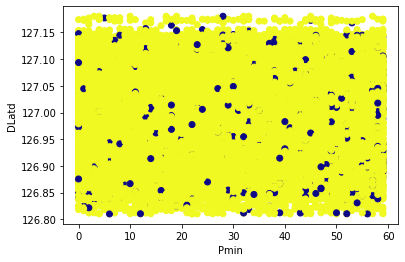

Pmin Haversine


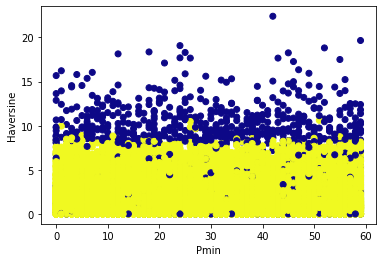

Pmin Pmonth


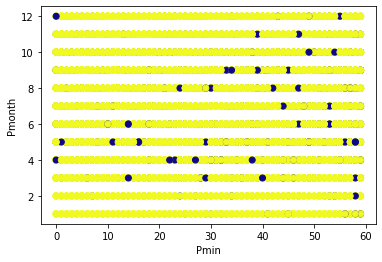

Pmin Pday


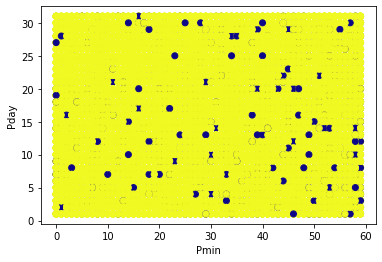

Pmin Phour


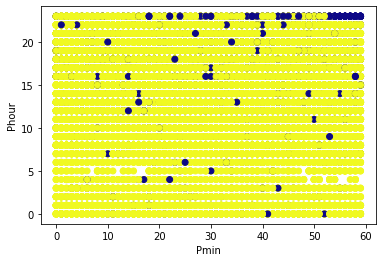

Pmin Pmin


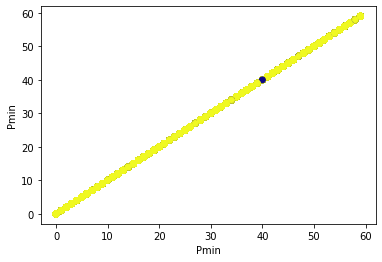

Pmin PDweek


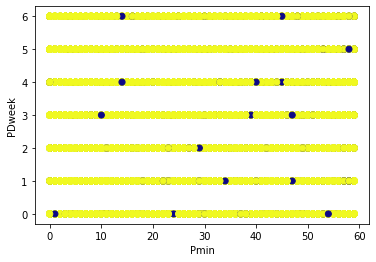

Pmin Dmonth


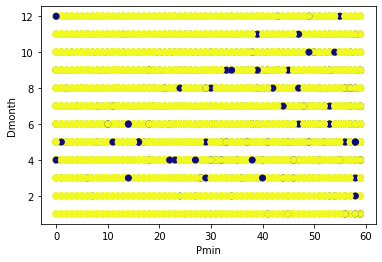

Pmin Dday


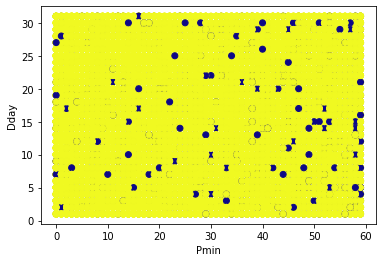

Pmin Dhour


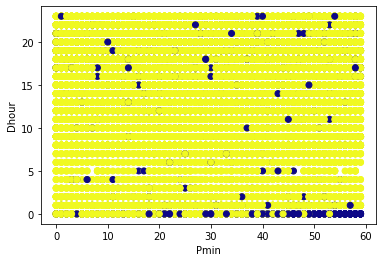

Pmin Dmin


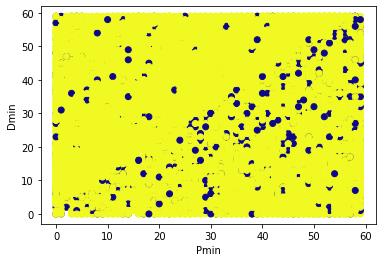

Pmin DDweek


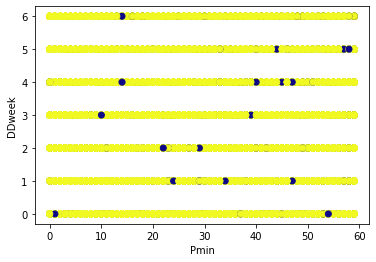

Pmin Temp


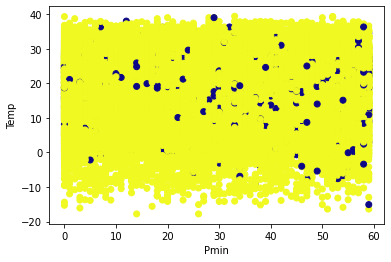

Pmin Precip


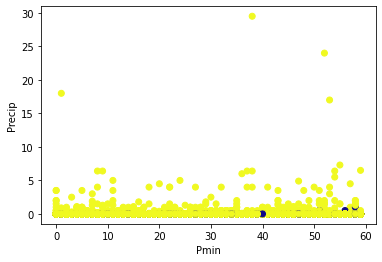

Pmin Wind


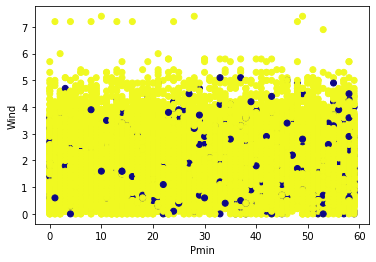

Pmin Humid


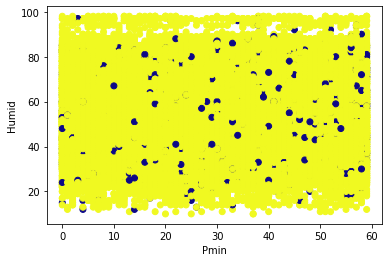

Pmin Solar


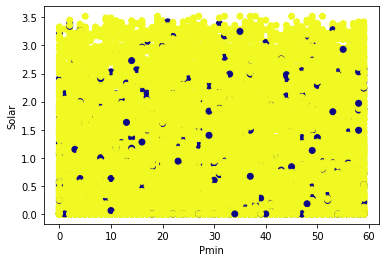

Pmin Snow


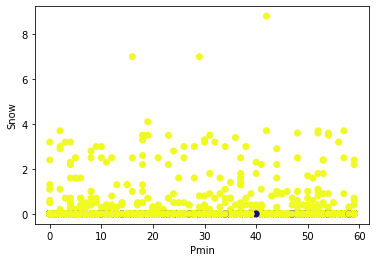

Pmin GroundTemp


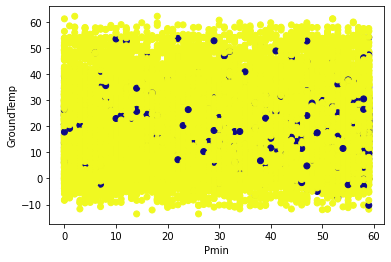

Pmin Dust


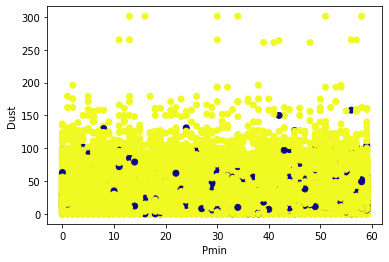

PDweek Duration


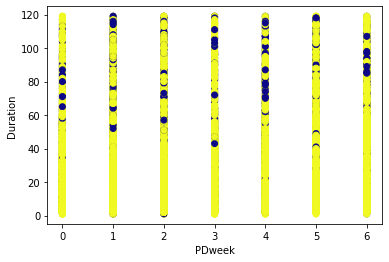

PDweek PLong


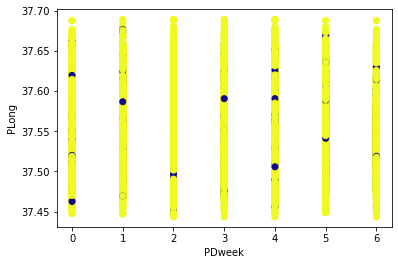

PDweek PLatd


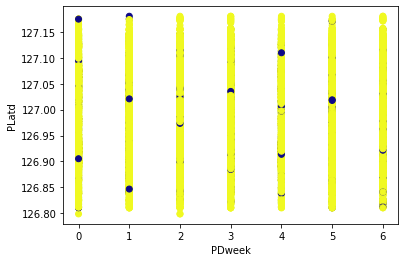

PDweek DLong


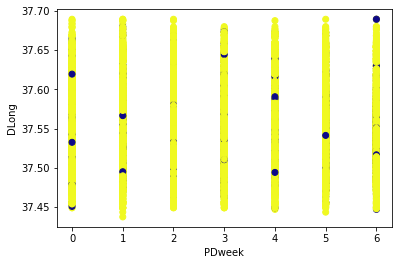

PDweek DLatd


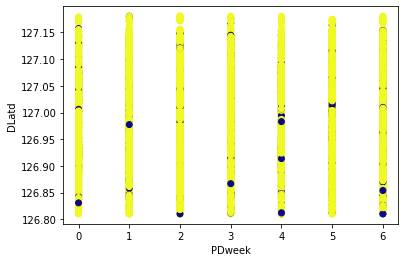

PDweek Haversine


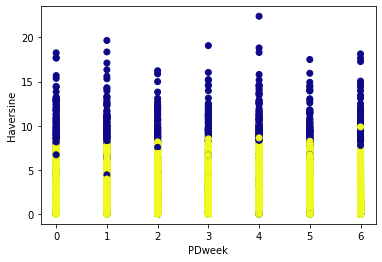

PDweek Pmonth


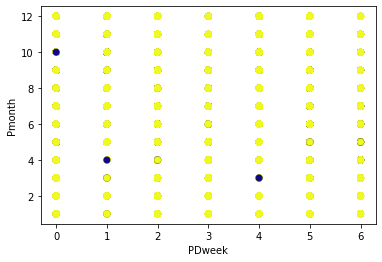

PDweek Pday


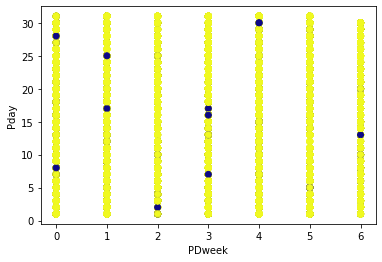

PDweek Phour


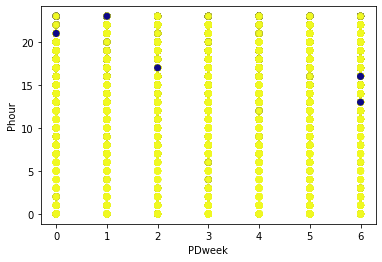

PDweek Pmin


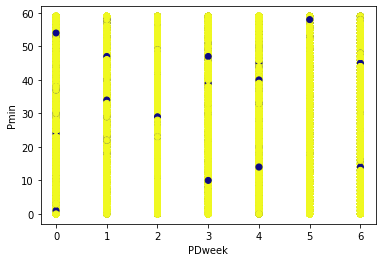

PDweek PDweek


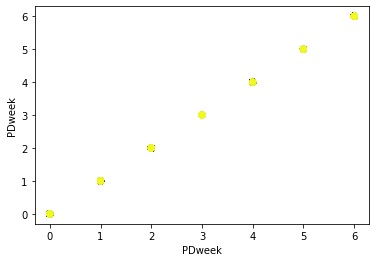

PDweek Dmonth


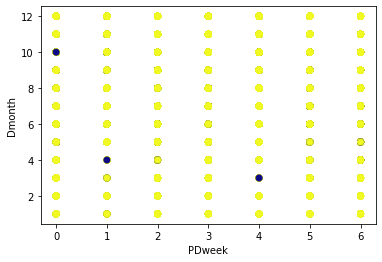

PDweek Dday


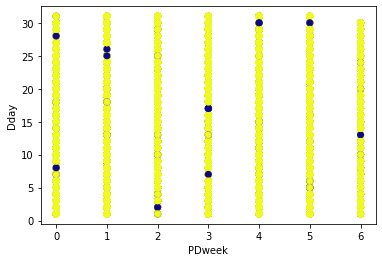

PDweek Dhour


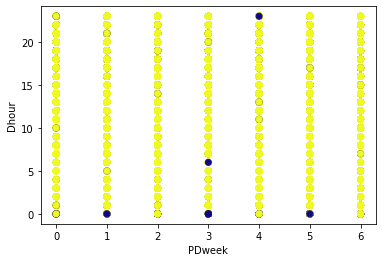

PDweek Dmin


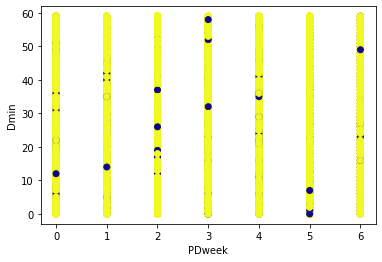

PDweek DDweek


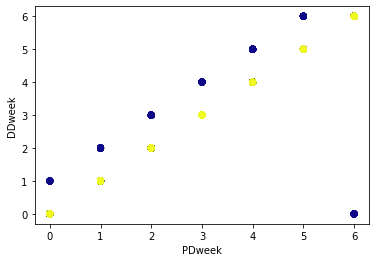

PDweek Temp


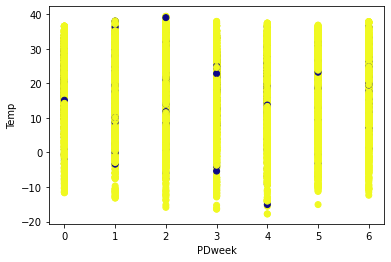

PDweek Precip


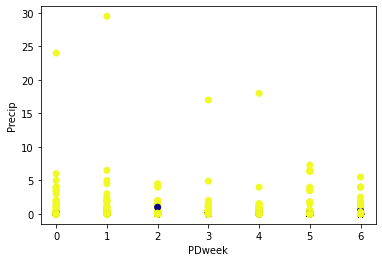

PDweek Wind


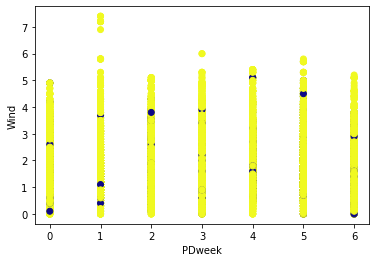

PDweek Humid


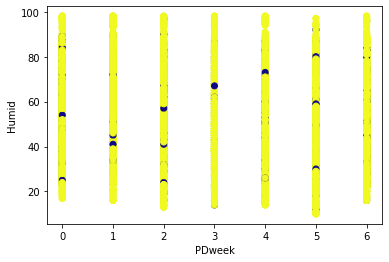

PDweek Solar


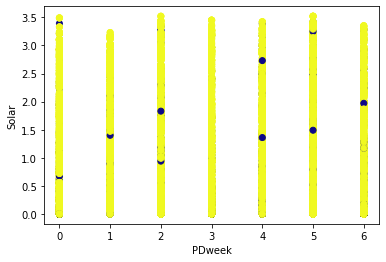

PDweek Snow


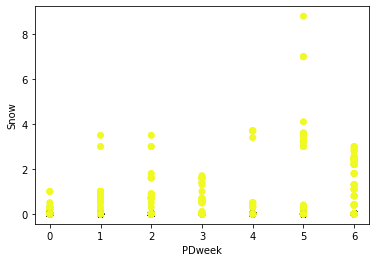

PDweek GroundTemp


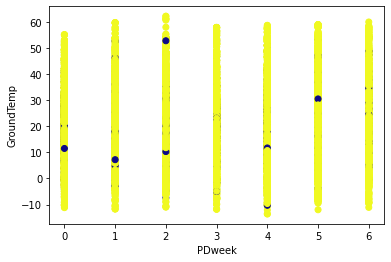

PDweek Dust


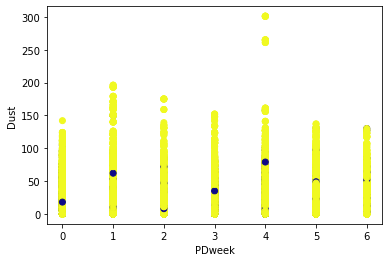

Dmonth Duration


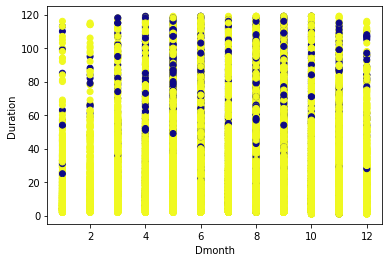

Dmonth PLong


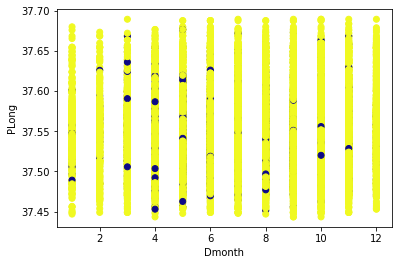

Dmonth PLatd


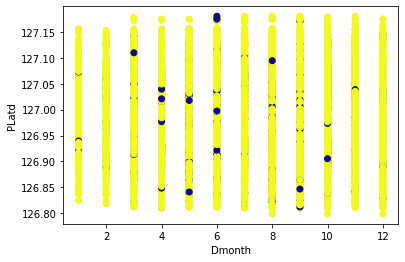

Dmonth DLong


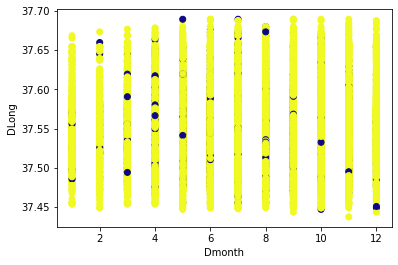

Dmonth DLatd


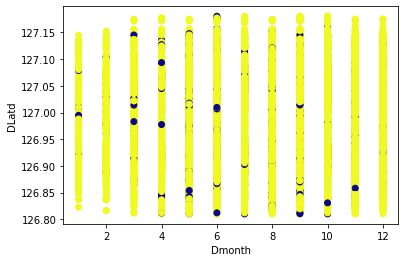

Dmonth Haversine


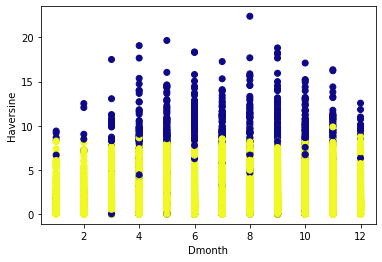

Dmonth Pmonth


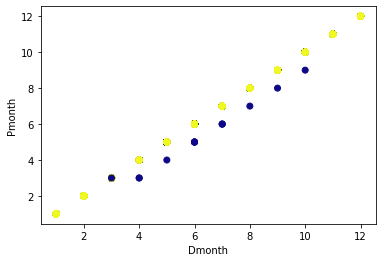

Dmonth Pday


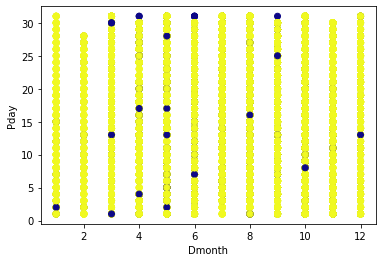

Dmonth Phour


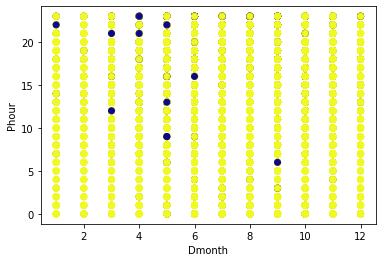

Dmonth Pmin


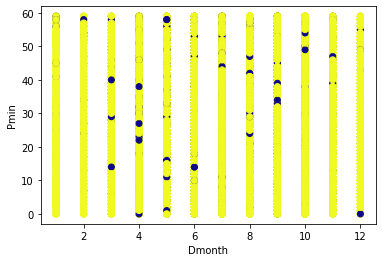

Dmonth PDweek


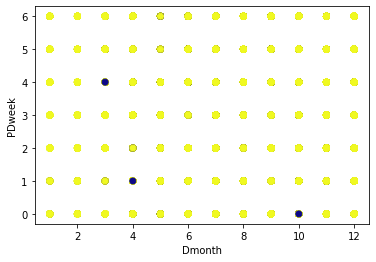

Dmonth Dmonth


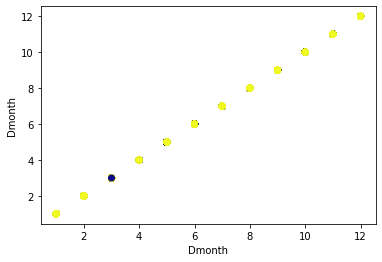

Dmonth Dday


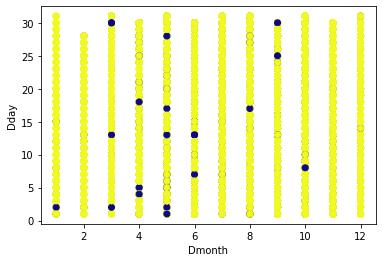

Dmonth Dhour


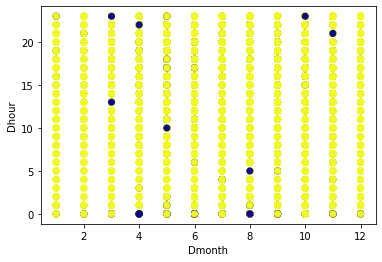

Dmonth Dmin


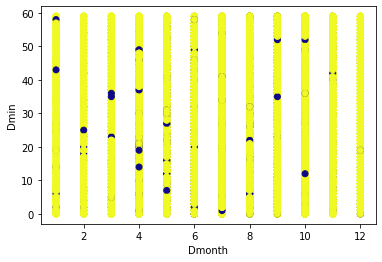

Dmonth DDweek


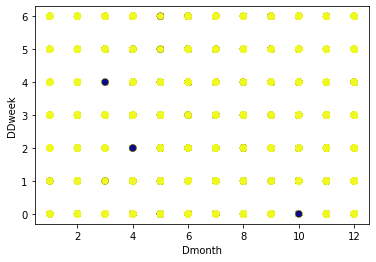

Dmonth Temp


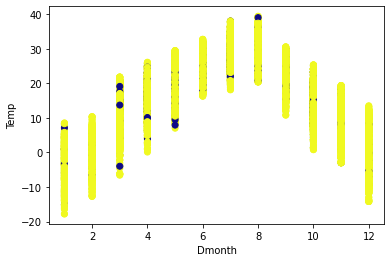

Dmonth Precip


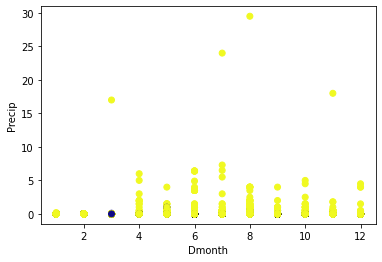

Dmonth Wind


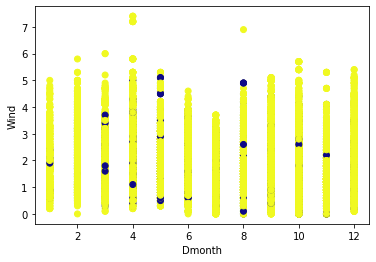

Dmonth Humid


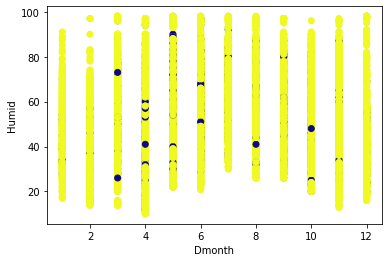

Dmonth Solar


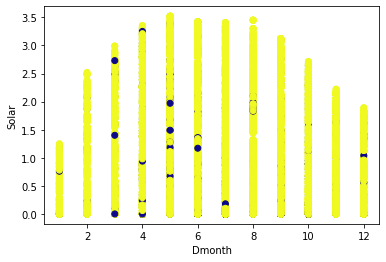

Dmonth Snow


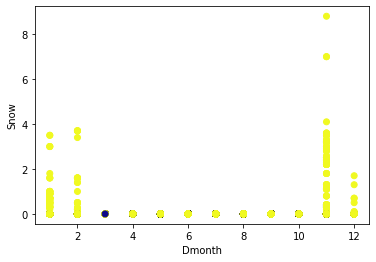

Dmonth GroundTemp


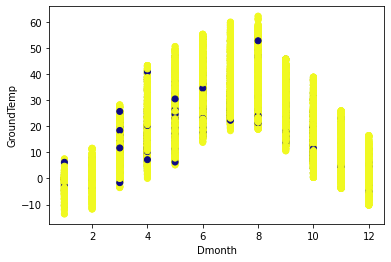

Dmonth Dust


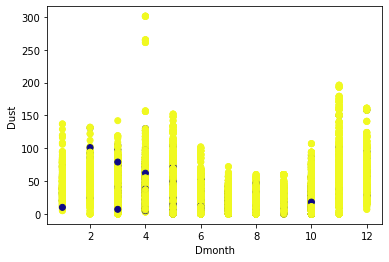

Dday Duration


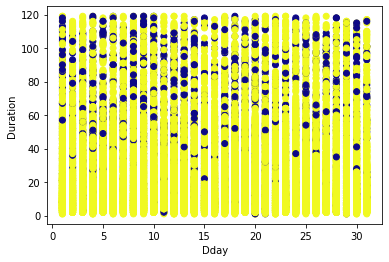

Dday PLong


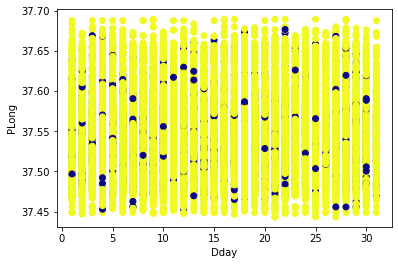

Dday PLatd


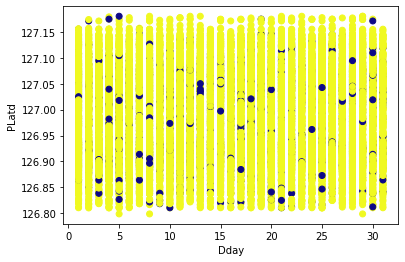

Dday DLong


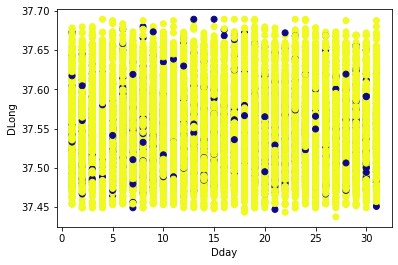

Dday DLatd


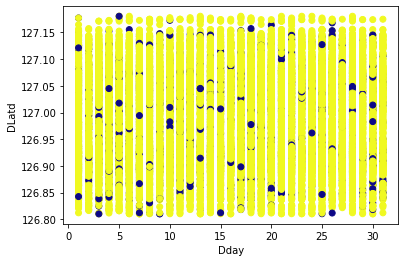

Dday Haversine


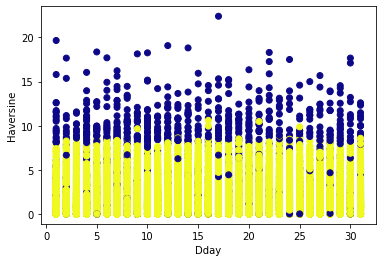

Dday Pmonth


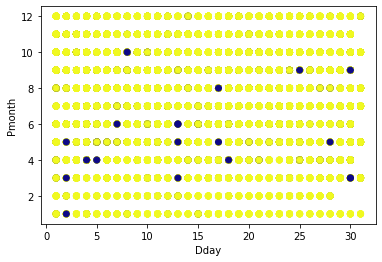

Dday Pday


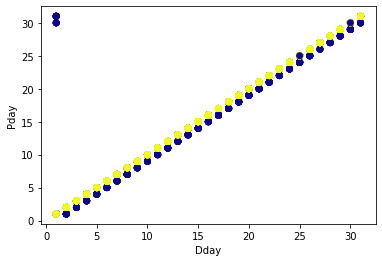

Dday Phour


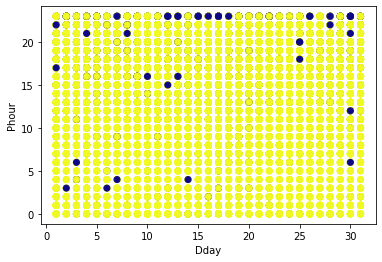

Dday Pmin


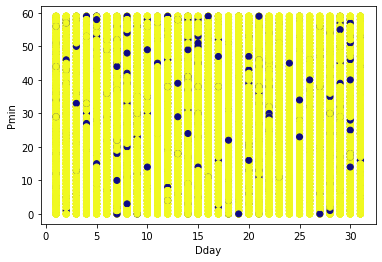

Dday PDweek


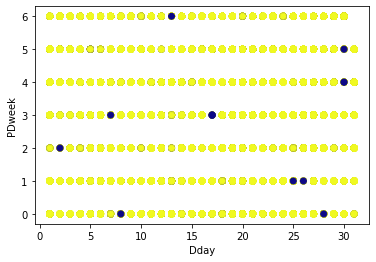

Dday Dmonth


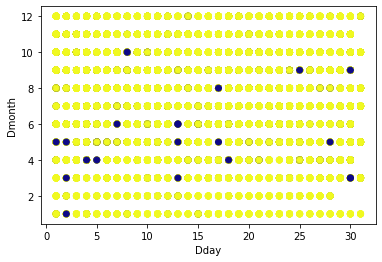

Dday Dday


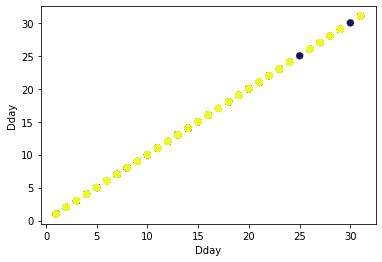

Dday Dhour


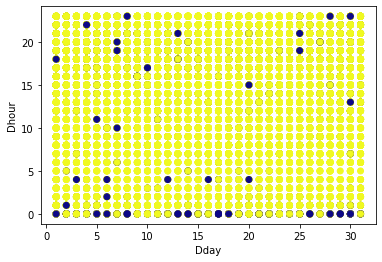

Dday Dmin


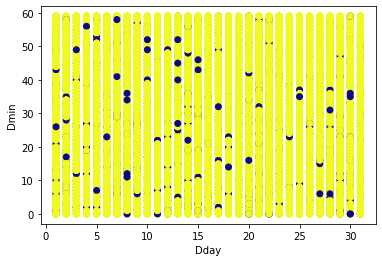

Dday DDweek


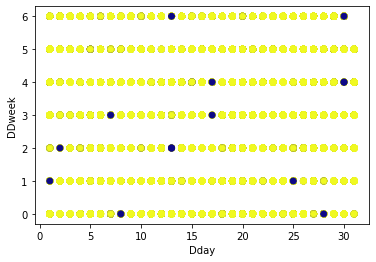

Dday Temp


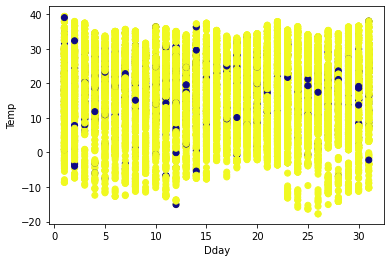

Dday Precip


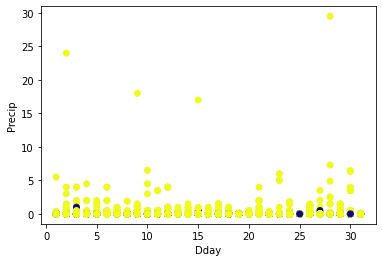

Dday Wind


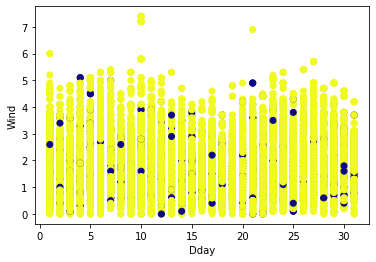

Dday Humid


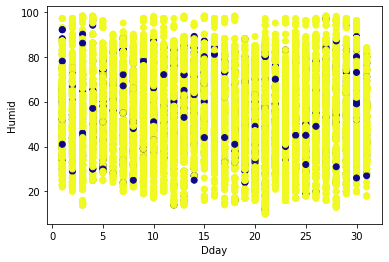

Dday Solar


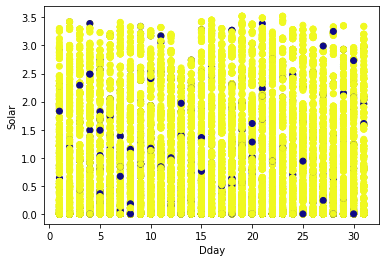

Dday Snow


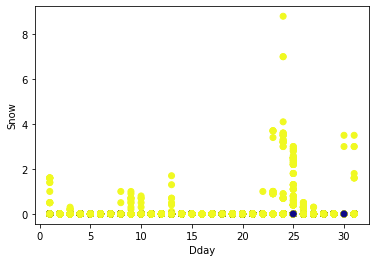

Dday GroundTemp


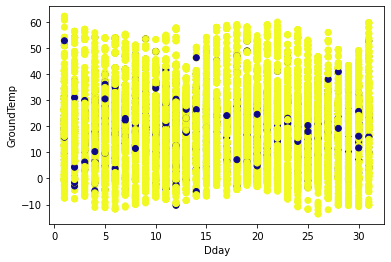

Dday Dust


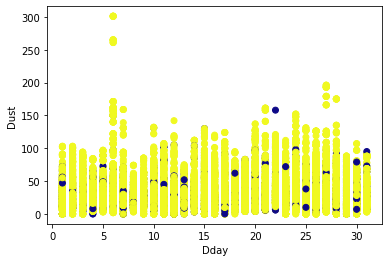

Dhour Duration


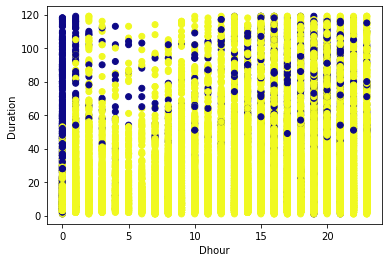

Dhour PLong


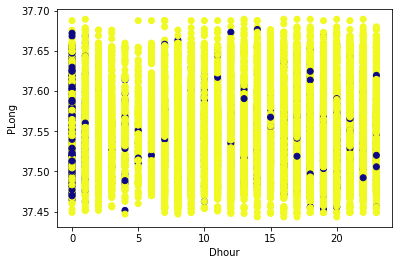

Dhour PLatd


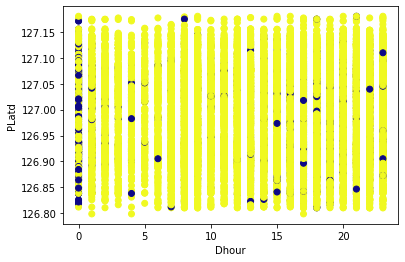

Dhour DLong


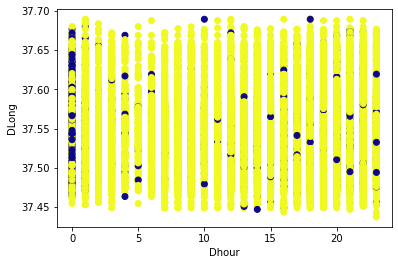

Dhour DLatd


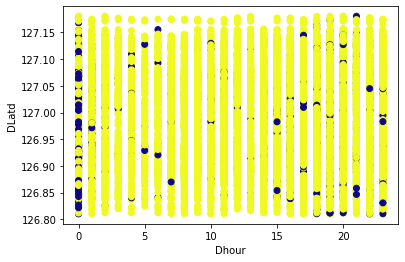

Dhour Haversine


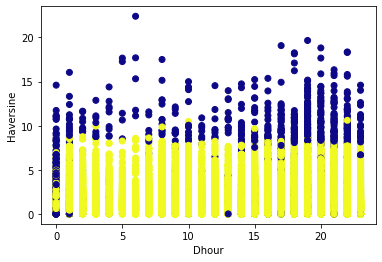

Dhour Pmonth


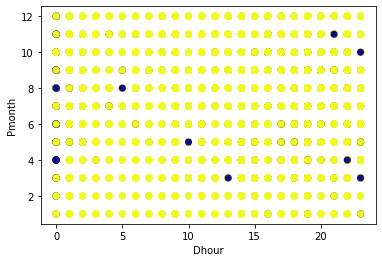

Dhour Pday


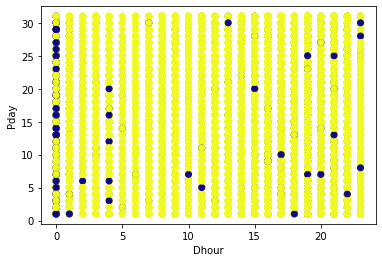

Dhour Phour


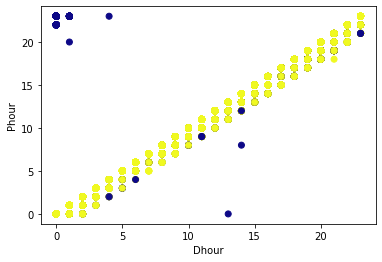

Dhour Pmin


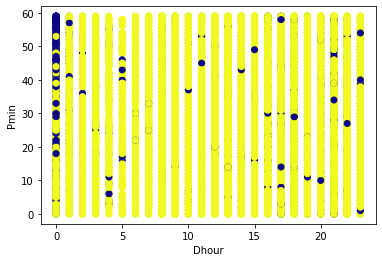

Dhour PDweek


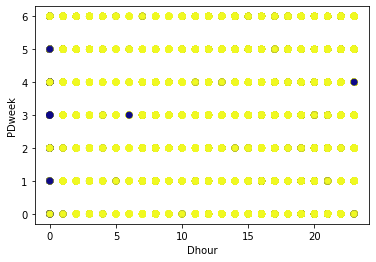

Dhour Dmonth


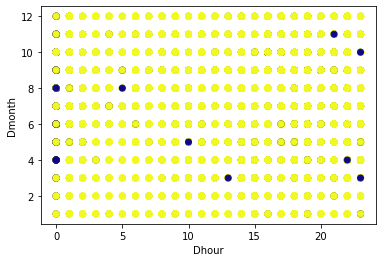

Dhour Dday


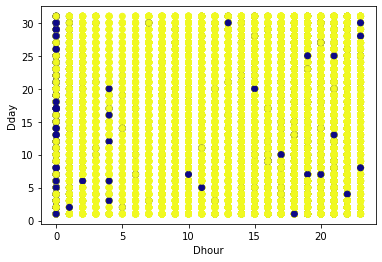

Dhour Dhour


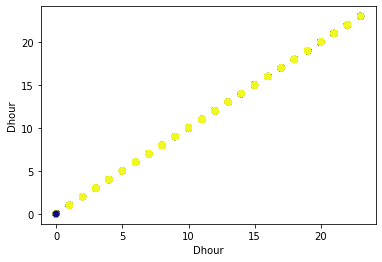

Dhour Dmin


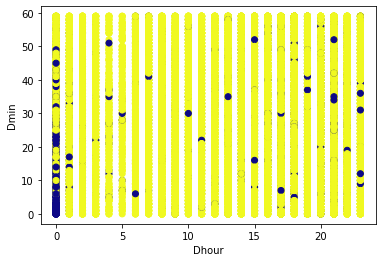

Dhour DDweek


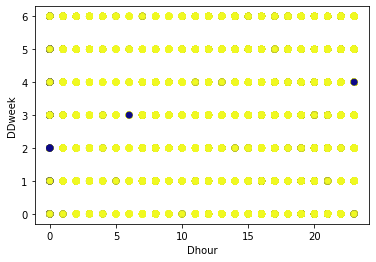

Dhour Temp


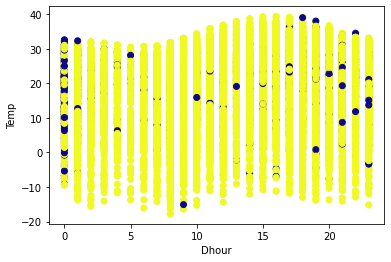

Dhour Precip


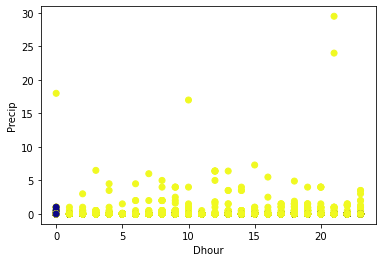

Dhour Wind


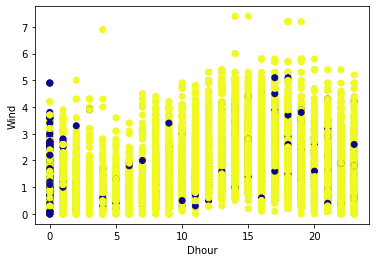

Dhour Humid


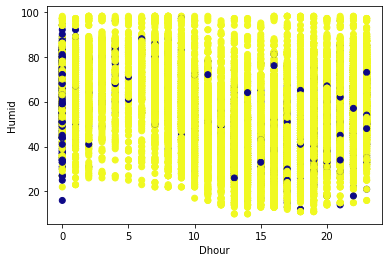

Dhour Solar


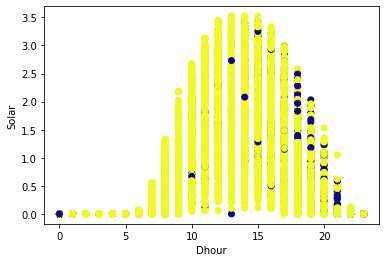

Dhour Snow


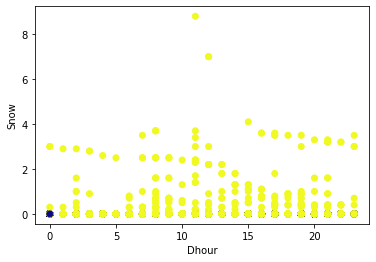

Dhour GroundTemp


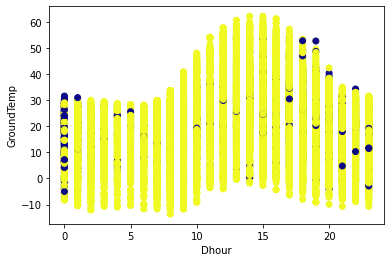

Dhour Dust


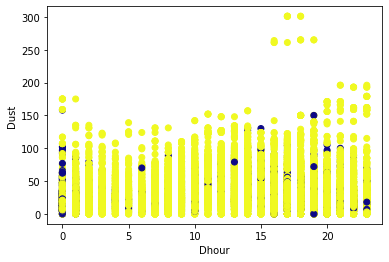

Dmin Duration


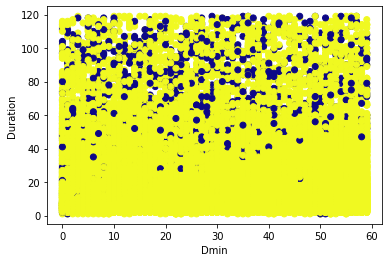

Dmin PLong


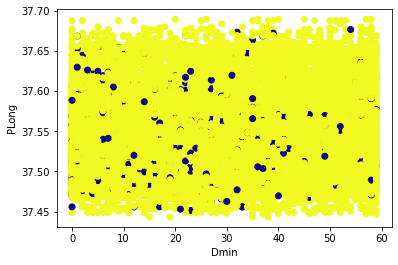

Dmin PLatd


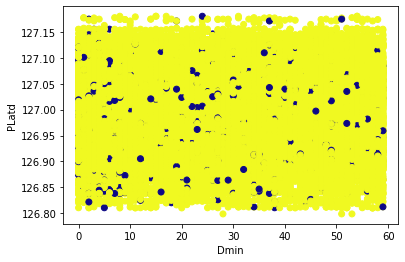

Dmin DLong


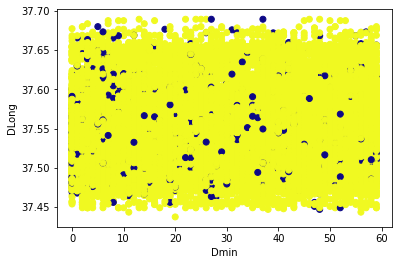

Dmin DLatd


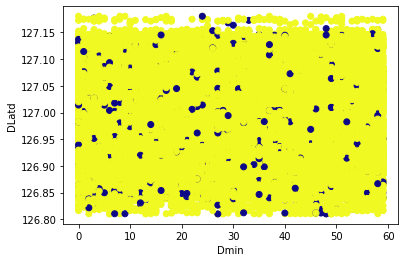

Dmin Haversine


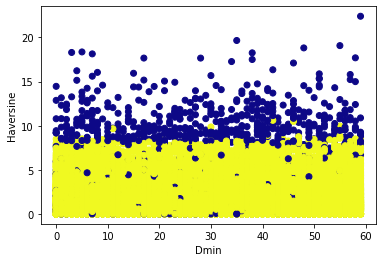

Dmin Pmonth


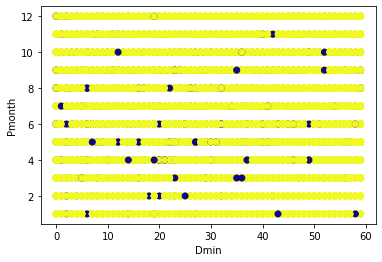

Dmin Pday


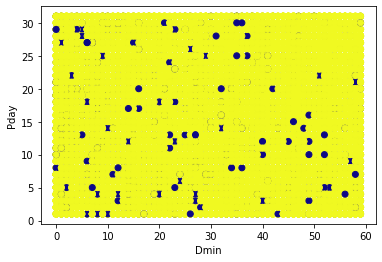

Dmin Phour


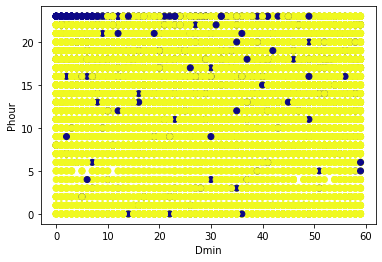

Dmin Pmin


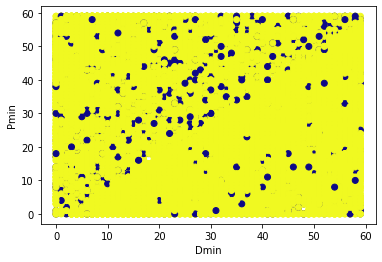

Dmin PDweek


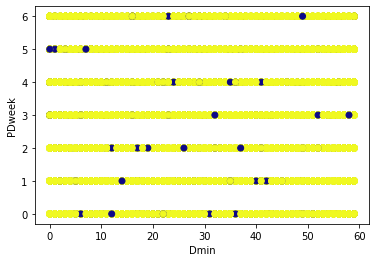

Dmin Dmonth


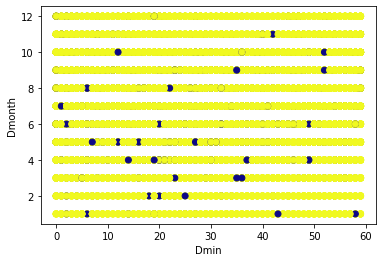

Dmin Dday


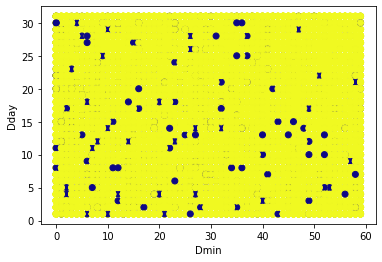

Dmin Dhour


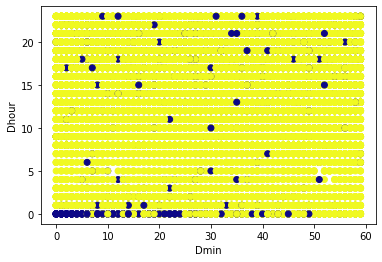

Dmin Dmin


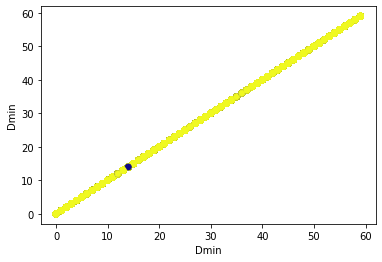

Dmin DDweek


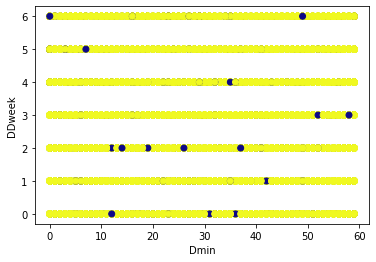

Dmin Temp


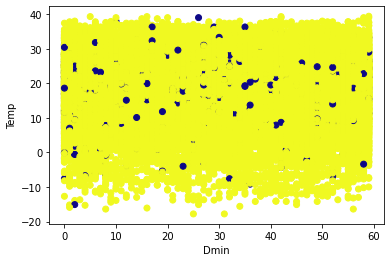

Dmin Precip


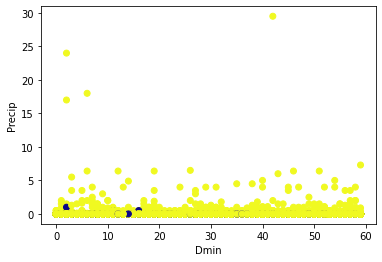

Dmin Wind


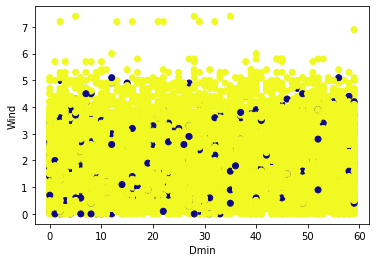

Dmin Humid


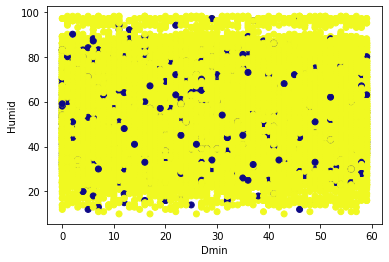

Dmin Solar


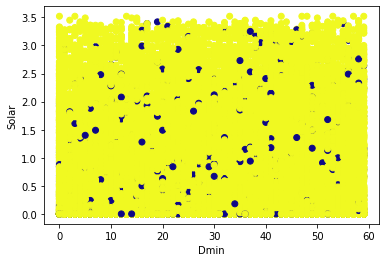

Dmin Snow


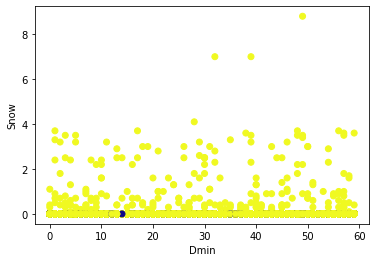

Dmin GroundTemp


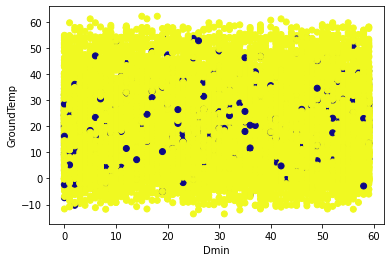

Dmin Dust


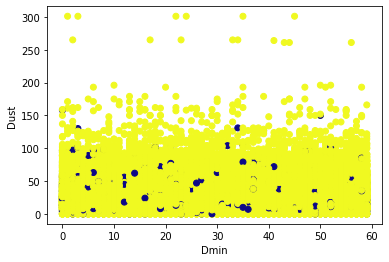

DDweek Duration


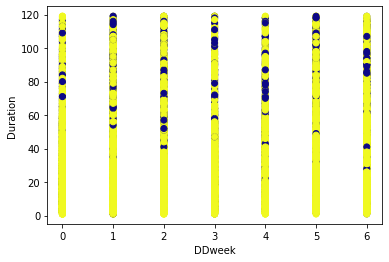

DDweek PLong


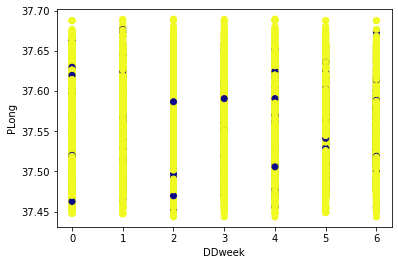

DDweek PLatd


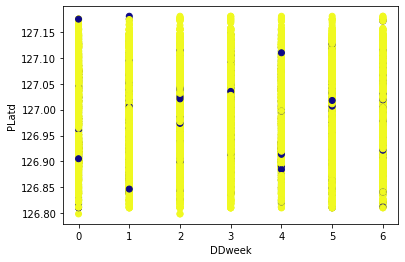

DDweek DLong


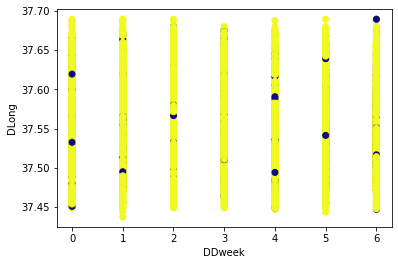

DDweek DLatd


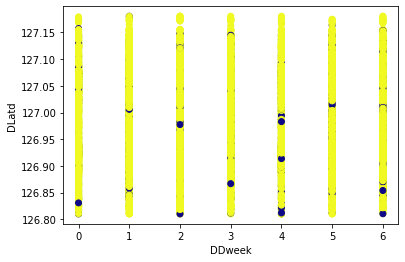

DDweek Haversine


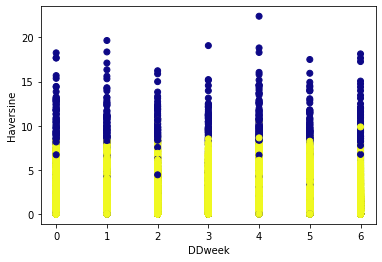

DDweek Pmonth


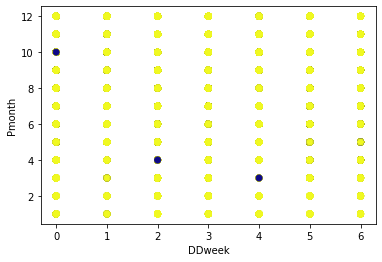

DDweek Pday


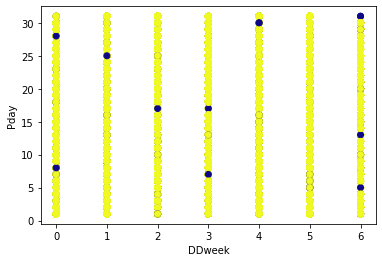

DDweek Phour


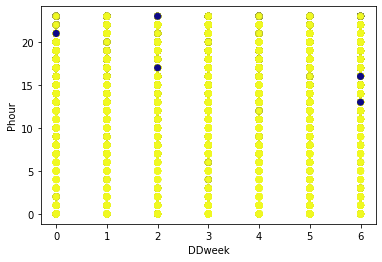

DDweek Pmin


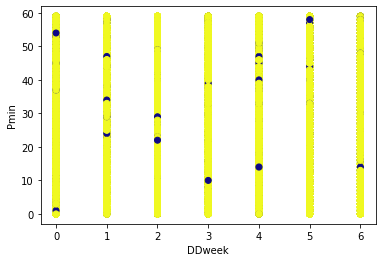

DDweek PDweek


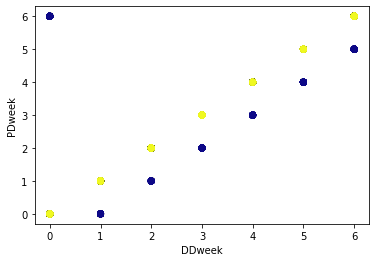

DDweek Dmonth


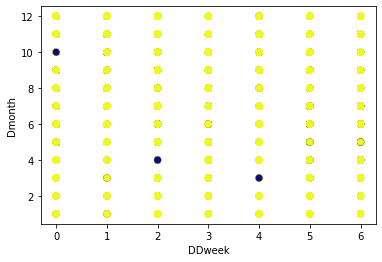

DDweek Dday


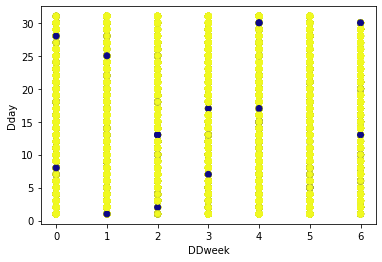

DDweek Dhour


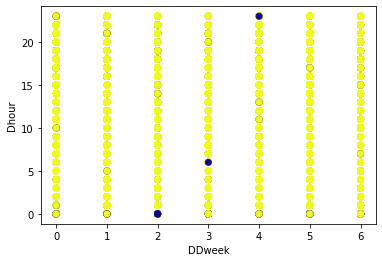

DDweek Dmin


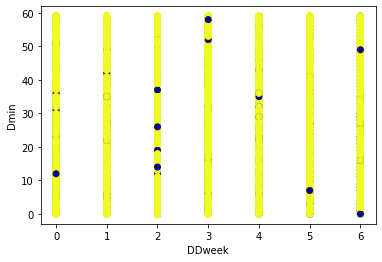

DDweek DDweek


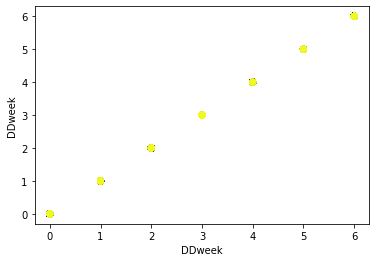

DDweek Temp


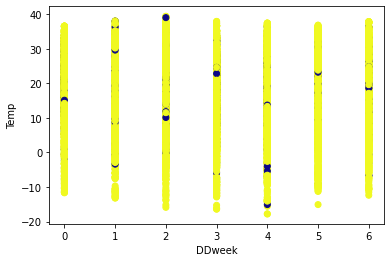

DDweek Precip


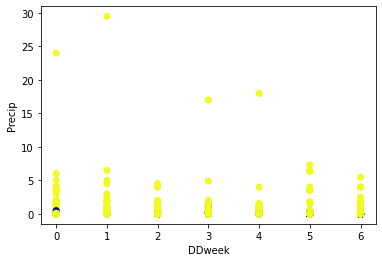

DDweek Wind


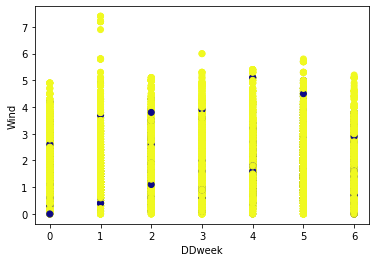

DDweek Humid


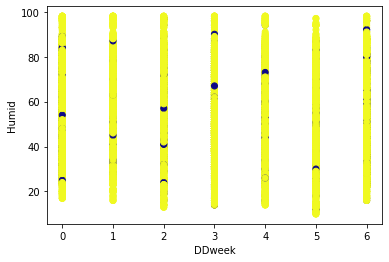

DDweek Solar


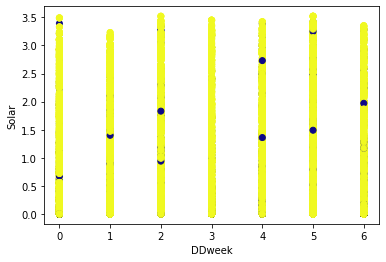

DDweek Snow


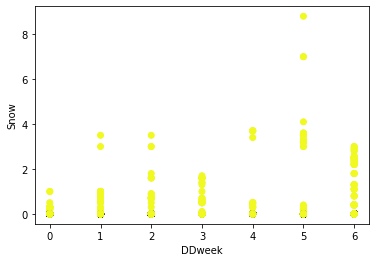

DDweek GroundTemp


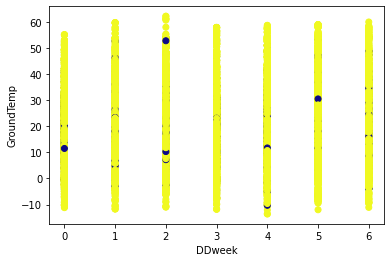

DDweek Dust


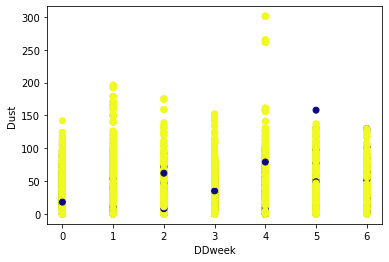

Temp Duration


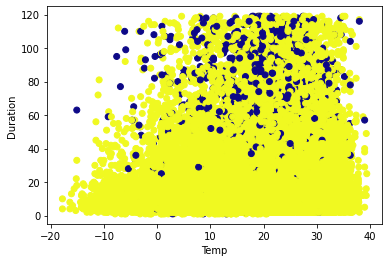

Temp PLong


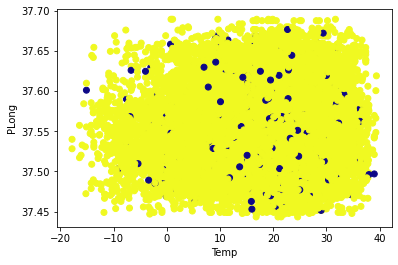

Temp PLatd


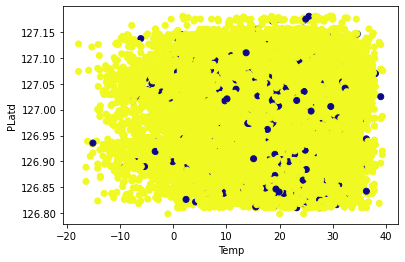

Temp DLong


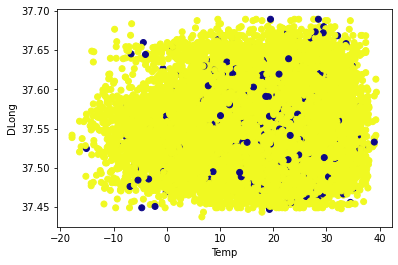

Temp DLatd


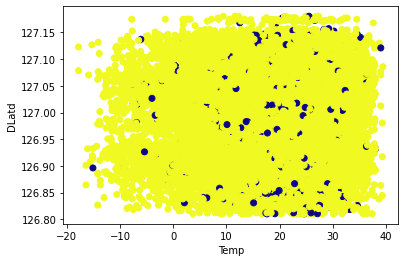

Temp Haversine


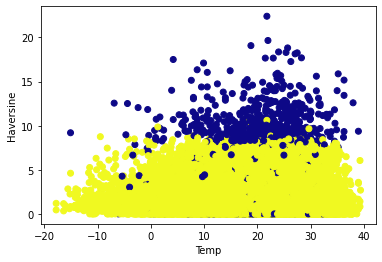

Temp Pmonth


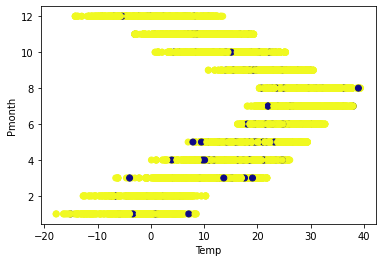

Temp Pday


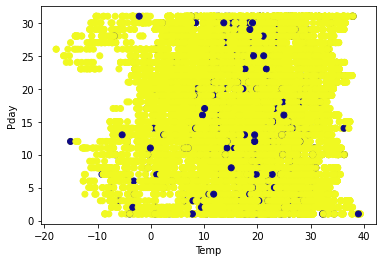

Temp Phour


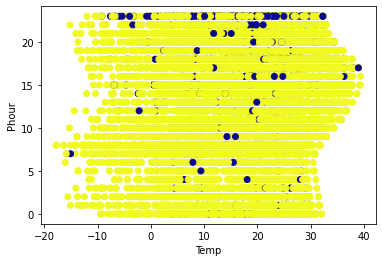

Temp Pmin


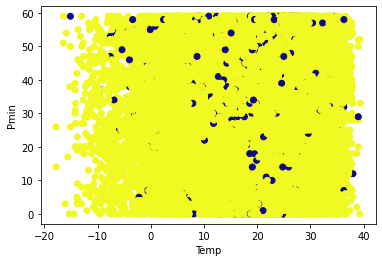

Temp PDweek


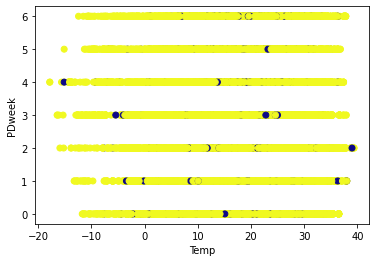

Temp Dmonth


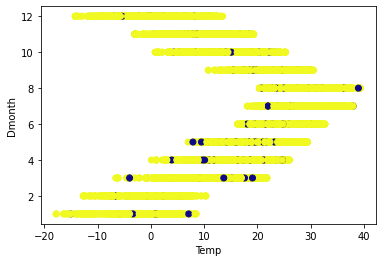

Temp Dday


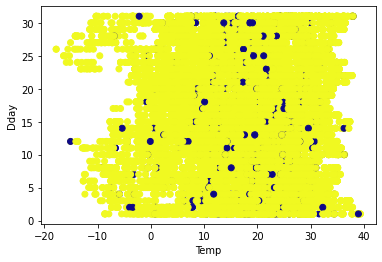

Temp Dhour


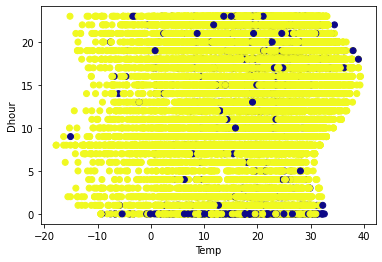

Temp Dmin


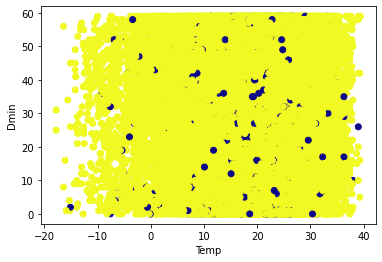

Temp DDweek


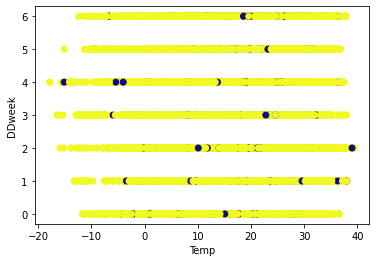

Temp Temp


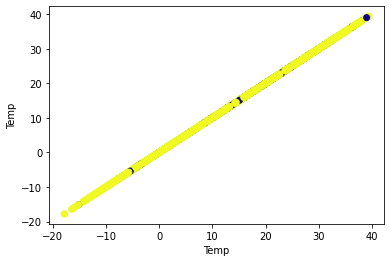

Temp Precip


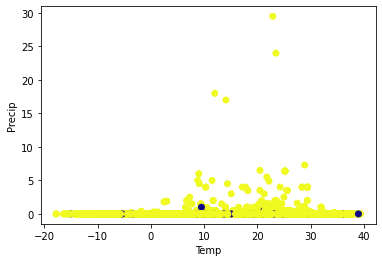

Temp Wind


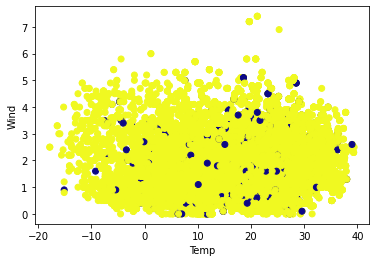

Temp Humid


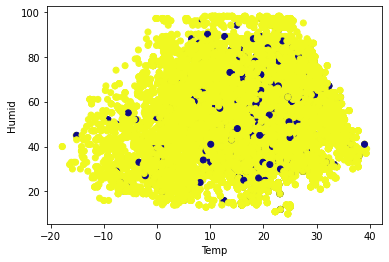

Temp Solar


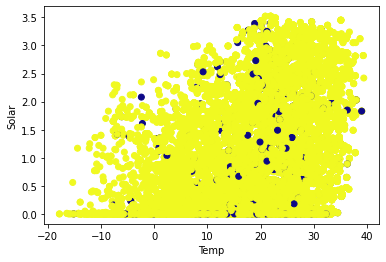

Temp Snow


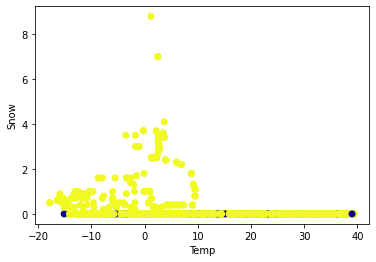

Temp GroundTemp


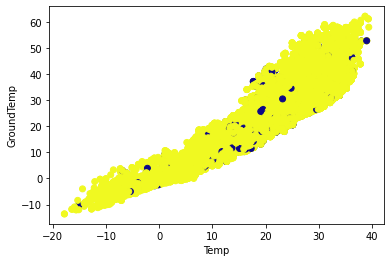

Temp Dust


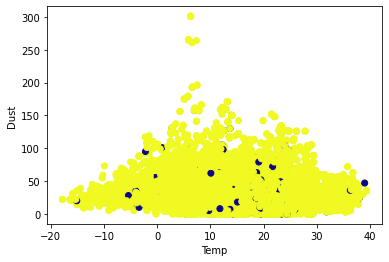

Precip Duration


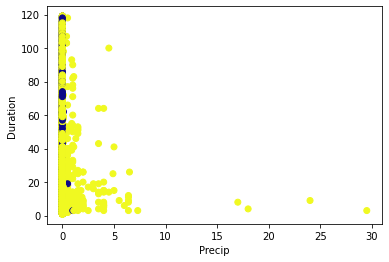

Precip PLong


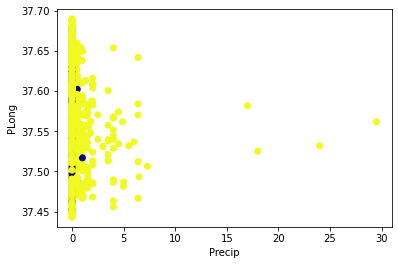

Precip PLatd


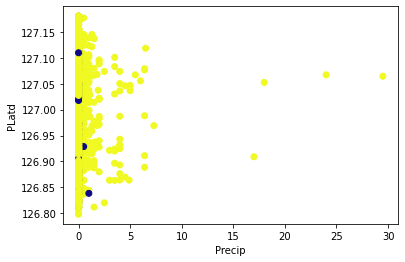

Precip DLong


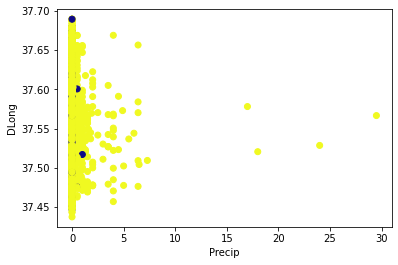

Precip DLatd


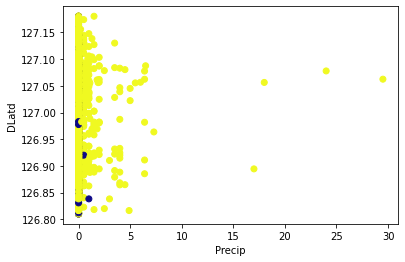

Precip Haversine


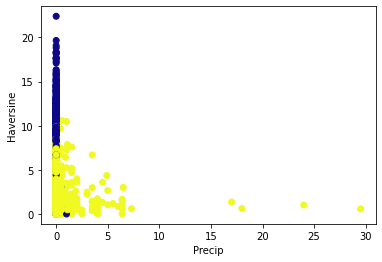

Precip Pmonth


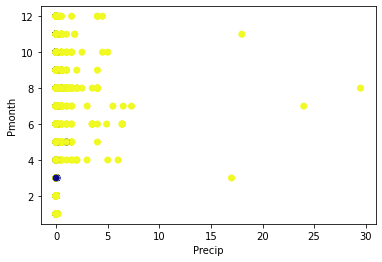

Precip Pday


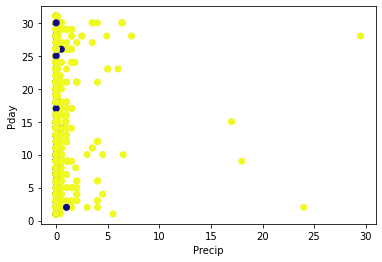

Precip Phour


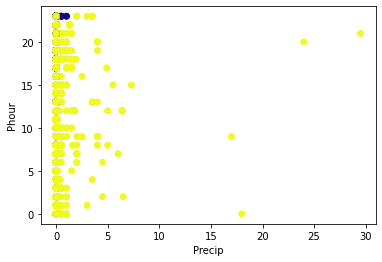

Precip Pmin


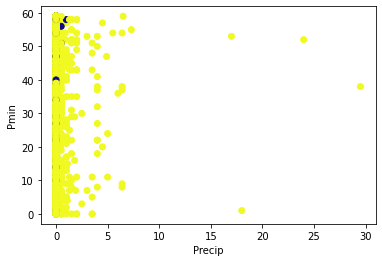

Precip PDweek


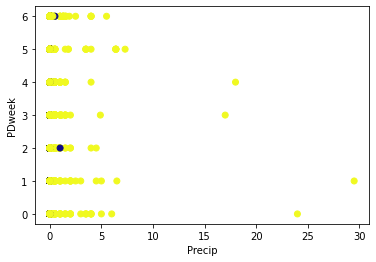

Precip Dmonth


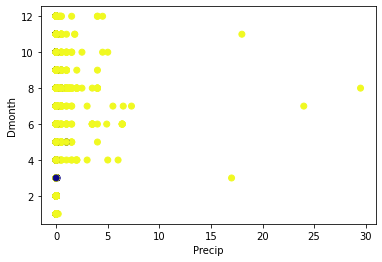

Precip Dday


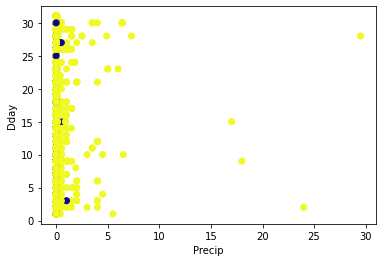

Precip Dhour


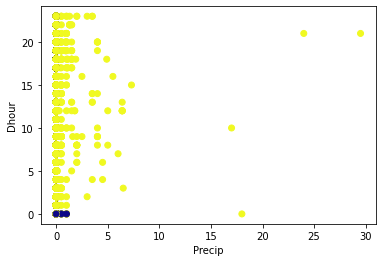

Precip Dmin


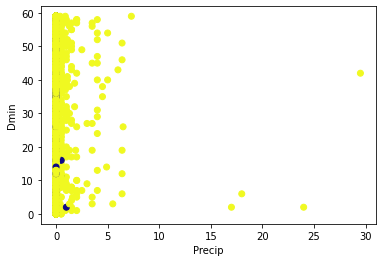

Precip DDweek


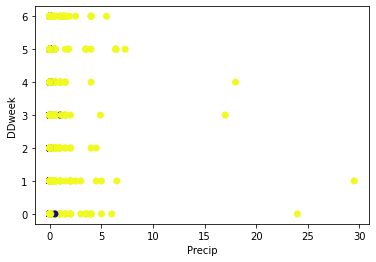

Precip Temp


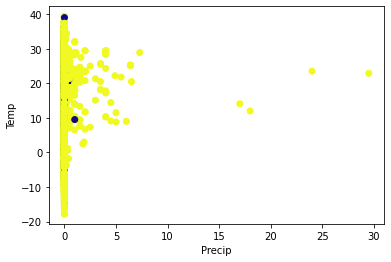

Precip Precip


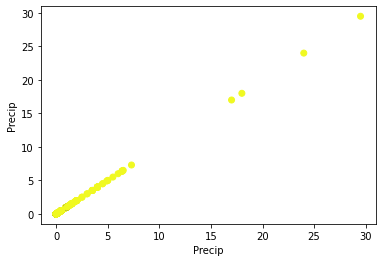

Precip Wind


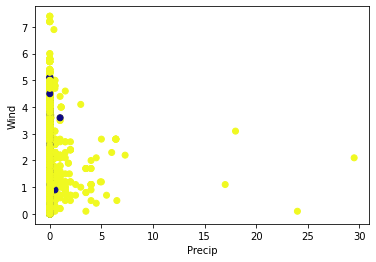

Precip Humid


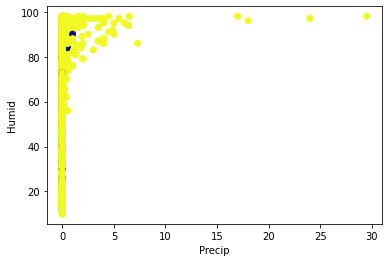

Precip Solar


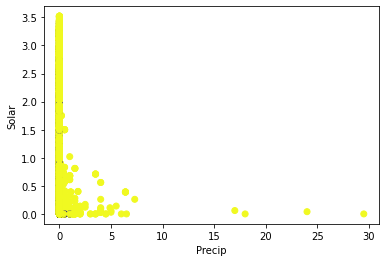

Precip Snow


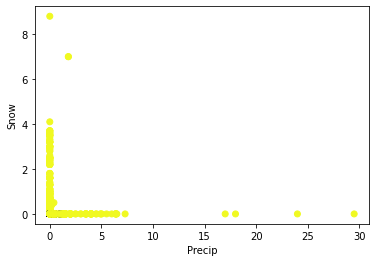

Precip GroundTemp


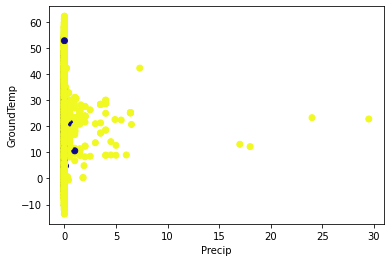

Precip Dust


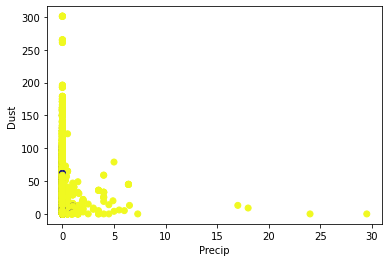

Wind Duration


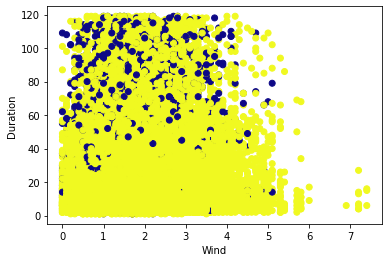

Wind PLong


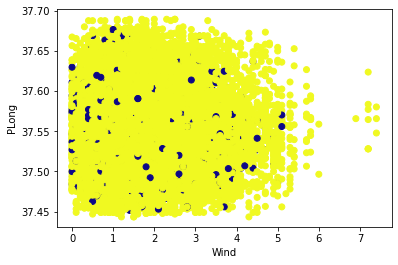

Wind PLatd


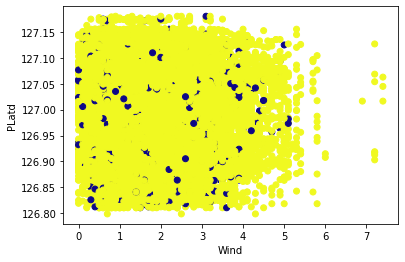

Wind DLong


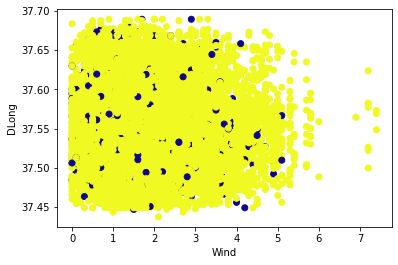

Wind DLatd


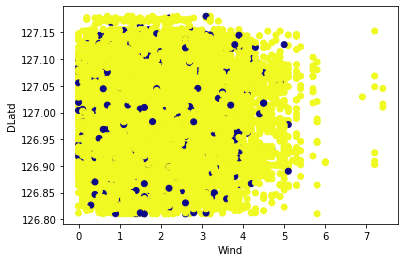

Wind Haversine


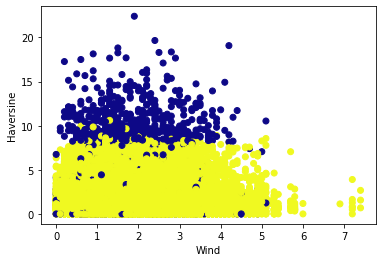

Wind Pmonth


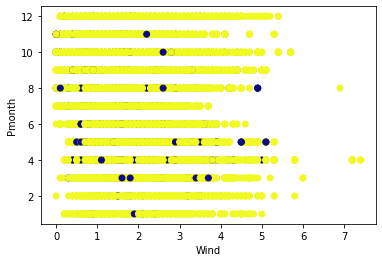

Wind Pday


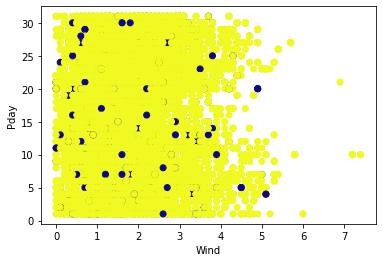

Wind Phour


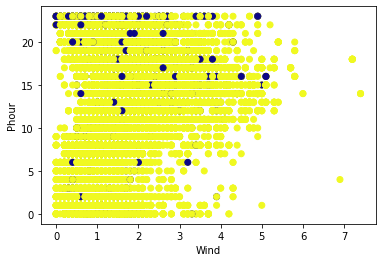

Wind Pmin


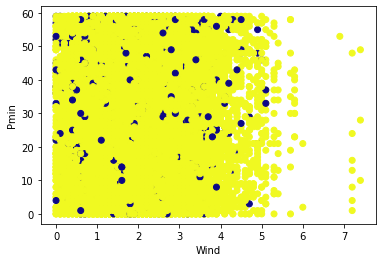

Wind PDweek


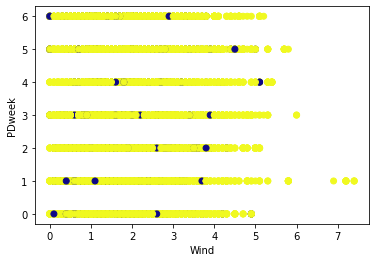

Wind Dmonth


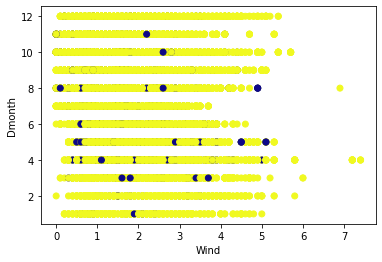

Wind Dday


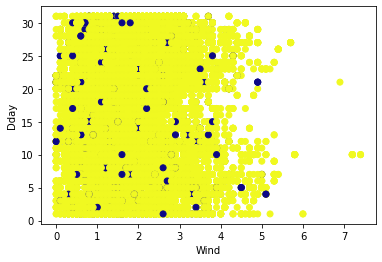

Wind Dhour


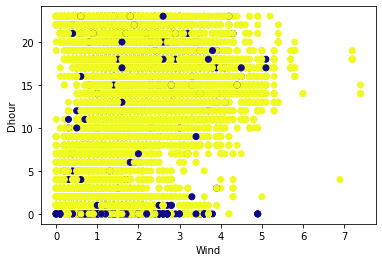

Wind Dmin


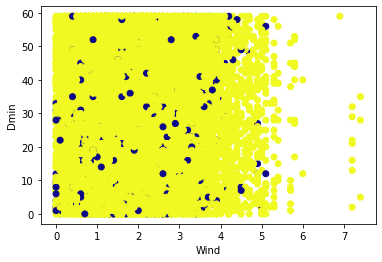

Wind DDweek


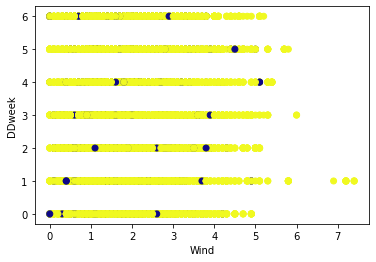

Wind Temp


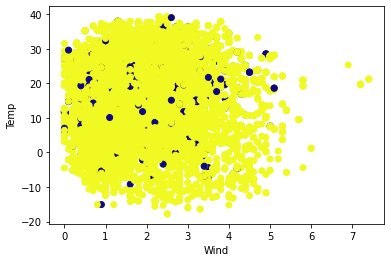

Wind Precip


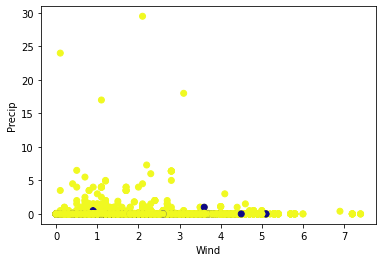

Wind Wind


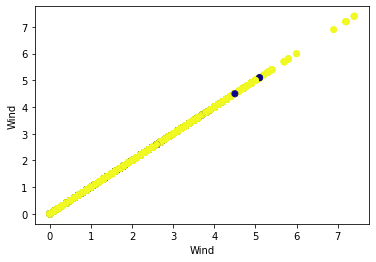

Wind Humid


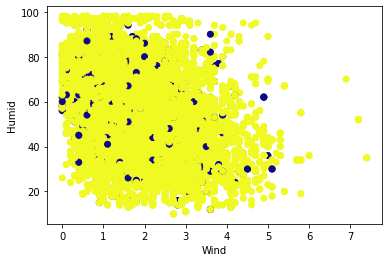

Wind Solar


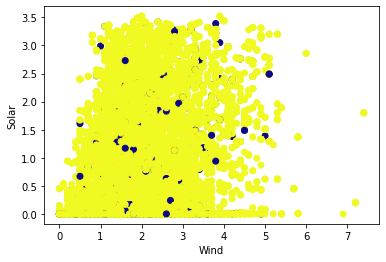

Wind Snow


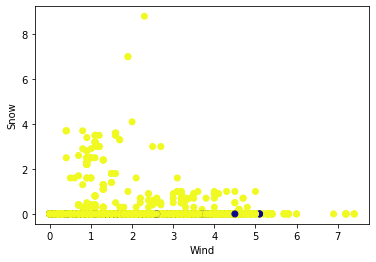

Wind GroundTemp


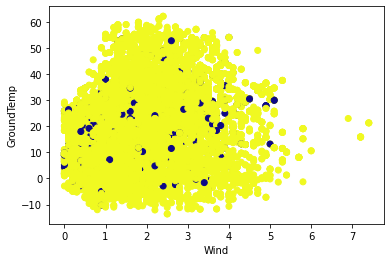

Wind Dust


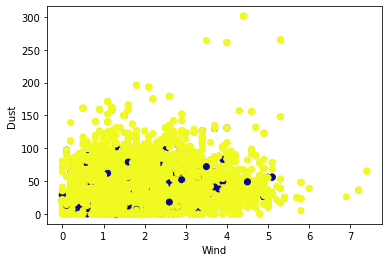

Humid Duration


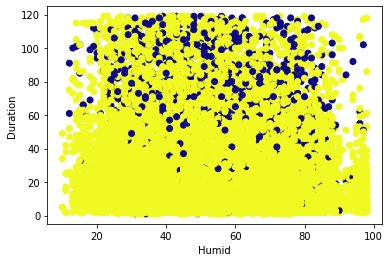

Humid PLong


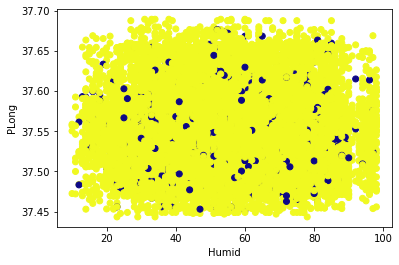

Humid PLatd


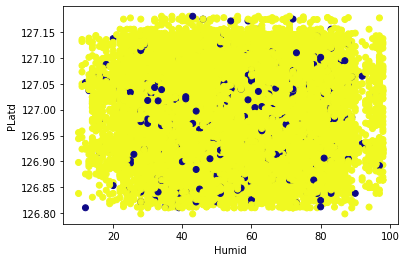

Humid DLong


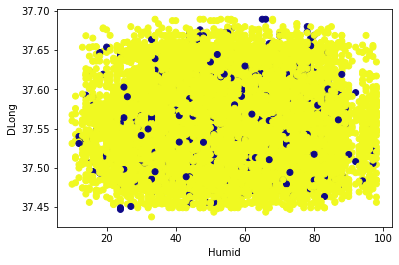

Humid DLatd


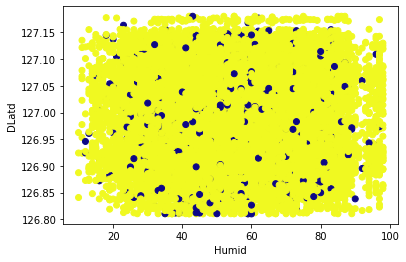

Humid Haversine


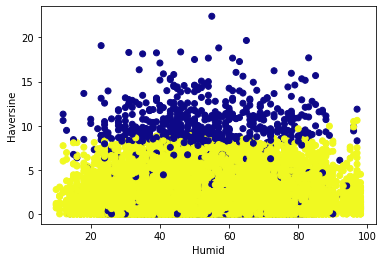

Humid Pmonth


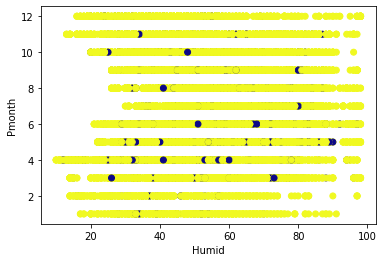

Humid Pday


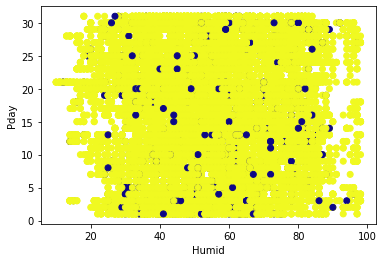

Humid Phour


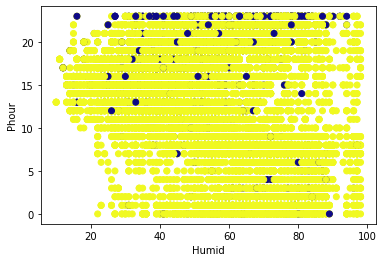

Humid Pmin


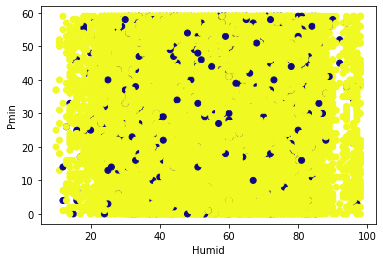

Humid PDweek


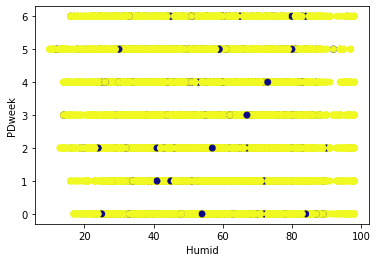

Humid Dmonth


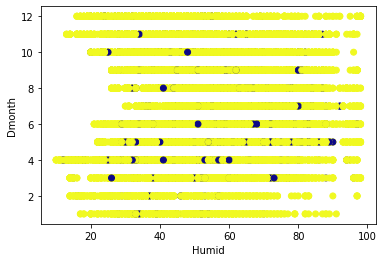

Humid Dday


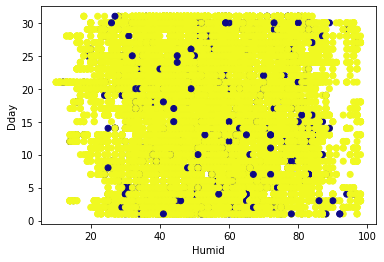

Humid Dhour


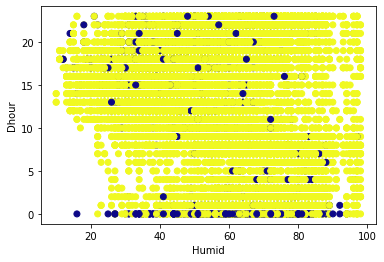

Humid Dmin


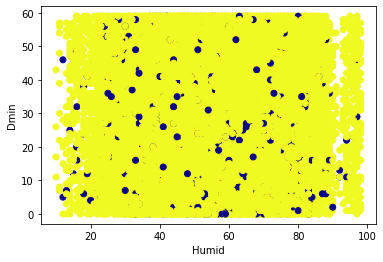

Humid DDweek


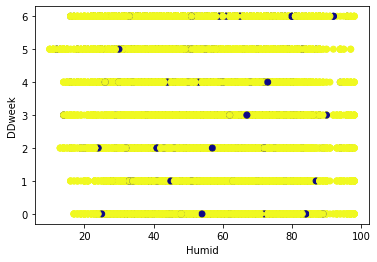

Humid Temp


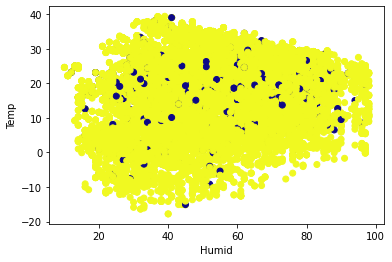

Humid Precip


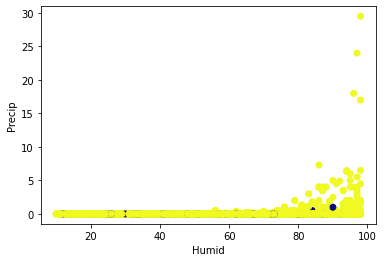

Humid Wind


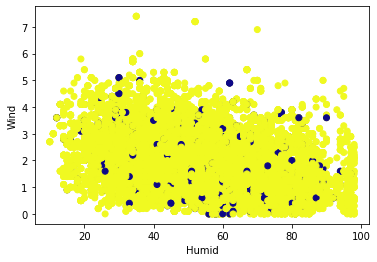

Humid Humid


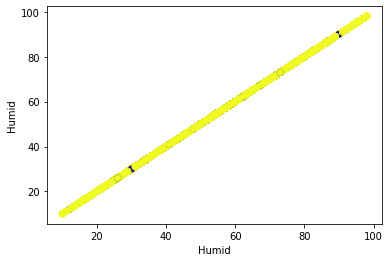

Humid Solar


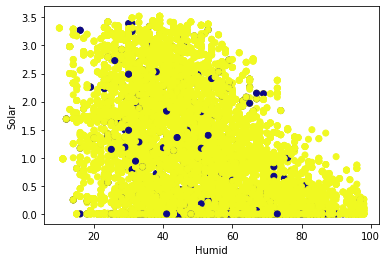

Humid Snow


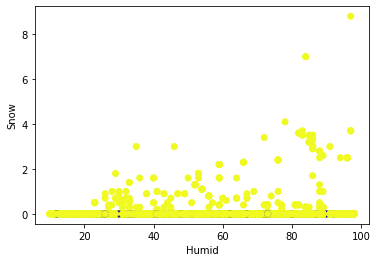

Humid GroundTemp


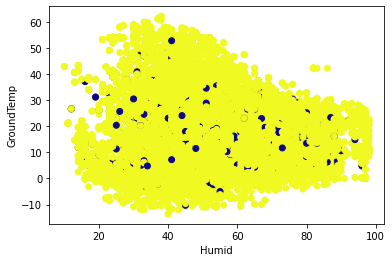

Humid Dust


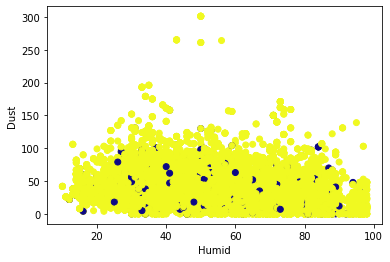

Solar Duration


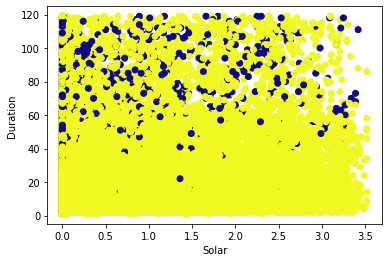

Solar PLong


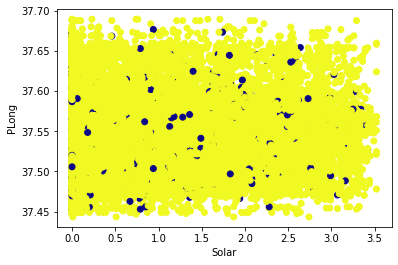

Solar PLatd


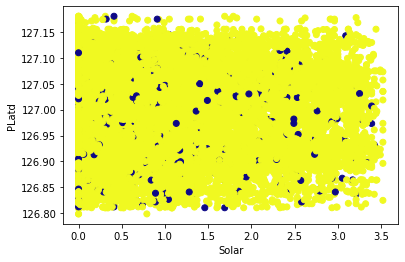

Solar DLong


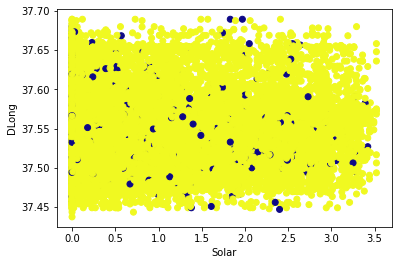

Solar DLatd


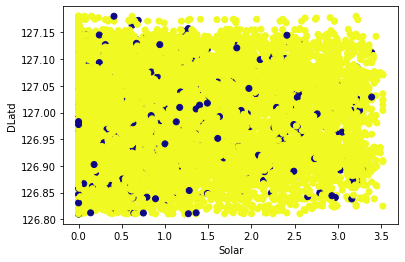

Solar Haversine


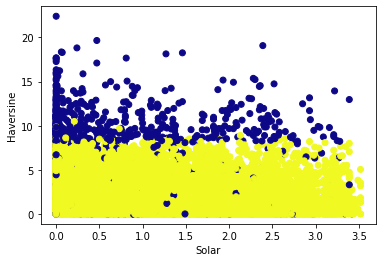

Solar Pmonth


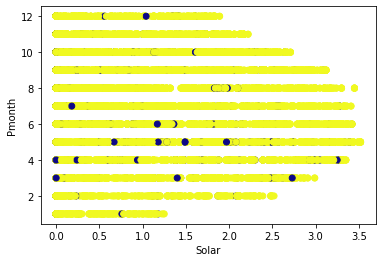

Solar Pday


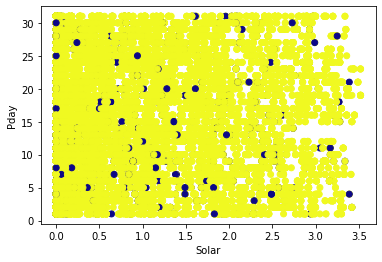

Solar Phour


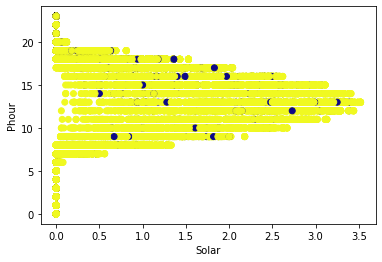

Solar Pmin


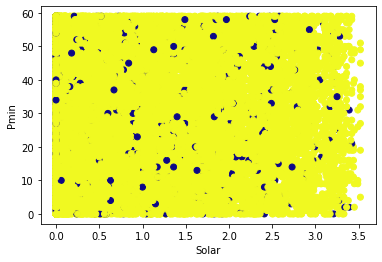

Solar PDweek


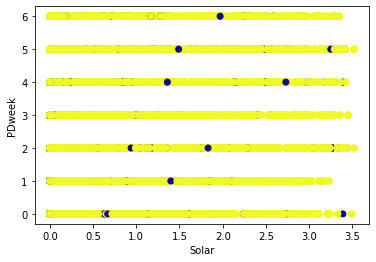

Solar Dmonth


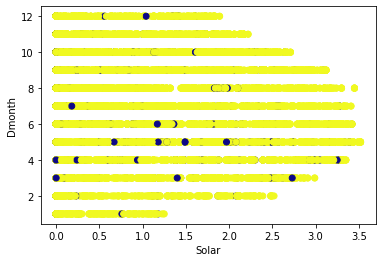

Solar Dday


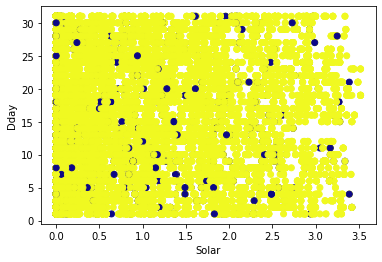

Solar Dhour


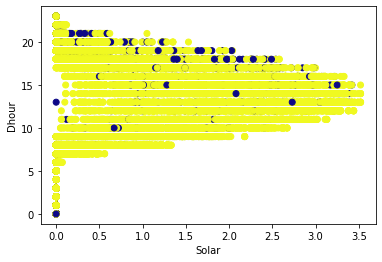

Solar Dmin


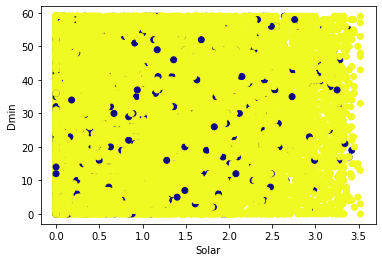

Solar DDweek


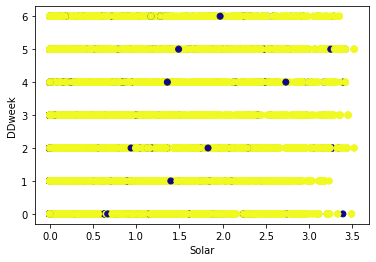

Solar Temp


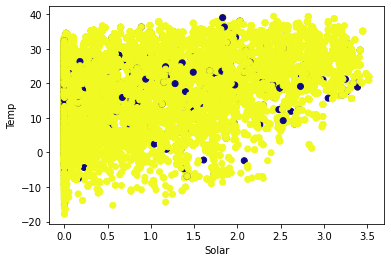

Solar Precip


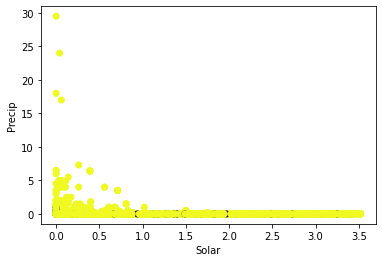

Solar Wind


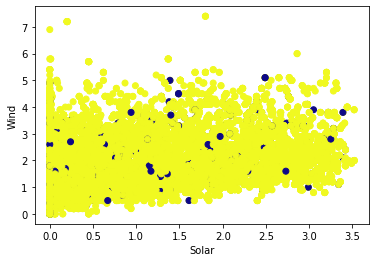

Solar Humid


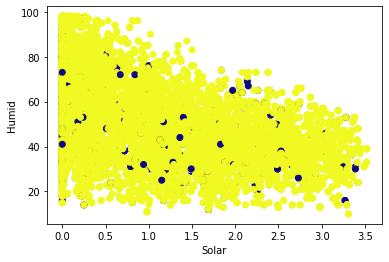

Solar Solar


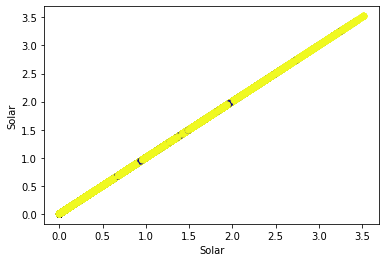

Solar Snow


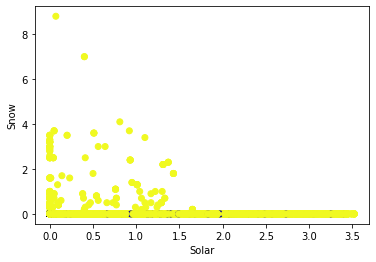

Solar GroundTemp


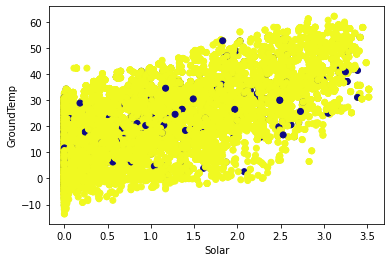

Solar Dust


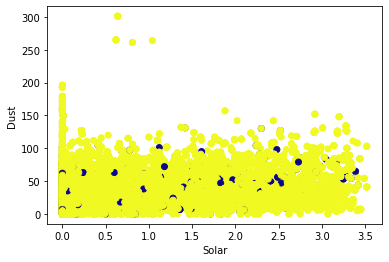

Snow Duration


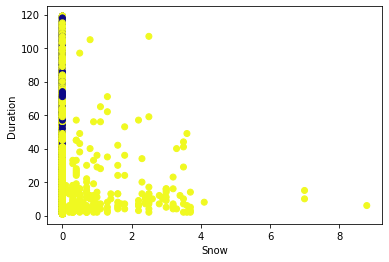

Snow PLong


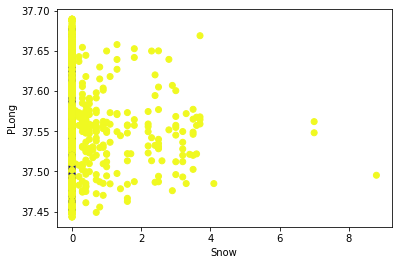

Snow PLatd


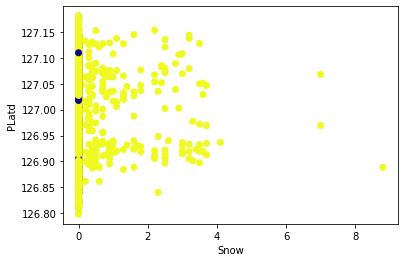

Snow DLong


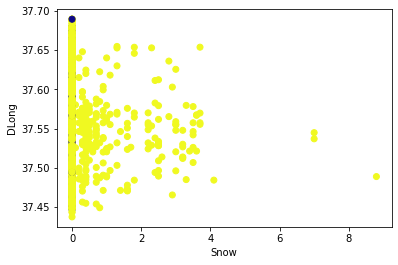

Snow DLatd


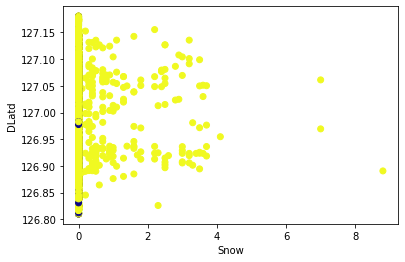

Snow Haversine


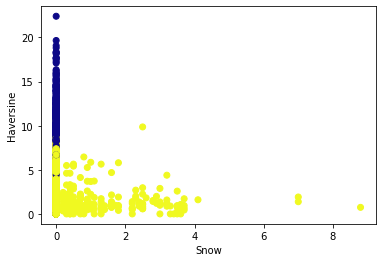

Snow Pmonth


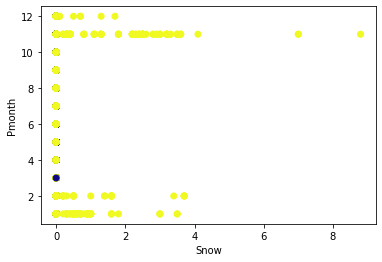

Snow Pday


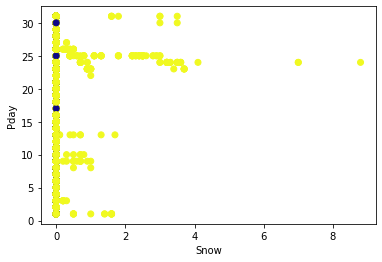

Snow Phour


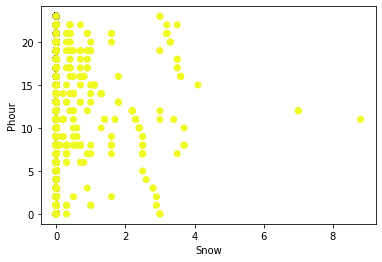

Snow Pmin


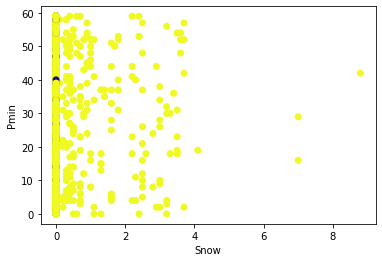

Snow PDweek


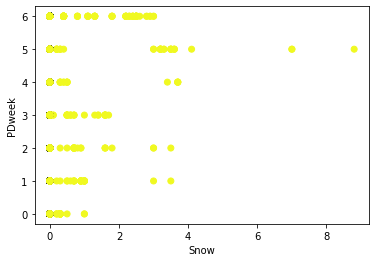

Snow Dmonth


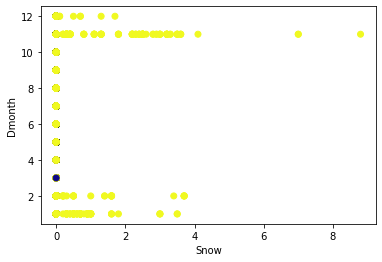

Snow Dday


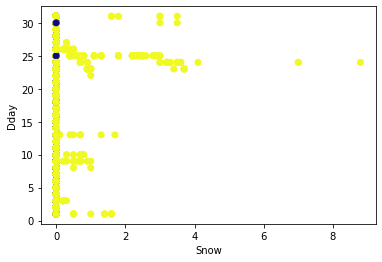

Snow Dhour


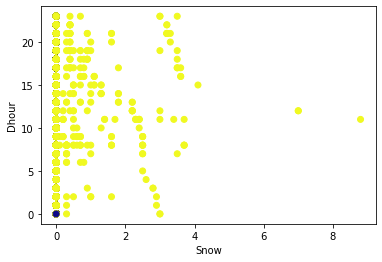

Snow Dmin


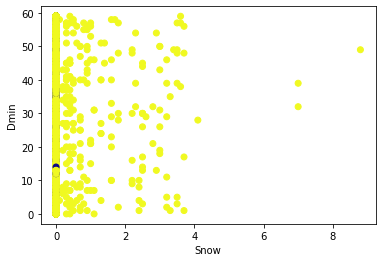

Snow DDweek


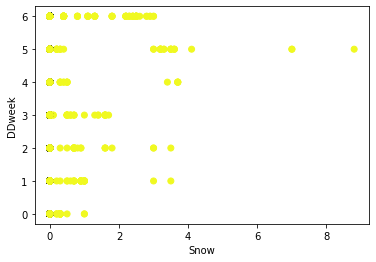

Snow Temp


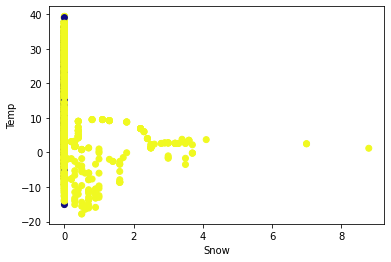

Snow Precip


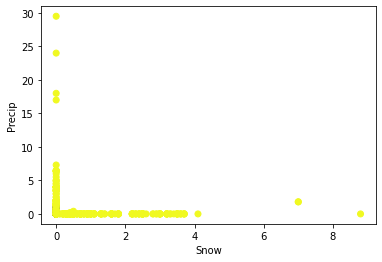

Snow Wind


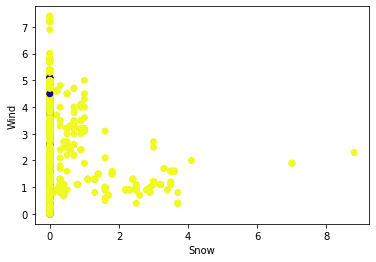

Snow Humid


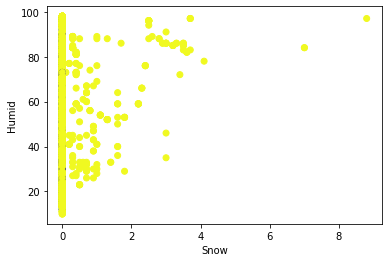

Snow Solar


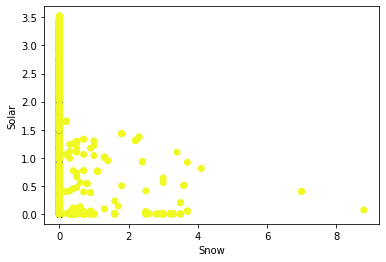

Snow Snow


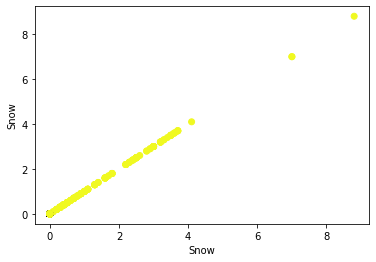

Snow GroundTemp


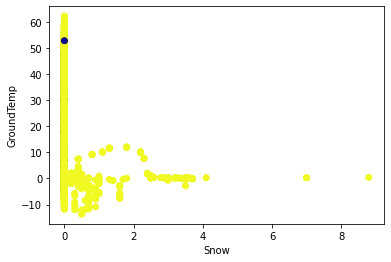

Snow Dust


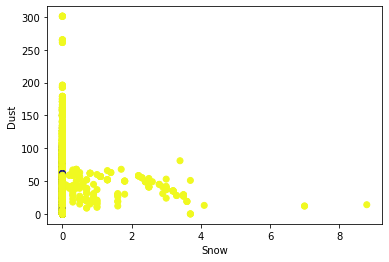

GroundTemp Duration


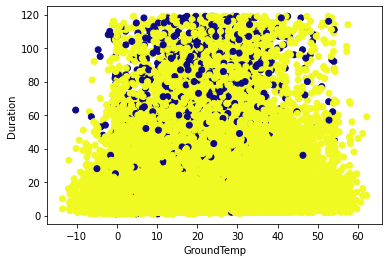

GroundTemp PLong


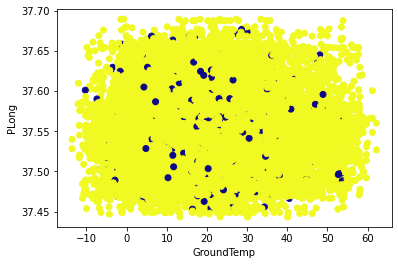

GroundTemp PLatd


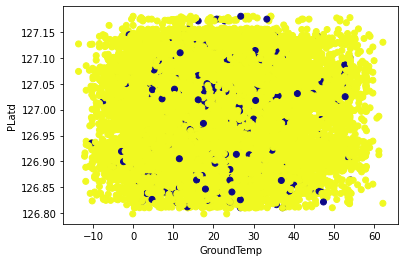

GroundTemp DLong


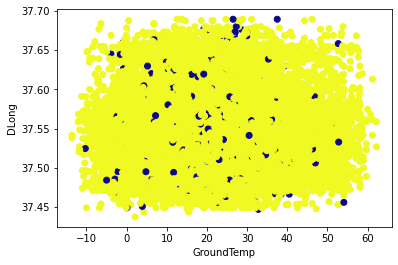

GroundTemp DLatd


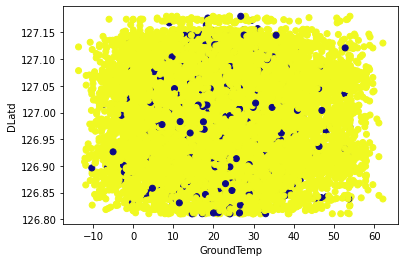

GroundTemp Haversine


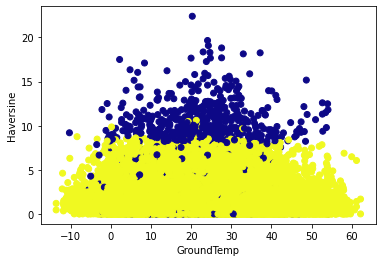

GroundTemp Pmonth


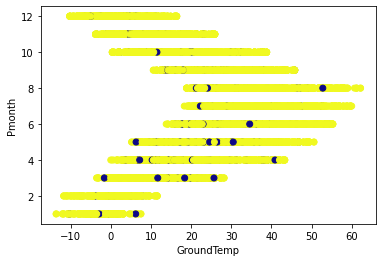

GroundTemp Pday


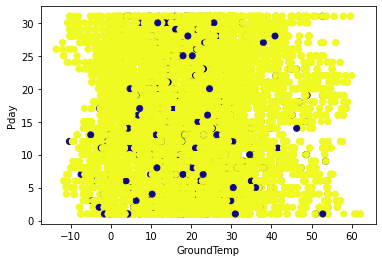

GroundTemp Phour


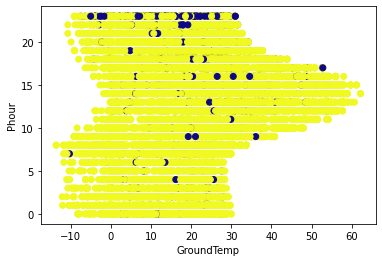

GroundTemp Pmin


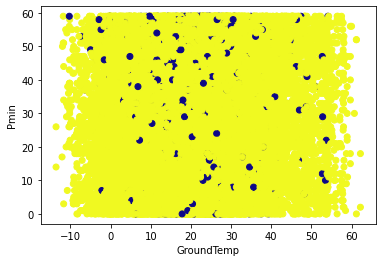

GroundTemp PDweek


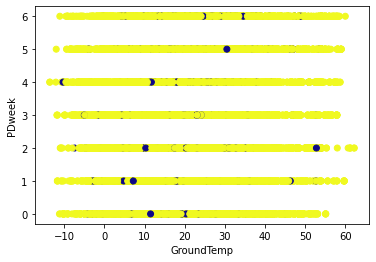

GroundTemp Dmonth


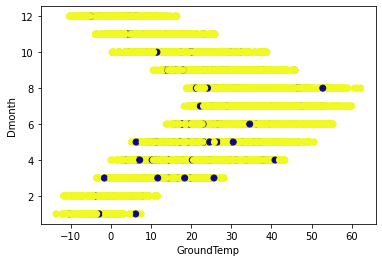

GroundTemp Dday


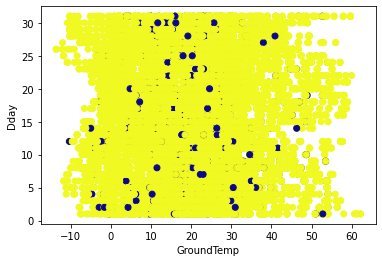

GroundTemp Dhour


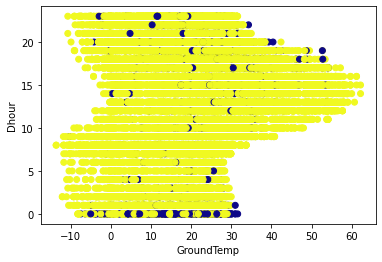

GroundTemp Dmin


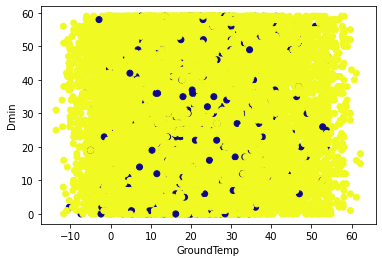

GroundTemp DDweek


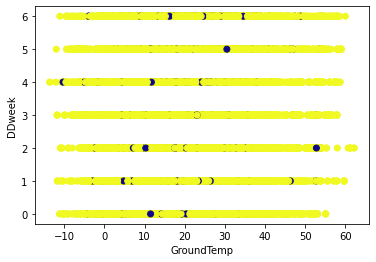

GroundTemp Temp


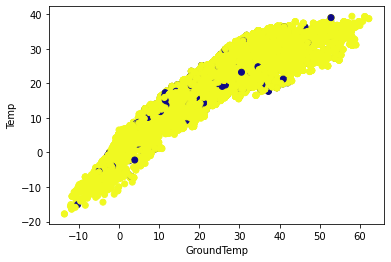

GroundTemp Precip


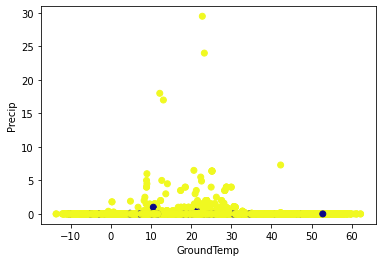

GroundTemp Wind


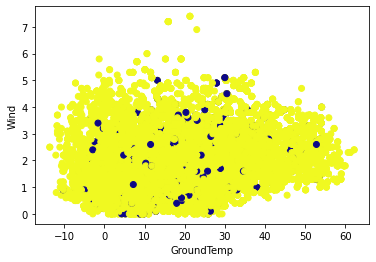

GroundTemp Humid


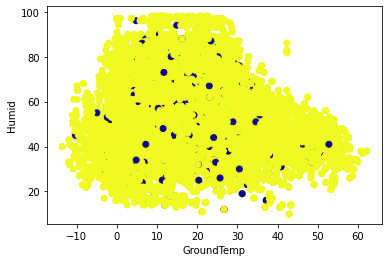

GroundTemp Solar


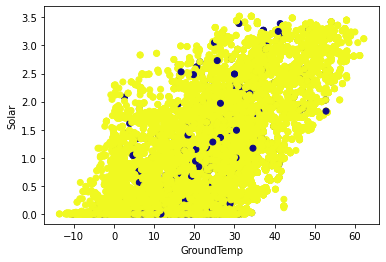

GroundTemp Snow


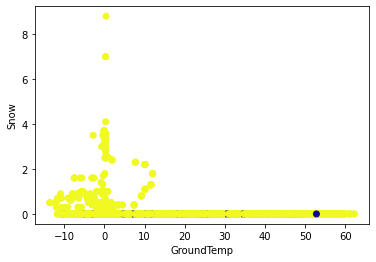

GroundTemp GroundTemp


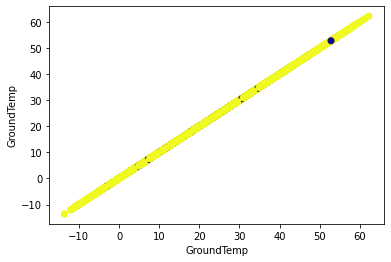

GroundTemp Dust


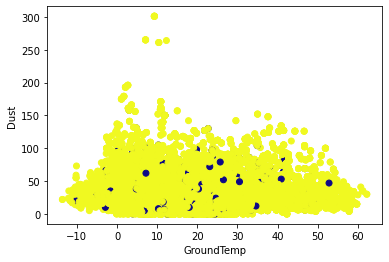

Dust Duration


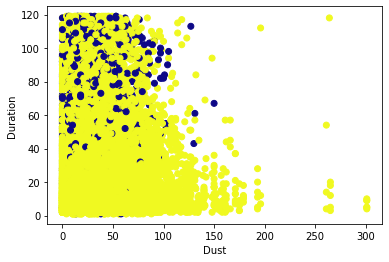

Dust PLong


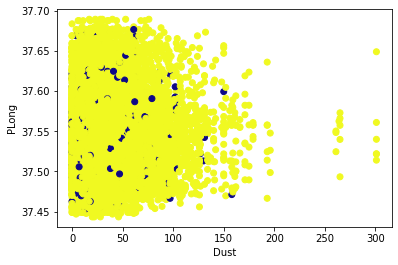

Dust PLatd


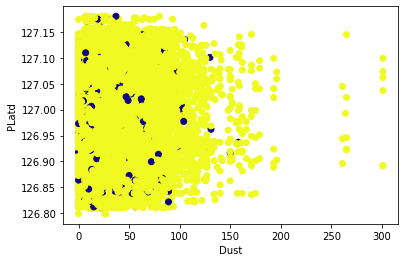

Dust DLong


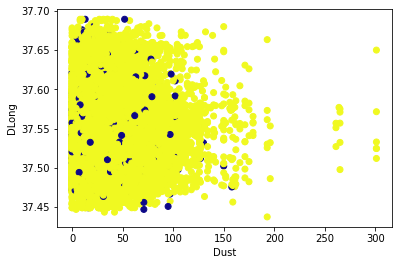

Dust DLatd


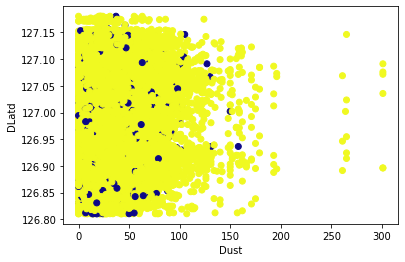

Dust Haversine


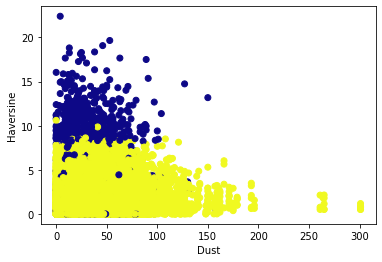

Dust Pmonth


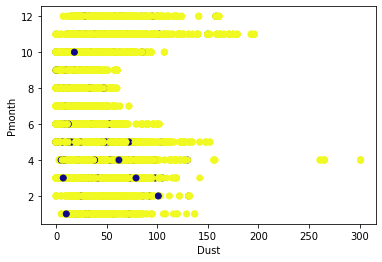

Dust Pday


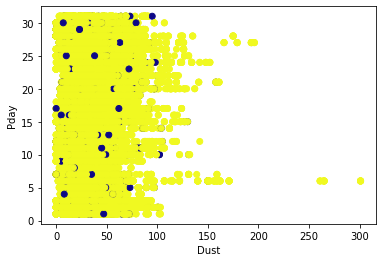

Dust Phour


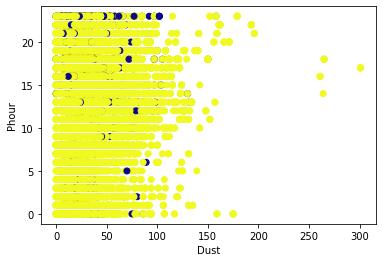

Dust Pmin


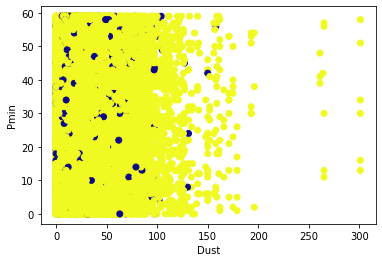

Dust PDweek


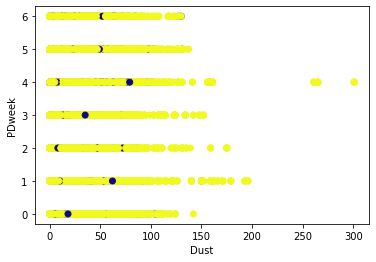

Dust Dmonth


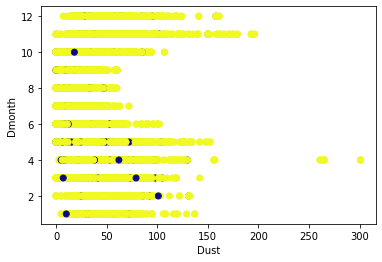

Dust Dday


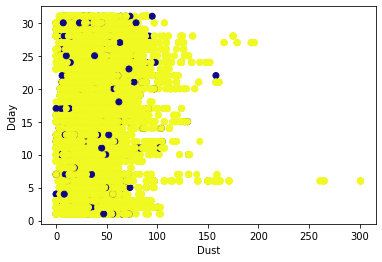

Dust Dhour


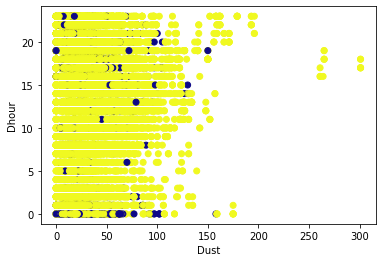

Dust Dmin


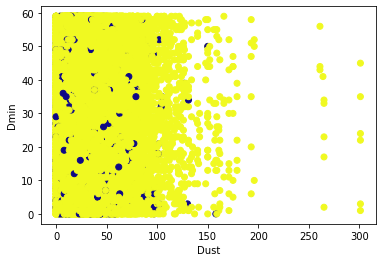

Dust DDweek


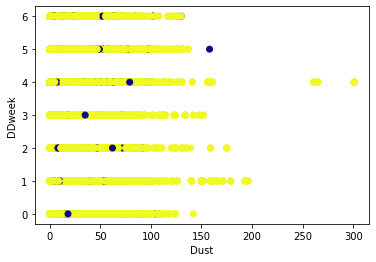

Dust Temp


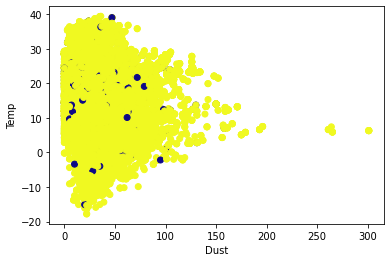

Dust Precip


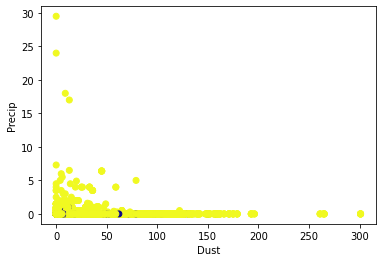

Dust Wind


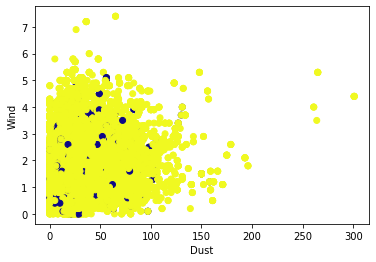

Dust Humid


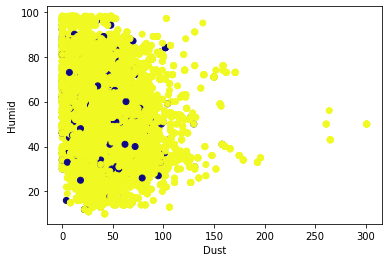

Dust Solar


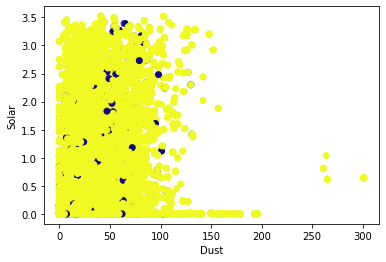

Dust Snow


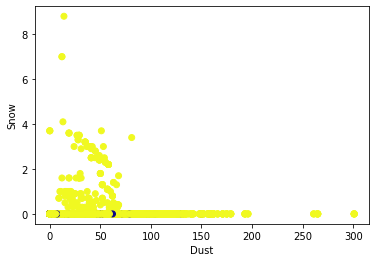

Dust GroundTemp


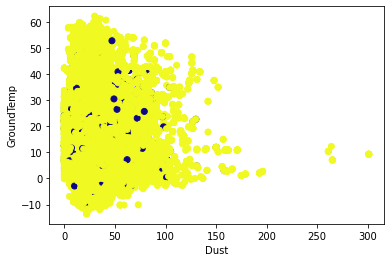

Dust Dust


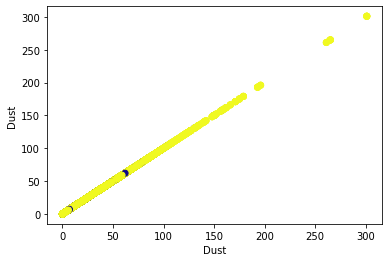

In [ ]:
for col1 in range(0, len(X.columns)):
  for col2 in range(0, len(X.columns)):
    print(X.columns[col1], X.columns[col2])
    plt.scatter(X[X.columns[col1]], X[X.columns[col2]], c = gm, cmap= "plasma") # plotting the clusters
    plt.xlabel(X.columns[col1]) # X-axis label
    plt.ylabel(X.columns[col2]) # Y-axis label
    plt.show()

## Prediction of Latitude and Longtitude with multiple output models

In [ ]:
X_multi = sample_dataset.drop(["DLong", "DLatd", "Haversine"], axis=1)
X_multi

,Duration,Distance,PLong,PLatd,Pmonth,Pday,Phour,Pmin,PDweek,Dmonth,...,Dmin,DDweek,Temp,Precip,Wind,Humid,Solar,Snow,GroundTemp,Dust
4686059,4,870,37.526989,126.932098,8,8,8,29,2,8,...,34,2,28.6,0.0,1.6,80.0,0.49,0.0,29.0,27.0
6762380,42,5910,37.535999,127.147697,9,29,19,48,5,9,...,31,5,22.5,0.0,0.4,43.0,0.00,0.0,19.4,24.0
491263,31,2740,37.550007,126.914825,3,14,21,20,2,3,...,53,2,16.8,0.0,2.0,67.0,0.00,0.0,12.4,21.0
6662859,41,7750,37.612774,127.006531,9,28,2,34,4,9,...,16,4,16.0,0.0,1.5,56.0,0.00,0.0,14.2,5.0
9554767,8,1280,37.519314,126.933167,12,27,7,32,3,12,...,41,3,-11.2,0.0,2.9,22.0,0.00,0.0,-7.5,22.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1766079,4,1070,37.548496,127.074760,5,13,23,28,6,5,...,33,6,13.0,0.0,1.3,89.0,0.00,0.0,11.7,41.0
7985987,8,1120,37.537010,127.082245,10,25,18,53,3,10,...,2,3,17.3,0.0,1.3,39.0,0.03,0.0,14.1,40.0
4789579,17,2710,37.518970,126.869965,8,11,12,17,5,8,...,35,5,33.2,0.0,2.3,50.0,2.84,0.0,54.0,6.0
6914336,28,3410,37.577202,126.902351,10,2,18,34,1,10,...,4,1,19.2,0.0,2.2,48.0,0.28,0.0,18.9,27.0


In [ ]:
## ne kadar mesafe yolculuk edebilecegini bir sekilde tahmin edebilirsem aslinda gidecegi yeri de tahmin edebilirim

In [ ]:
## scale etmek zorundayiz yoksa koordinatlara arasi sayisal deger fazla olmadigi icin hatasiz bulur gibi olur

In [ ]:
y_multi = sample_dataset[["DLong", "DLatd"]]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_multi, y_multi, test_size=0.3, random_state=2)

In [ ]:
sc = StandardScaler()

X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

## Linear Regression for Multi-output Regression

In [ ]:
lr = LinearRegression()
lr.fit(X_train, y_train)

LinearRegression()

In [ ]:
y_pred_multi_lr = lr.predict(X_test)

In [ ]:
#Evaluation metrics for Linear Regression on test data
MSE = mean_squared_error((y_test),(y_pred_multi_lr))
print("MSE :",MSE)

RMSE = np.sqrt(MSE)
print('RMSE :',RMSE)

lr_r2 = r2_score(y_test,y_pred_multi_lr)
print('R2:',lr_r2)
print("Adjusted R2 :",1-(1-r2_score(y_test, y_pred_multi_lr))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

MSE : 0.00039865665328799943
RMSE : 0.01996638808818459
R2: 0.8918071987070713
Adjusted R2 : 0.8917244968680648


In [ ]:
print("Model\t\t\t\t\t\t\t\t RMSE \t\t MSE \t\t MAE \t\t R2")
print("""Linear Regression for Multi-output Regression Regressor \t {:.2f} \t\t {:.2f} \t\t{:.2f} \t\t{:.2f}""".format(
            np.sqrt(mean_squared_error(y_test, y_pred_multi_lr)),mean_squared_error(y_test, y_pred_multi_lr),
            mean_absolute_error(y_test, y_pred_multi_lr), r2_score(y_test, y_pred_multi_lr)))

Model								 RMSE 		 MSE 		 MAE 		 R2
Linear Regression for Multi-output Regression Regressor 	 0.02 		 0.00 		0.01 		0.89


## k-Nearest Neighbors for Multi-output Regression

In [ ]:
knn = KNeighborsRegressor()
knn.fit(X_train, y_train)

KNeighborsRegressor()

In [ ]:
y_pred_multi_knn = lr.predict(X_test)

In [ ]:
#Evaluation metrics for Linear Regression on test data
MSE = mean_squared_error((y_test),(y_pred_multi_knn))
print("MSE :",MSE)

RMSE = np.sqrt(MSE)
print('RMSE :',RMSE)

knn_r2 = r2_score(y_test,y_pred_multi_knn)
print('R2:',knn_r2)
print("Adjusted R2 :",1-(1-r2_score(y_test, y_pred_multi_knn))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

MSE : 0.00039865665328799943
RMSE : 0.01996638808818459
R2: 0.8918071987070713
Adjusted R2 : 0.8917244968680648


In [ ]:
print("Model\t\t\t\t\t\t\t\t RMSE \t\t MSE \t\t MAE \t\t R2")
print("""Linear Regression for Multi-output Regression Regressor \t {:.2f} \t\t {:.2f} \t\t{:.2f} \t\t{:.2f}""".format(
            np.sqrt(mean_squared_error(y_test, y_pred_multi_knn)),mean_squared_error(y_test, y_pred_multi_knn),
            mean_absolute_error(y_test, y_pred_multi_knn), r2_score(y_test, y_pred_multi_knn)))

Model								 RMSE 		 MSE 		 MAE 		 R2
Linear Regression for Multi-output Regression Regressor 	 0.02 		 0.00 		0.01 		0.89


## Decision Tree for Multi-output Regression

In [ ]:
dt_model = DecisionTreeRegressor()

In [ ]:
dt_model.fit(X_train, y_train)

DecisionTreeRegressor()

In [ ]:
y_pred_multi_dt = dt_model.predict(X_test)
y_pred_multi_dt

array([[ 37.50938 , 126.963615],
       [ 37.477852, 127.03891 ],
       [ 37.54707 , 127.074272],
       ...,
       [ 37.529675, 127.119789],
       [ 37.559967, 126.962463],
       [ 37.569939, 126.977539]])

In [ ]:
#Evaluation metrics for Linear Regression on test data
MSE = mean_squared_error((y_test),(y_pred_multi_dt))
print("MSE :",MSE)

RMSE = np.sqrt(MSE)
print('RMSE :',RMSE)

dt_r2 = r2_score(y_test,y_pred_multi_dt)
print('R2:',dt_r2)
print("Adjusted R2 :",1-(1-r2_score(y_test, y_pred_multi_dt))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

MSE : 0.0006615504676513007
RMSE : 0.025720623391576276
R2: 0.8218235076280967
Adjusted R2 : 0.8216873107331945


In [ ]:
print("Model\t\t\t\t RMSE \t\t MSE \t\t MAE \t\t R2")
print("""Decision Tree Regressor \t {:.2f} \t\t {:.2f} \t\t{:.2f} \t\t{:.2f}""".format(
            np.sqrt(mean_squared_error(y_test, y_pred_multi)),mean_squared_error(y_test, y_pred_multi),
            mean_absolute_error(y_test, y_pred_multi), r2_score(y_test, y_pred_multi)))

Model				 RMSE 		 MSE 		 MAE 		 R2
Decision Tree Regressor 	 0.03 		 0.00 		0.02 		0.82


Text(0.5, 0, 'Variable Severity Levels')

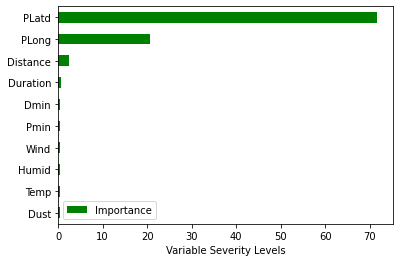

In [ ]:
Importance = pd.DataFrame({"Importance":dt.feature_importances_*100}, index=X_multi.columns)
Importance.sort_values(by='Importance', axis=0, ascending=True).iloc[-10:,:].plot(kind='barh', color='green')
plt.xlabel("Variable Severity Levels")

## Evaluate Multioutput Regression With Cross-Validation

In [ ]:
from sklearn.model_selection import RepeatedKFold, cross_val_score

cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)

In [ ]:
n_scores = cross_val_score(dt, X, y, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)

In [ ]:
from numpy import mean, std, absolute

n_scores = absolute(n_scores)
# summarize performance
print('MAE: %.3f (%.3f)' % (mean(n_scores), std(n_scores)))

MAE: 1378.806 (41.009)


In [ ]:
## not: distance'i bilirsem nereye gidecegini biliyorum

In [ ]:
# once distance tahmin et y_pred_distance
# sonra
# X["disntace"] = y_pred_distance de
# daha sonra bu modelle tahmin yap

# Duration Prediction

In [ ]:
sample = df.sample(frac=0.003, replace=True, random_state=1)
sample

,Duration,Distance,PLong,PLatd,DLong,DLatd,Haversine,Pmonth,Pday,Phour,...,Dmin,DDweek,Temp,Precip,Wind,Humid,Solar,Snow,GroundTemp,Dust
4686059,4,870,37.526989,126.932098,37.528816,126.924530,0.697612,8,8,8,...,34,2,28.6,0.0,1.6,80.0,0.49,0.0,29.0,27.0
6762380,42,5910,37.535999,127.147697,37.514240,127.123070,3.251248,9,29,19,...,31,5,22.5,0.0,0.4,43.0,0.00,0.0,19.4,24.0
491263,31,2740,37.550007,126.914825,37.534718,126.900002,2.144340,3,14,21,...,53,2,16.8,0.0,2.0,67.0,0.00,0.0,12.4,21.0
6662859,41,7750,37.612774,127.006531,37.638805,127.028358,3.474671,9,28,2,...,16,4,16.0,0.0,1.5,56.0,0.00,0.0,14.2,5.0
9554767,8,1280,37.519314,126.933167,37.526066,126.925537,1.008200,12,27,7,...,41,3,-11.2,0.0,2.9,22.0,0.00,0.0,-7.5,22.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017999,39,4680,37.486061,126.852013,37.486061,126.852013,0.000000,4,14,16,...,59,5,8.9,0.0,1.8,87.0,0.32,0.0,11.8,6.0
761543,3,760,37.533764,127.138031,37.535473,127.145172,0.657716,4,1,8,...,33,6,12.9,0.0,1.5,64.0,0.06,0.0,11.5,55.0
7888925,12,2810,37.551849,127.088982,37.540089,127.073746,1.874639,10,23,18,...,59,1,14.5,0.0,2.1,71.0,0.06,0.0,13.6,0.0
5984805,15,2530,37.501652,127.128181,37.484531,127.120163,2.030946,9,12,14,...,48,2,26.9,0.0,1.6,45.0,2.27,0.0,39.5,18.0


In [ ]:
X = sample.drop(["Duration"], axis=1)
y = sample["Duration"]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 0, test_size = 0.2)

### Linear Regression to predict Duration

In [ ]:
lr_duration = LinearRegression()
lr_duration.fit(X_train, y_train)

LinearRegression()

In [ ]:
y_pred_lr_duration = lr_duration.predict(X_test)

In [ ]:
print("Model\t\t\t RMSE \t\t MSE \t\t MAE \t\t R2")
print("""LinearRegression \t {:.2f} \t\t {:.2f} \t{:.2f} \t\t{:.2f}""".format(
            np.sqrt(mean_squared_error(y_test, y_pred_lr_duration)),mean_squared_error(y_test, y_pred_lr_duration),
            mean_absolute_error(y_test, y_pred_lr_duration), r2_score(y_test, y_pred_lr_duration)))

Model			 RMSE 		 MSE 		 MAE 		 R2
LinearRegression 	 13.13 		 172.45 	4.81 		0.72


### XGBooster to Predict Duration

In [ ]:
xgb = xg.XGBRegressor(learning_rate=0.2, max_depth=3, n_estimators=200, n_jobs=1, objective='reg:linear')
xgb_model = xgb.fit(X_train, y_train)
y_pred_xgb = xgb_model.predict(X_test)

[18:00:53] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


In [ ]:
print("Model\t\t\t\t RMSE \t\t MSE \t\t MAE \t\t R2")
print("""XGBooster Regressor \t\t {:.2f} \t\t {:.2f} \t\t{:.2f} \t\t{:.2f}""".format(
            np.sqrt(mean_squared_error(y_test, y_pred_xgb)),mean_squared_error(y_test, y_pred_xgb),
            mean_absolute_error(y_test, y_pred_xgb), r2_score(y_test, y_pred_xgb)))

Model				 RMSE 		 MSE 		 MAE 		 R2
XGBooster Regressor 		 9.79 		 95.78 		5.81 		0.85


# Data Manipulation

In [ ]:
df.columns

Index(['Duration', 'Distance', 'PLong', 'PLatd', 'DLong', 'DLatd', 'Haversine',
       'Pmonth', 'Pday', 'Phour', 'Pmin', 'PDweek', 'Dmonth', 'Dday', 'Dhour',
       'Dmin', 'DDweek', 'Temp', 'Precip', 'Wind', 'Humid', 'Solar', 'Snow',
       'GroundTemp', 'Dust'],
      dtype='object')

In [ ]:
# df["Pyear"] = 2020
# df2 = df[["Pyear" ,"Pmonth", "Pday"]].copy()
# df2.columns = ["year", "month", "day"]
# date = pd.to_datetime(df2[["year", "month", "day"]])
# df["date"] = date

In [ ]:
df_date = df.drop(['Haversine', 'Pmin', 'PDweek', 'Dmonth', 'Dday', 'Dhour','Dmin', 'DDweek'], axis=1)

In [ ]:
df_date

,Duration,Distance,PLong,PLatd,DLong,DLatd,Pmonth,Pday,Phour,Temp,Precip,Wind,Humid,Solar,Snow,GroundTemp,Dust
0,3,50,37.544666,126.888359,37.544666,126.888359,1,1,0,-3.2,0.0,0.5,40.0,0.0,0.0,-2.2,25.0
1,24,7670,37.506199,127.003944,37.551250,127.035103,1,1,0,-3.2,0.0,0.5,40.0,0.0,0.0,-2.2,25.0
2,8,1390,37.544590,127.057083,37.537014,127.061096,1,1,0,-3.2,0.0,0.5,40.0,0.0,0.0,-2.2,25.0
3,8,1820,37.571102,127.023560,37.561447,127.034920,1,1,0,-3.2,0.0,0.5,40.0,0.0,0.0,-2.2,25.0
4,4,850,37.573242,127.015907,37.565849,127.016403,1,1,0,-3.2,0.0,0.5,40.0,0.0,0.0,-2.2,25.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9601134,67,6930,37.562607,127.051308,37.562607,127.051308,12,31,23,-5.2,0.0,1.6,47.0,0.0,0.0,-5.1,53.0
9601135,58,8320,37.511982,127.085052,37.476028,127.105942,12,31,23,-5.2,0.0,1.6,47.0,0.0,0.0,-5.1,53.0
9601136,118,2730,37.506199,127.003944,37.514870,127.015282,12,31,22,-5.4,0.0,1.3,46.0,0.0,0.0,-5.0,49.0
9601137,90,17170,37.489750,126.927467,37.565903,126.901184,12,31,23,-5.2,0.0,1.6,47.0,0.0,0.0,-5.1,53.0


In [ ]:
df_hourly_counted = df.groupby(['Pmonth', 'Pday', 'Phour', 'Temp', 'Precip', 'Wind', 'Humid', 'Solar', 'Snow','GroundTemp', 'Dust'])['Duration'].agg('count').reset_index(name="count")
df_hourly_counted

,Pmonth,Pday,Phour,Temp,Precip,Wind,Humid,Solar,Snow,GroundTemp,Dust,count
0,1,1,0,-3.2,0.0,0.5,40.0,0.0,0.0,-2.2,25.0,252
1,1,1,1,-3.3,0.0,0.7,41.0,0.0,0.0,-2.7,39.0,284
2,1,1,2,-3.7,0.0,0.9,42.0,0.0,0.0,-3.0,30.0,216
3,1,1,3,-4.0,0.0,1.0,44.0,0.0,0.0,-3.5,33.0,139
4,1,1,4,-4.2,0.0,1.1,53.0,0.0,0.0,-3.8,35.0,78
...,...,...,...,...,...,...,...,...,...,...,...,...
8733,12,31,19,-3.1,0.0,2.1,43.0,0.0,0.0,-2.2,55.0,613
8734,12,31,20,-3.7,0.0,0.8,39.0,0.0,0.0,-3.0,36.0,491
8735,12,31,21,-4.6,0.0,1.1,44.0,0.0,0.0,-4.1,38.0,510
8736,12,31,22,-5.4,0.0,1.3,46.0,0.0,0.0,-5.0,49.0,450


In [ ]:
df_hourly_counted.describe()

,Pmonth,Pday,Phour,Temp,Precip,Wind,Humid,Solar,Snow,GroundTemp,Dust,count
count,8738.000000,8738.000000,8738.000000,8738.000000,8738.000000,8738.000000,8738.000000,8738.000000,8738.000000,8738.000000,8738.000000,8738.000000
mean,6.524147,15.733005,11.499084,12.976745,0.144553,1.730762,57.433623,0.580575,0.044381,14.594919,34.171550,1098.779927
std,3.450917,8.802788,6.922059,11.875867,1.118596,1.034295,20.300456,0.874234,0.347487,14.297580,25.460641,1056.352230
min,1.000000,1.000000,0.000000,-17.800000,0.000000,0.000000,10.000000,0.000000,0.000000,-13.600000,0.000000,1.000000
25%,4.000000,8.000000,6.000000,3.700000,0.000000,1.000000,42.000000,0.000000,0.000000,2.125000,16.000000,284.000000
50%,7.000000,16.000000,11.000000,13.700000,0.000000,1.500000,56.000000,0.010000,0.000000,13.600000,29.000000,781.000000
75%,10.000000,23.000000,17.000000,22.500000,0.000000,2.300000,73.000000,0.980000,0.000000,24.000000,46.000000,1572.750000
max,12.000000,31.000000,23.000000,39.400000,35.000000,7.400000,98.000000,3.520000,8.800000,62.200000,304.000000,10035.000000


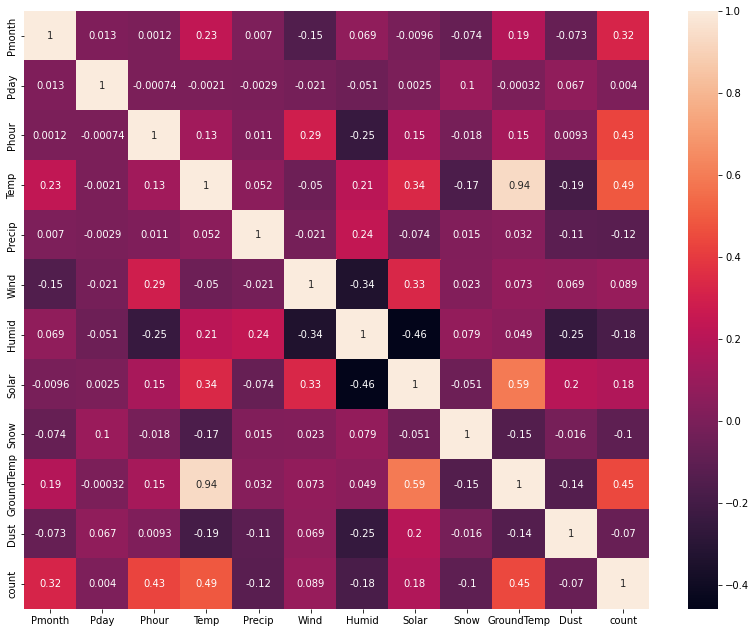

In [ ]:
#get correlations of each features in dataset
#plot heat map
plt.figure(figsize=(14,11))
g=sns.heatmap(df_hourly_counted.corr(),annot=True)

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


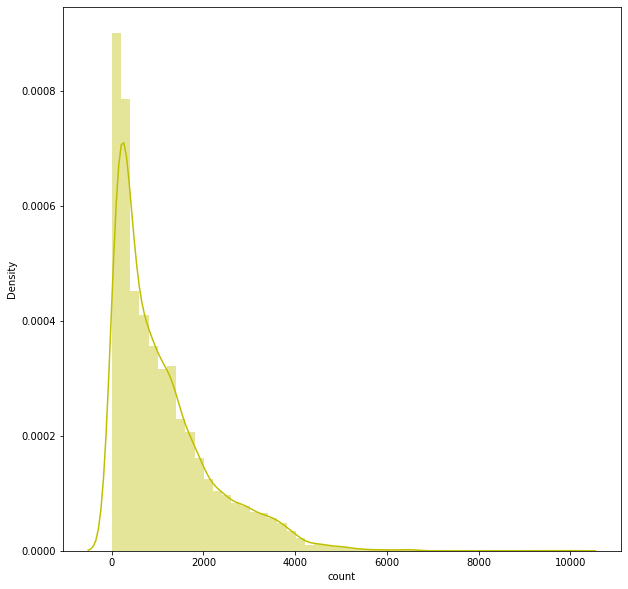

In [ ]:
plt.figure(figsize=(10,10))
sns.distplot(df_hourly_counted['count'],color="y")

In [ ]:
df_hourly_counted['Month_name']=df_hourly_counted['Pmonth'].map({1:'January',2:'February',3:'March',4:'April',5:'May',6:'June',7:'July',8:'August',9:'September',10:'October',11:'November',12:'December'})

In [ ]:
df_hourly_counted

,Pmonth,Pday,Phour,Temp,Precip,Wind,Humid,Solar,Snow,GroundTemp,Dust,count,Month_name
0,1,1,0,-3.2,0.0,0.5,40.0,0.0,0.0,-2.2,25.0,252,January
1,1,1,1,-3.3,0.0,0.7,41.0,0.0,0.0,-2.7,39.0,284,January
2,1,1,2,-3.7,0.0,0.9,42.0,0.0,0.0,-3.0,30.0,216,January
3,1,1,3,-4.0,0.0,1.0,44.0,0.0,0.0,-3.5,33.0,139,January
4,1,1,4,-4.2,0.0,1.1,53.0,0.0,0.0,-3.8,35.0,78,January
...,...,...,...,...,...,...,...,...,...,...,...,...,...
8733,12,31,19,-3.1,0.0,2.1,43.0,0.0,0.0,-2.2,55.0,613,December
8734,12,31,20,-3.7,0.0,0.8,39.0,0.0,0.0,-3.0,36.0,491,December
8735,12,31,21,-4.6,0.0,1.1,44.0,0.0,0.0,-4.1,38.0,510,December
8736,12,31,22,-5.4,0.0,1.3,46.0,0.0,0.0,-5.0,49.0,450,December


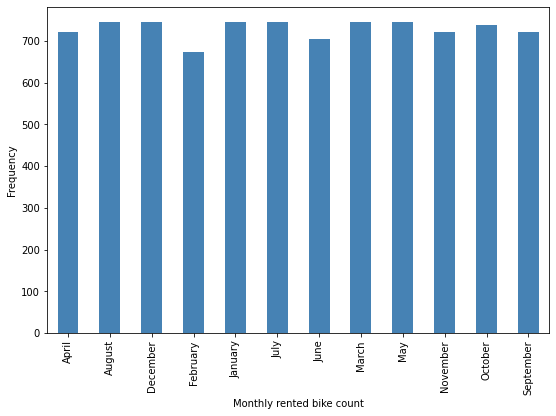

In [ ]:
counts = df_hourly_counted["Month_name"].value_counts().sort_index()
fig = plt.figure(figsize=(9, 6))
ax = fig.gca()
counts.plot.bar(ax = ax, color='steelblue')
# ax.set_title(col + ' counts')
ax.set_xlabel("Monthly rented bike count") 
ax.set_ylabel("Frequency")
plt.show()

In [ ]:
X = df_hourly_counted.drop(['Month_name', 'count'], axis=1)
y = df_hourly_counted['count']

In [ ]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state = 24)

In [ ]:
sc = StandardScaler()

X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

## Linear Regression to Predict Count

In [ ]:
reg = LinearRegression().fit(X_train,y_train)

In [ ]:
y_pred_train = reg.predict(X_train)
y_pred_test = reg.predict(X_test)

In [ ]:
#metrics for linear regression analysis for train dataset
MSE = mean_squared_error((y_train),(y_pred_train))
print("MSE :",MSE)

RMSE = np.sqrt(MSE)
print('RMSE :',RMSE)

r2 = r2_score(y_train,y_pred_train)
print('R2:',r2)
print("Adjusted R2 :",1-(1-r2_score(y_train, y_pred_train))*((X_train.shape[0]-1)/(X_train.shape[0]-X_train.shape[1]-1)) )

MSE : 577986.7249855006
RMSE : 760.2543817601452
R2: 0.4938356623522716
Adjusted R2 : 0.49303775353683377


In [ ]:
#metrics for linear regression analysis for test dataset
MSE = mean_squared_error((y_test),(y_pred_test))
print("MSE :",MSE)

RMSE = np.sqrt(MSE)
print('RMSE :',RMSE)

r2 = r2_score(y_test,y_pred_test)
print('R2:',r2)
print("Adjusted R2 :",1-(1-r2_score(y_test, y_pred_test))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

MSE : 499039.70555562124
RMSE : 706.427424124815
R2: 0.5059140974793775
Adjusted R2 : 0.5027833688343736


## Decision Tree to Predict Count

In [ ]:
#importing the decision tree model for training 
decision_regressor = DecisionTreeRegressor(criterion='mse', max_depth=8,max_features=9, max_leaf_nodes=100,)
decision_regressor.fit(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py:363: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,


DecisionTreeRegressor(criterion='mse', max_depth=8, max_features=9,
                      max_leaf_nodes=100)

In [ ]:
#y pred for train/test data
y_pred_train_dt = decision_regressor.predict(X_train)
y_pred_test_dt = decision_regressor.predict(X_test)

In [ ]:
#Evaluation metrics for Decision Tree on train data
MSE = mean_squared_error((y_train),(y_pred_train_dt))
print("MSE :",MSE)

RMSE = np.sqrt(MSE)
print('RMSE :',RMSE)

r2 = r2_score(y_train,y_pred_train_dt)
print('R2:',r2)
print("Adjusted R2 :",1-(1-r2_score(y_train, y_pred_train_dt))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

MSE : 204213.7205694452
RMSE : 451.90012233838263
R2: 0.8211624970915992
Adjusted R2 : 0.8200293101492072


In [ ]:
#metric for decison tree for test data
from sklearn.metrics import mean_squared_error
MSE= mean_squared_error(y_test, y_pred_test_dt)
print("MSE :",MSE)

RMSE=np.sqrt(MSE)
print("RMSE :",RMSE)

from sklearn.metrics import r2_score
r2= r2_score((y_test), (y_pred_test_dt))
print("R2 :",r2)
print("Adjusted R2 :",1-(1-r2_score((y_test), (y_pred_test_dt)))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

MSE : 214579.7720899893
RMSE : 463.227559726307
R2 : 0.787550290737467
Adjusted R2 : 0.7862041232248588


## Random Forest to Predict Count

In [ ]:
#creating an instance for the random forest
rf_model=RandomForestRegressor()
rf_model.fit(X_train,y_train)

RandomForestRegressor()

In [ ]:
y_pred_train_rf = rf_model.predict(X_train)
y_pred_test_rf = rf_model.predict(X_test)

In [ ]:
#Evaluation metrics for Random Forest on train data
MSE = mean_squared_error((y_train),(y_pred_train_rf))
print("MSE :",MSE)

RMSE = np.sqrt(MSE)
print('RMSE :',RMSE)

r2 = r2_score(y_train,y_pred_train_rf)
print('R2:',r2)
print("Adjusted R2 :",1-(1-r2_score(y_train, y_pred_train_rf))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

MSE : 22049.141579599425
RMSE : 148.48953356920288
R2: 0.9806907517752784
Adjusted R2 : 0.9805684005480481


In [ ]:
#metric score for the rf for test dataset
print("Model Score:",rf_model.score(X_test,y_test))

MSE= mean_squared_error(y_test, y_pred_test_rf)
print("MSE :",MSE)

RMSE=np.sqrt(MSE)
print("RMSE :",RMSE)
from sklearn.metrics import r2_score
r2= r2_score(y_test, y_pred_test_rf)
print("R2 :",r2)
print("Adjusted R2 :",1-(1-r2_score(y_test, y_pred_test_rf))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

Model Score: 0.8710596444133729
MSE : 130233.13710818076
RMSE : 360.8782857255071
R2 : 0.8710596444133729
Adjusted R2 : 0.8702426260311996


Text(0.5, 0, 'Variable Severity Levels')

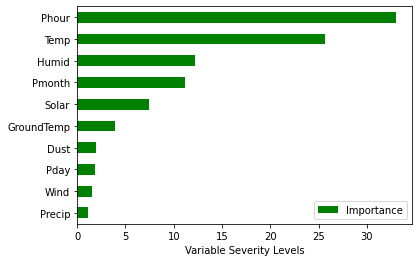

In [ ]:
Importance = pd.DataFrame({"Importance":rf_model.feature_importances_*100}, index=X.columns)
Importance.sort_values(by='Importance', axis=0, ascending=True).iloc[-10:,:].plot(kind='barh', color='green')
plt.xlabel("Variable Severity Levels")

## Running Grid Search Cross Validation for Random Forest Regressor

In [ ]:
# number of trees
n_estimators=[50,80,100]

#max deapth of tree
max_depth=[4,7,8]

#minimum no of sample required for spliting the node
min_samples_split=[50,100,150]

#minimum no of sample required at each leaf node
min_samples_leaf=[40,50]
#hyper parametr gride
param_dict = {'n_estimators' : n_estimators,
              'max_depth' : max_depth,
              'min_samples_split' : min_samples_split,
              'min_samples_leaf' : min_samples_leaf}

In [ ]:
# Create an instance of the RandomForestRegressor
rf_model = RandomForestRegressor()

# Grid search
rf_grid = GridSearchCV(estimator=rf_model,
                       param_grid = param_dict,
                       cv = 5, verbose=2)

rf_grid.fit(X_train,y_train)

Fitting 5 folds for each of 54 candidates, totalling 270 fits
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=50; total time=   1.2s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=50; total time=   1.2s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=50; total time=   1.4s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=50; total time=   0.8s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=50; total time=   0.6s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=80; total time=   1.0s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=80; total time=   1.0s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=80; total time=   1.0s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=80; total time=   1.0s
[CV] END max_depth=4, min_sam

GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid={'max_depth': [4, 7, 8], 'min_samples_leaf': [40, 50],
                         'min_samples_split': [50, 100, 150],
                         'n_estimators': [50, 80, 100]},
             verbose=2)

In [ ]:
rf_grid.best_estimator_

RandomForestRegressor(max_depth=8, min_samples_leaf=40, min_samples_split=50,
                      n_estimators=80)

In [ ]:
rf_optimal_model = rf_grid.best_estimator_

In [ ]:
rf_grid.best_params_

{'max_depth': 8,
 'min_samples_leaf': 40,
 'min_samples_split': 50,
 'n_estimators': 80}

In [ ]:
# Making predictions on train and test data

y_pred_train_r_g = rf_optimal_model.predict(X_train)
y_pred_test_r_g = rf_optimal_model.predict(X_test)

In [ ]:
#metrics for rf score with gd for train
from sklearn.metrics import mean_squared_error
print("Model Score:",rf_optimal_model.score(X_train,y_train))

MSE= mean_squared_error(y_train, y_pred_train_r_g)
print("MSE :",MSE)

RMSE=np.sqrt(MSE)
print("RMSE :",RMSE)


from sklearn.metrics import r2_score
r2= r2_score(y_train, y_pred_train_r_g)
print("R2 :",r2)
print("Adjusted R2 :",1-(1-r2_score(y_train, y_pred_train_r_g))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

Model Score: 0.8142965655161543
MSE : 212053.89620036425
RMSE : 460.49310114307275
R2 : 0.8142965655161543
Adjusted R2 : 0.8131198732469593


In [ ]:
#metrics for rf score with gd for test
from sklearn.metrics import mean_squared_error
print("Model Score:",rf_optimal_model.score(X_train,y_train))

MSE= mean_squared_error(y_test, y_pred_test_r_g)
print("MSE :",MSE)

RMSE=np.sqrt(MSE)
print("RMSE :",RMSE)


from sklearn.metrics import r2_score
r2= r2_score(y_test, y_pred_test_r_g)
print("R2 :",r2)
print("Adjusted R2 :",1-(1-r2_score(y_test, y_pred_test_r_g))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

Model Score: 0.8142965655161543
MSE : 196427.26990120756
RMSE : 443.20116189063356
R2 : 0.8055225990069381
Adjusted R2 : 0.8042903113278346


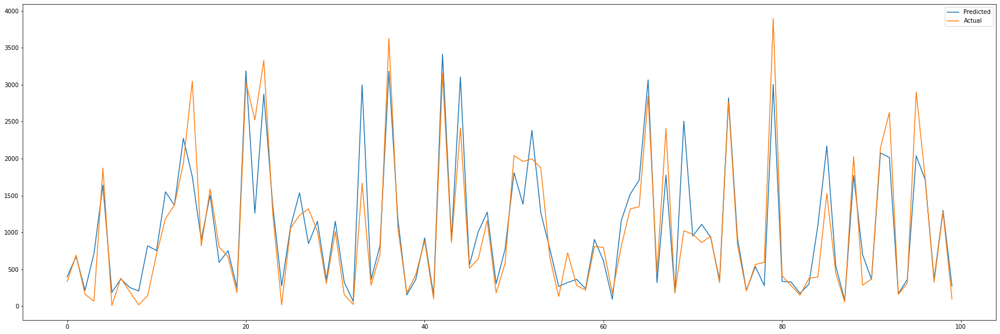

In [ ]:
plt.figure(figsize=(30,10))
plt.plot(np.array(y_pred_test_r_g[0:100]))
plt.plot(np.array(y_test[0:100]))
plt.legend(["Predicted","Actual"])
plt.show()

## Implementing Gradient Boosting Regression

---



In [ ]:
# gradient boosting model import
gbd_model=GradientBoostingRegressor()
gbd_model.fit(X_train,y_train)

GradientBoostingRegressor()

In [ ]:
# Making predictions on train and test data
y_pred_train_gb = gbd_model.predict(X_train)
y_pred_test_gb = gbd_model.predict(X_test)

In [ ]:
# for train data set
print("Model Score:",gbd_model.score(X_train,y_train))
MSE= mean_squared_error(y_train, y_pred_train_gb)
print("MSE :",MSE)

RMSE=np.sqrt(MSE)
print("RMSE :",RMSE)

r2= r2_score(y_train, y_pred_train_gb)
print("R2 :",r2)
print("Adjusted R2 :",1-(1-r2_score(y_train, y_pred_train_gb))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

Model Score: 0.8529559680394981
MSE : 167908.90258385462
RMSE : 409.7668881008501
R2 : 0.8529559680394981
Adjusted R2 : 0.8520242374222369


In [ ]:
# for test data set
print("Model Score:",gbd_model.score(X_train,y_train))
MSE= mean_squared_error(y_test, y_pred_test_gb)
print("MSE :",MSE)

RMSE=np.sqrt(MSE)
print("RMSE :",RMSE)

r2= r2_score((y_test), (y_pred_test_gb))
print("R2 :",r2)
print("Adjusted R2 :",1-(1-r2_score((y_test), (y_pred_test_gb)))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

Model Score: 0.8529559680394981
MSE : 158684.0088862202
RMSE : 398.351614639906
R2 : 0.8428911950826726
Adjusted R2 : 0.84189568998239


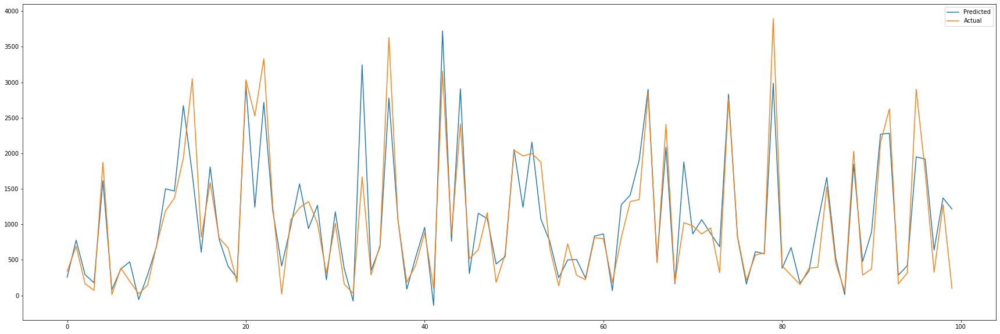

In [ ]:
plt.figure(figsize=(30,10))
plt.plot(np.array(y_pred_test_gb[0:100]))
plt.plot(np.array(y_test[0:100]))
plt.legend(["Predicted","Actual"])
plt.show()

## Implementing Multi Layer Perceptron Regression

In [ ]:
regr = MLPRegressor(random_state=1, max_iter=200).fit(X_train, y_train)

In [ ]:
# Making predictions on train and test data
y_pred_train_mlp = regr.predict(X_train)
y_pred_test_mlp = regr.predict(X_test)

In [ ]:
# for train data set
print("Model Score:",regr.score(X_train,y_train))
MSE= mean_squared_error(y_train, y_pred_train_mlp)
print("MSE :",MSE)

RMSE=np.sqrt(MSE)
print("RMSE :",RMSE)

r2= r2_score(y_train, y_pred_train_mlp)
print("R2 :",r2)
print("Adjusted R2 :",1-(1-r2_score(y_train, y_pred_train_mlp))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

Model Score: 0.6511976054845869
MSE : 219.87632192391337
RMSE : 14.828227200981019
R2 : 0.6511976054845869
Adjusted R2 : 0.6497381812397526


In [ ]:
# for test data set
print("Model Score:",regr.score(X_train,y_train))
MSE= mean_squared_error(y_test, y_pred_test_mlp)
print("MSE :",MSE)

RMSE=np.sqrt(MSE)
print("RMSE :",RMSE)

r2= r2_score((y_test), (y_pred_test_mlp))
print("R2 :",r2)
print("Adjusted R2 :",1-(1-r2_score((y_test), (y_pred_test_mlp)))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

Model Score: 0.6511976054845869
MSE : 212.14648694421095
RMSE : 14.565249292209556
R2 : 0.6592499813648662
Adjusted R2 : 0.6578242490693218


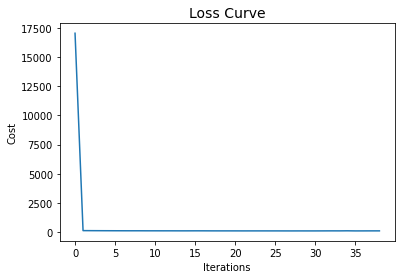

In [ ]:
plt.plot(regr.loss_curve_)
plt.title("Loss Curve", fontsize=14)
plt.xlabel('Iterations')
plt.ylabel('Cost')
plt.show()

## Running Grid Search Cross Validation for MLP Regressor

In [ ]:
param_grid = {
    'max_iter': [50, 100, 200],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.0001, 0.05],
    'learning_rate': ['constant','adaptive'],
}

In [ ]:
grid = GridSearchCV(regr, param_grid, cv=5, verbose=2)
grid.fit(X_train, y_train)

Fitting 5 folds for each of 48 candidates, totalling 240 fits
[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=50, solver=sgd; total time=   1.8s
[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=50, solver=sgd; total time=   1.6s
[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=50, solver=sgd; total time=   1.4s
[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=50, solver=sgd; total time=   1.4s
[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=50, solver=sgd; total time=   1.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=50, solver=adam; total time=   6.1s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=50, solver=adam; total time=   6.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=50, solver=adam; total time=   6.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=50, solver=adam; total time=   6.1s
[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=50, solver=adam; total time=   4.9s
[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.7s
[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.6s
[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.3s
[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.4s
[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.4s
[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=100, solver=adam; total time=  10.3s
[CV] END activation=tanh, alpha=0.0001, learning_rate=constant, max_iter=100, solver=adam; total time=   8.2s
[CV] END activati

/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=adam; total time=   6.1s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=adam; total time=   6.1s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=adam; total time=   6.1s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=adam; total time=   6.1s
[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=adam; total time=   4.9s
[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=sgd; total time=  14.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=sgd; total time=  33.7s
[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=sgd; total time=  25.6s
[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=sgd; total time=  24.1s
[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=sgd; total time=  16.0s
[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=adam; total time=  22.3s
[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=adam; total time=   8.3s
[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=adam; total time=   7.6s
[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=adam; total time=   6.5s
[CV] END activation=tanh, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=adam; total time=   4.9s
[CV] END activ

/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.05, learning_rate=constant, max_iter=50, solver=adam; total time=   6.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.05, learning_rate=constant, max_iter=50, solver=adam; total time=   6.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.05, learning_rate=constant, max_iter=50, solver=adam; total time=   6.3s
[CV] END activation=tanh, alpha=0.05, learning_rate=constant, max_iter=50, solver=adam; total time=   6.2s
[CV] END activation=tanh, alpha=0.05, learning_rate=constant, max_iter=100, solver=sgd; total time=   2.1s
[CV] END activation=tanh, alpha=0.05, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.8s
[CV] END activation=tanh, alpha=0.05, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.4s
[CV] END activation=tanh, alpha=0.05, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.3s
[CV] END activation=tanh, alpha=0.05, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.4s
[CV] END activation=tanh, alpha=0.05, learning_rate=constant, max_iter=100, solver=adam; total time=   6.2s
[CV] END activation=tanh, alpha=0.05, learning_rate=constant, max_iter=100, solver=adam; total time=   8.6s
[CV] END activation=tanh, alpha=0.0

/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.1s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.2s
[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=adam; total time=   6.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=adam; total time=   6.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=adam; total time=   6.1s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=adam; total time=   6.3s
[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=adam; total time=   7.4s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=sgd; total time=  10.3s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=sgd; total time=  10.4s
[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=sgd; total time=   7.2s
[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=sgd; total time=   7.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=sgd; total time=  10.4s
[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=adam; total time=   6.3s
[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=adam; total time=   8.7s
[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=adam; total time=   7.4s
[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=adam; total time=   7.2s
[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=adam; total time=   6.2s
[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=200, solver=sgd; total time=  13.0s
[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=200, solver=sgd; total time=  13.1s
[CV] END activation=tanh, alpha=0.05, learning_rate=adaptive, max_iter=200, solver=sgd; total time=   7.0s
[CV] END activation=tanh, alpha=

/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_base.py:174: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:153: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", li

[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=50, solver=sgd; total time=   5.0s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=50, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=50, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=50, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=50, solver=sgd; total time=   1.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=50, solver=adam; total time=   5.7s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=50, solver=adam; total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=50, solver=adam; total time=   5.6s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=50, solver=adam; total time=   5.7s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_base.py:174: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:153: RuntimeWarning: overflow encountered in matmul
  ret = a @ b


[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=50, solver=adam; total time=   5.6s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 706, in score
    return r2_score(y, y_pred, sample_weight=sample_weight)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_regression.py"

[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=100, solver=sgd; total time=   9.8s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=100, solver=adam; total time=   5.8s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=100, solver=adam; total time=   4.9s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=100, solver=adam; total time=   6.5s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=100, solver=adam; total time=   6.3s
[CV] END activa

/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_base.py:174: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:153: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", l

[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=200, solver=sgd; total time=  19.8s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=200, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=200, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=200, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=200, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=200, solver=adam; total time=   5.9s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=200, solver=adam; total time=   4.8s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=200, solver=adam; total time=   6.4s
[CV] END activation=relu, alpha=0.0001, learning_rate=constant, max_iter=200, solver=adam; total time=   6.4s
[CV] END activa

/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_base.py:174: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:153: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", li

[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=adam; total time=   5.7s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=adam; total time=   4.8s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=adam; total time=   5.7s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=adam; total time=   5.7s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_base.py:174: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:153: RuntimeWarning: overflow encountered in matmul
  ret = a @ b


[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=50, solver=adam; total time=   5.7s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 706, in score
    return r2_score(y, y_pred, sample_weight=sample_weight)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_regression.py"

[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=sgd; total time=  10.0s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=sgd; total time=   6.6s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=sgd; total time=   6.6s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=sgd; total time=   6.6s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=sgd; total time=   6.6s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=adam; total time=   5.9s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=adam; total time=   4.9s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=adam; total time=   6.4s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=100, solver=adam; total time=   6.3s
[CV] END activa

/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_base.py:174: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:153: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", l

[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=200, solver=sgd; total time=  19.9s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=200, solver=sgd; total time=   6.5s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=200, solver=sgd; total time=   6.6s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=200, solver=sgd; total time=   6.6s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=200, solver=sgd; total time=   6.6s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=200, solver=adam; total time=   6.1s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=200, solver=adam; total time=   4.8s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=200, solver=adam; total time=   6.5s
[CV] END activation=relu, alpha=0.0001, learning_rate=adaptive, max_iter=200, solver=adam; total time=   6.3s
[CV] END activa

/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_base.py:174: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:153: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", li

[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=50, solver=sgd; total time=   5.0s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=50, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=50, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=50, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=50, solver=sgd; total time=   1.2s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=50, solver=adam; total time=   5.6s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=50, solver=adam; total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=50, solver=adam; total time=   5.6s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=50, solver=adam; total time=   5.7s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_base.py:174: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:153: RuntimeWarning: overflow encountered in matmul
  ret = a @ b


[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=50, solver=adam; total time=   5.7s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 706, in score
    return r2_score(y, y_pred, sample_weight=sample_weight)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_regression.py"

[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=100, solver=sgd; total time=   9.9s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=100, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=100, solver=adam; total time=   5.8s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=100, solver=adam; total time=   4.9s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=100, solver=adam; total time=   6.4s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=100, solver=adam; total time=   6.2s
[CV] END activation=relu, alpha=0

/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_base.py:174: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:153: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", l

[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=200, solver=sgd; total time=  19.8s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=200, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=200, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=200, solver=sgd; total time=   1.2s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=200, solver=sgd; total time=   1.3s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=200, solver=adam; total time=   5.8s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=200, solver=adam; total time=   4.9s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=200, solver=adam; total time=   6.4s
[CV] END activation=relu, alpha=0.05, learning_rate=constant, max_iter=200, solver=adam; total time=   6.2s
[CV] END activation=relu, alpha=0

/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_base.py:174: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:153: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", li

[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=sgd; total time=   5.0s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=adam; total time=   5.7s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=adam; total time=   4.9s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=adam; total time=   5.7s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=adam; total time=   5.7s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_base.py:174: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:153: RuntimeWarning: overflow encountered in matmul
  ret = a @ b


[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=50, solver=adam; total time=   5.7s


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", line 418, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 706, in score
    return r2_score(y, y_pred, sample_weight=sample_weight)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_regression.py"

[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=sgd; total time=   9.9s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=sgd; total time=   6.7s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=sgd; total time=   6.6s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=sgd; total time=   6.7s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=sgd; total time=   6.5s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=adam; total time=   6.0s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=adam; total time=   4.8s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=adam; total time=   6.4s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=100, solver=adam; total time=   6.3s
[CV] END activation=relu, alpha=0

/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_base.py:174: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:153: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:774: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 761, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_scorer.py", l

[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=200, solver=sgd; total time=  19.7s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=200, solver=sgd; total time=   6.6s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=200, solver=sgd; total time=   6.6s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=200, solver=sgd; total time=   6.6s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=200, solver=sgd; total time=   6.5s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=200, solver=adam; total time=   5.9s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=200, solver=adam; total time=   4.9s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=200, solver=adam; total time=   6.4s
[CV] END activation=relu, alpha=0.05, learning_rate=adaptive, max_iter=200, solver=adam; total time=   6.3s
[CV] END activation=relu, alpha=0

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_search.py:972: UserWarning: One or more of the test scores are non-finite: [-4.05257031e-03  6.01476889e-01 -4.05257031e-03  6.02030830e-01
 -4.05257031e-03  6.02030830e-01  3.88198804e-04  6.01476889e-01
  3.05627563e-04  6.02030830e-01  3.09118303e-04  6.02030830e-01
 -5.68772362e-03  6.00877593e-01 -5.68772362e-03  6.02510184e-01
 -5.68772362e-03  6.02510184e-01  2.60562470e-04  6.00877593e-01
  7.41316825e-04  6.02510184e-01  7.46307186e-04  6.02510184e-01
             nan  5.62391471e-01             nan  5.98078744e-01
             nan  5.98078744e-01             nan  5.62391471e-01
             nan  5.98078744e-01             nan  5.98078744e-01
             nan  5.69742329e-01             nan  6.00659184e-01
             nan  6.00659184e-01             nan  5.69742329e-01
             nan  6.00659184e-01             nan  6.00659184e-01]
  category=UserWarning,


GridSearchCV(cv=5, estimator=MLPRegressor(random_state=1),
             param_grid={'activation': ['tanh', 'relu'],
                         'alpha': [0.0001, 0.05],
                         'learning_rate': ['constant', 'adaptive'],
                         'max_iter': [50, 100, 200],
                         'solver': ['sgd', 'adam']},
             verbose=2)

In [ ]:
grid.best_estimator_

MLPRegressor(activation='tanh', alpha=0.05, max_iter=100, random_state=1)

In [ ]:
mlp_optimal_model = grid.best_estimator_

In [ ]:
mlp_optimal_model = MLPRegressor(random_state=1, max_iter=100, alpha=0.05, activation= 'tanh').fit(X_train, y_train)

In [ ]:
# Making predictions on train and test data
y_pred_train_r_g = mlp_optimal_model.predict(X_train)
y_pred_test_r_g = mlp_optimal_model.predict(X_test)

In [ ]:
# for train data set
print("Model Score:",mlp_optimal_model.score(X_train,y_train))
MSE= mean_squared_error(y_train, y_pred_train_r_g)
print("MSE :",MSE)

RMSE=np.sqrt(MSE)
print("RMSE :",RMSE)

r2= r2_score(y_train, y_pred_train_r_g)
print("R2 :",r2)
print("Adjusted R2 :",1-(1-r2_score(y_train, y_pred_train_r_g))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

Model Score: 0.5957252761585441
MSE : 254.8446935077941
RMSE : 15.96385584712522
R2 : 0.5957252761585441
Adjusted R2 : 0.5940337501173665


In [ ]:
# for test data set
print("Model Score:",mlp_optimal_model.score(X_train,y_train))
MSE= mean_squared_error(y_test, y_pred_test_r_g)
print("MSE :",MSE)

RMSE=np.sqrt(MSE)
print("RMSE :",RMSE)

r2= r2_score((y_test), (y_pred_test_r_g))
print("R2 :",r2)
print("Adjusted R2 :",1-(1-r2_score((y_test), (y_pred_test_r_g)))*((X_test.shape[0]-1)/(X_test.shape[0]-X_test.shape[1]-1)) )

Model Score: 0.5957252761585441
MSE : 247.76350811259908
RMSE : 15.740505332186736
R2 : 0.6020418663417415
Adjusted R2 : 0.6003767695481923
